In [346]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import cmath
from tabulate import tabulate
from numpy.random import normal
from numpy import random
# Scikit Imports
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.metrics import mean_squared_error as mse

# import pandas as pd
import math
import time

from qutip import expect , Qobj
import qutip
import math
from qutip import Qobj,basis
from qutip import sigmax , sigmaz , sigmay
from qutip import tensor
# from QuAwesome import DataManager
import json

{'a': 0}

# Data function

In [13]:
def shift(target):
  _min = np.min(target)
  return [t-_min for t in target]
def _filter(target , filter) :
  r = []
  rid = []
  rest = []
  for idx , t in enumerate(target) :
    if t > filter :
      r.append(t)
      rid.append(idx)
    else :
      rest.append(t)
  return r ,rid , rest
def indexing(target , index) :
  return [target[idx] for idx in index]
def _plot(x,y , filter,color = [] , name = ""):
  px = []
  py = []
  for _x , _y in zip(x,y) :
    if abs(_y) < filter :
      px.append(_x)
      py.append(_y)
  if color == [] :
    plt.scatter( px, py)
  else :
    plt.scatter(px ,py , c =color)
  plt.plot(np.linspace(0,0.1) , np.linspace(0,0.1))
  if name != "" :
    plt.savefig(name)
  plt.show()
def _plot_p(x,y , filter,color = [] , name = ""):
  px = []
  py = []
  for _x , _y in zip(x,y) :
    if abs(_y) < filter :
      px.append(_x)
      py.append(abs(_y))
  if color == [] :
    plt.scatter( px, py)
  else :
    plt.scatter(px ,py , c =color)
  plt.plot(np.linspace(0,0.1) , np.linspace(0,0.1))
  if name != "" :
    plt.savefig(name)
  plt.show()

In [14]:
def tune(target ,x_train , y_train,kernel_method) :
  param_grid =[{'kernel':kernel_method,
      'epsilon':np.arange(0,1,0.001),
             'C':np.arange(0.1,1,0.1)}]
  # 初始化网格搜索的方法
  rd_search = RandomizedSearchCV(target ,param_grid,n_jobs=8)
  rd_search.fit(x_train, y_train)
  return rd_search.best_params_
def _tune(target ,x_train,y_train,x_test , y_test ,kernel_method , tg = 'ts'):
  param_grid =[{'kernel':kernel_method,
    'epsilon':np.arange(0,0.1,0.001),
            'C':np.arange(0.1,1,0.1)}]
  best = 9999
  best_dict = {'kernel': kernel_method[0]}
  for ep in (param_grid[0]['epsilon']):
    for c in param_grid[0]['C']:
      _svr = SVR(kernel = kernel_method[0] , epsilon = ep , C=c)
      _svr.fit(x_train , y_train)
      if tg == 'ts':
        _rs = _svr.predict(x_test)
        _sc = mse(_rs , y_test)
      else :
        _rs = _svr.predict(x_train)
        _sc = mse(_rs , y_train)
      if _sc < best :
        best = _sc
        best_dict['epsilon'] = ep
        best_dict['C'] = c
  print(param_grid[0]['C'])
  return best_dict

# Qmapping

In [207]:
sigx = sigmax()
sigz = sigmaz()
sigy = sigmay()
iid = qutip.qeye(2)
rr = Qobj([[0,0],[0,1]])
ee = Qobj([[1,0],[0,0]])
cnot=tensor(ee, iid)+ tensor(rr, sigx)

def Rz(theta):
    return Qobj([[1,0],[0,cmath.exp(1j*theta)]])

def gst(d):
  b = [basis(2,0) for i in range(d)]
  return tensor(b)
    
def form_op(tg,operator , d) :
    r = iid
    if 0 in tg :
        r = operator
    for i in range(1,d):
        if i in tg :
            r = tensor(r , operator)
        else :
            r = tensor(r , iid)
    return r
def dynamics(d,error=None):
    # if error:
    #     er=normal(loc=1.0, scale=error[1], size=1)
    #     h = form_op([0] , sigx , d)
    #     for i in range(1,d) :
    #         h += form_op([i],sigx ,d)
        
    # else:
    
    h = form_op([0] , sigx , d)
    for i in range(1,d) :
        h += form_op([i],sigx ,d)
    return h

def Hadama(d):
  h = 1/(2)**0.5*form_op([0] , Qobj([[1,1],[1,-1]]) , d)
  for i in range(1,d) :
    h = 1/(2)**0.5*form_op([i],Qobj([[1,1],[1,-1]]) ,d) *h
  return h

def EncodingP(d,data,op):
  if op=="z":
    h =  ee * cmath.exp(-1j*data[0]) + rr * cmath.exp(1j*data[0])
    for i in range(1,d) :
      h = tensor(h, ee * cmath.exp(-1j*data[i]) + rr * cmath.exp(1j*data[i]))
    return h
  elif op=="x":
    h = iid * math.cos(data[0]) - sigx * 1j*math.sin(data[0])
    for i in range(1,d) :
      h = tensor(h,iid * math.cos(data[i]) - sigx *1j* math.sin(data[i]))
    return h

def Entangle(config , d, error=None):
    for idx ,x in enumerate(config) :
        for idy ,y in enumerate(x[idx::],start=idx) :
            if error:
                e0=normal(loc=0.0, scale=error[0], size=1)
                e2=normal(loc=0.0, scale=error[2], size=1)
            else:
                e0, e2= 0, 0

            if idx != idy:
                r = (CC /y*2*4*np.pi)**(1/6)
                r+=e2
                y=(CC/r**6)/(2*4*np.pi)
                
            if idx==idy:  
                try :
                    h += y * form_op([idx , idy] , rr ,d)
                except :
                    h  = y * form_op([idx , idy] , rr ,d)
            else:
                h +=  (y+e0) * form_op([idx , idy] , rr ,d)
    return h

def CnotGate(d):
  d-=1
  h = form_op([0] , cnot , d)
  for i in range(1,d) :
    h = form_op([i],cnot ,d) * h
  return h

def ZZGate(config,d):
  d-=1
  h = form_op([0] , cnot*tensor(iid,Rz(config[0]))*cnot , d)
  for i in range(1,d) :
    h = form_op([i],cnot*tensor(iid,Rz(config[i]))*cnot ,d) * h
  return h

def HMap(config , d, Ruby, error=None) :
  return Ruby*dynamics(d) + Entangle(config , d, error)

def evolution(H,t) :
  return (-1j * H * t).expm()
    
def k_value(left , right) :
  # print(left.dag() * right)
  k = (left.dag() * right)
  return (k * k.conjugate()).real

In [525]:
CXH = tensor((iid - sigz) , (iid - sigx))
(-np.pi * 0.25 *  1j *CXH).expm()
def CXHE(d):
    d-=1
    ll=[]
    h = form_op([0] , CXH , d)
    ll.append(h)
    for i in range(1,d) :
        h = form_op([i],CXH ,d) 
        ll.append(h)
    return ll
def noisy_cnot(ll):
    AAA=[]
    for i in ll:
        AAA.append((i * normal(np.pi * 0.25 , 0.065) * -1j).expm())
    return AAA
(-np.pi * 0.25 *  1j *CXH).expm()

Quantum object: dims=[[2, 2], [2, 2]], shape=(4, 4), type='oper', dtype=Dense, isherm=True
Qobj data =
[[1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 5.57335903e-17 1.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00 1.23523980e-16]]

In [526]:
def EvCnot(AAA,state):
    for i in AAA:
        state = i*state
    return state

In [527]:
def Qmap(config , d,t,Data ,Ruby,op, tier,mode="quera",error=None):
    rs = []
    if mode == "ZZ":
        d+=1
    right_gst = gst(d)

    if error:
        if mode == "quera":
            dy=Ruby*dynamics(d)
            
            if tier ==0:
                for da in Data:
                    e1=normal(loc=1.0, scale=error[1], size=1)
                    h = e1*dy +Entangle(config , d, error)
                    ev=evolution(h,t)
                    EP=EncodingP(d,da,op)
                    state= ev * right_gst
                    state= EP * state
                    rs.append(state)
            else:
                for da in Data:
                    e1=normal(loc=1.0, scale=error[1], size=1)
                    h = e1*dy +Entangle(config , d, error)
                    ev=evolution(h,t)
                    EP=EncodingP(d,da,op)
                    state= EP * right_gst
                    for i in range(tier):
                        state= ev * state
                        state= EP * state
                    rs.append(state)
        if mode == "cnot":
            
            lll=CXHE(d)
            
            if tier ==0:
                for da in Data:
                    EP=EncodingP(d,da,op)
                    Noise = noisy_cnot(lll)
                    state= EvCnot(Noise,right_gst)
                    state= EP * state
                    rs.append(state)
            else:
                for da in Data:
                    EP=EncodingP(d,da,op)
                    state= EP * right_gst
                    for i in range(tier):
                        Noise = noisy_cnot(lll)
                        state= EvCnot(Noise,right_gst)
                        state= EP * state
                    rs.append(state) 
            
            
            
    else:
        if mode == "quera":
            h = HMap(config ,d ,Ruby)
            ev=evolution(h,t)
        elif mode == "cnot":
            ev = CnotGate(d)
        if mode == "ZZ":
            Ha=Hadama(d)
            for da in Data:
              EP=ZZGate(da,d)*Ha
              state= EP * right_gst
              for i in range(tier):
                state= EP * state
              rs.append(state)
        else:
            if tier ==0:
                for da in Data:
                  EP=EncodingP(d,da,op)
                  state= ev * right_gst
                  state= EP * state
                  rs.append(state)
            else:
                for da in Data:
                  EP=EncodingP(d,da,op)
                  state= EP * right_gst
                  for i in range(tier):
                    state= ev * state
                    state= EP * state
                  rs.append(state)
    return rs
    
def get_q_kernel(state1 , state2 , status = "train" ):
  k_matrix = []
  for i ,s in enumerate(state1) :
    _k = []
    for j  , st in enumerate(state2) :
      if i >= j or status == "test":
        _k.append(k_value(s,st))
      else :
        _k.append(0)
    k_matrix.append(_k)
  if status == "train" :
    for idy , km in enumerate(k_matrix) :
      for idx , k in enumerate(km) :
          if k == 0 :
              k_matrix[idy][idx] = k_matrix[idx][idy]
  return np.array(k_matrix)

In [528]:
# kernel transformation, visualization
def diagnal(target , diag):
  for k in range(0,len(target)) :
    target[k][k] = diag
  return target
def rescale(target):
  _min = np.min(target)
  _max = np.max(target)
  delta  = _max - _min
  for i in range(0,len(target)) :
    for j in range(0,len(target[0])) :
      target[i][j] = (target[i][j] - _min) / delta
  return target
def show_kmatrix(test=[], train = [],name = ""):
  fig, axs = plt.subplots(1, 2, figsize=(10, 5))
  # if test != [] :
  a1=axs[0].imshow(np.asmatrix(test),
                interpolation='nearest', origin='upper', cmap='Blues')
  plt.colorbar(a1)
  axs[0].set_title("testing kernel matrix")
  # if train != [] :
  a2=axs[1].imshow(np.asmatrix(train),
                interpolation='nearest', origin='upper', cmap='Blues')
  plt.colorbar(a2)
  axs[1].set_title("training kernel matrix")
  if name == "" :
    plt.show()
  else :
    plt.savefig(name)

# Data MNIST

In [470]:
from scipy.io import loadmat
import random

start=1000
train_num=1000+start
test_num=300
mnist = loadmat('./mnist.mat') # change the file path according to the path where you put mnist.mat on your Google Drive.

# index=[i for i in range(len(mnist['traindata'][:10000]))]
# random.shuffle(index)
# mnist['traindata'][:10000]=mnist['traindata'][index]
# mnist['trainlabels'][:10000]=mnist['trainlabels'][index]

traindata = mnist['traindata'][start:train_num]
trainlabels = mnist['trainlabels'].ravel()[start:train_num]
testdata = mnist['traindata'][train_num:train_num+test_num]
testlabels = mnist['trainlabels'].ravel()[train_num:train_num+test_num]


print(traindata.shape)
print(trainlabels.shape)
print(testdata.shape)
print(testlabels.shape)


(1000, 784)
(1000,)
(300, 784)
(300,)


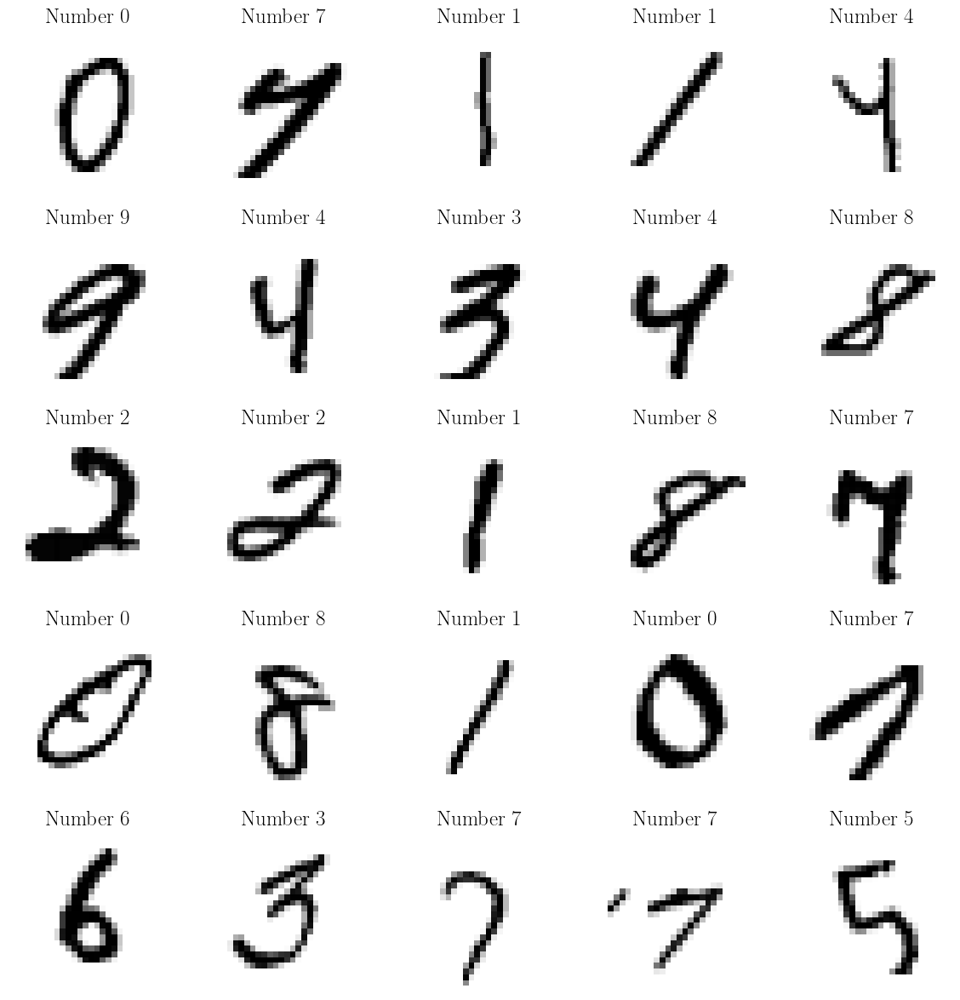

In [471]:
fig, axs = plt.subplots(5, 5, figsize = (12, 12))
plt.gray()

# loop through subplots and add mnist images
for i, ax in enumerate(axs.flat):
  ax.imshow(traindata[i].reshape((28, 28)), cmap=cm.gray_r)
  ax.axis('off')
  ax.set_title('Number {}'.format(trainlabels[i]))

In [472]:
from numpy import linalg as LA
from sklearn.preprocessing import StandardScaler


#step1
scaler = StandardScaler()
train = scaler.fit_transform(traindata)
test = scaler.fit_transform(testdata)

#step2
cov_train = np.cov(train.T)

#step3
eig_vals, eig_vecs = LA.eig(cov_train)

#step4
sort_indices = np.argsort(eig_vals)[::-1]
eig_vals = eig_vals[sort_indices]
eig_vecs = eig_vecs[:, sort_indices]

#step5
k = 10 ## The number of features after PCA
eig_vec = eig_vecs[:, :k]


#step6
train_pca = np.real(np.dot(train, eig_vec))
test_pca = np.real(np.dot(test, eig_vec))

In [473]:
imax=0
imin=0
for ll in train_pca:
    imax=np.max([imax,np.max(ll)])
    imin=np.min([imin,np.min(ll)])
print("imax=",imax)
print("imin=",imin)

imax= 64.57529802812086
imin= -28.451437234851344


In [410]:
f_scale =[]
f_min =[]
x_train_lst = train_pca
x_test_lst = test_pca
Norm=1
for i in range(0 ,len(x_train_lst[0])) :
  tg = [x[i] for x in x_train_lst]
  f_scale.append(np.max(tg) - np.min(tg))
  f_min.append(np.min(tg))
trs_tr = []
for x in x_train_lst :
  rs = []
  for i , scale , min in zip(x ,f_scale , f_min) :
    rs.append((i-min)/scale*Norm)
  trs_tr.append(rs)
trs_t = []
for x in x_test_lst :
  rs = []
  for i , scale , min in zip(x ,f_scale , f_min) :
    rs.append((i-min)/scale*Norm)
  trs_t.append(rs)

train_pca = trs_tr
test_pca = trs_t
train_pca_q=trs_tr
test_pca_q=trs_t

train_pca=np.array(train_pca)
test_pca=np.array(x_test_lst)

## Construct kernal

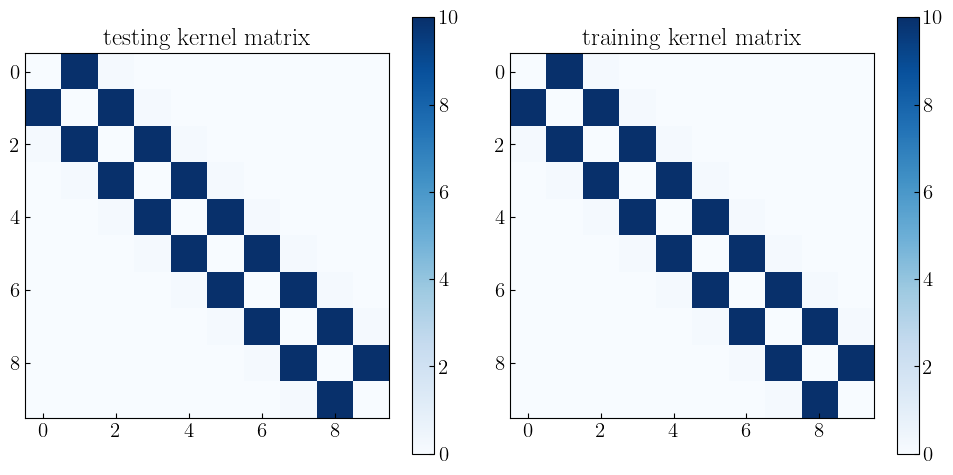

In [381]:
dim = 10
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1
V=10
config = np.ones([dim ,dim])*V
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

In [ ]:
# from tqdm.notebook import trange, tqdm
op ="x"
tier=1
mode="quera"
error=[0.005,0.01,0.1]
start_time = time.time()
qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op,tier, mode,error=error)
qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op,tier, mode,error=error)
end=time.time()-start_time

In [ ]:
print(end)

In [ ]:
target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)

In [ ]:
test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")

In [ ]:
target_kernel[0][0],target_kernel[1][1]

In [ ]:
show_kmatrix(train = target_kernel , test = test_kernel,name = "")

In [388]:
from sklearn.svm import SVC

clf = SVC(kernel="linear",C=10.0)
clf.fit(train_pca, trainlabels)

SVC(C=10.0, kernel='linear')

In [389]:
y_pred = clf.predict(test_pca)
accuracy = np.mean(y_pred == testlabels)
print("Accuracy:", accuracy)

Accuracy: 0.7933333333333333


In [390]:
clf = SVC(kernel="rbf",C=1.0)
clf.fit(train_pca, trainlabels)
y_pred = clf.predict(test_pca)
accuracy = np.mean(y_pred == testlabels)
print("Accuracy:", accuracy)

Accuracy: 0.8


In [391]:
C_list = [0.1, 0.5, 1.0, 5.0, 10.0]
for c in C_list:
  clf = SVC(kernel="rbf",C=c)
  clf.fit(train_pca, trainlabels)
  y_pred = clf.predict(test_pca)
  accuracy = np.mean(y_pred == testlabels)
  print("C={},Accuracy:{}".format(c,accuracy))
  print("\n")
#C represents the penalty coefficient for misclassification,A larger value of C will make the model strictly classify all samples correctly.
#C=10 give me the best accurarcy

C=0.1,Accuracy:0.72


C=0.5,Accuracy:0.7766666666666666


C=1.0,Accuracy:0.8


C=5.0,Accuracy:0.8166666666666667


C=10.0,Accuracy:0.8233333333333334




In [549]:
clf = SVC(kernel="precomputed",C=5.0)
clf.fit(target_kernel, trainlabels)

SVC(C=5.0, kernel='precomputed')

In [550]:
y_pred = clf.predict(test_kernel)
accuracy = np.mean(y_pred == testlabels)
print("Accuracy:", accuracy)

Accuracy: 0.8066666666666666


## Quera X

### V=10

imax= 64.57529802812086
imin= -28.451437234851344


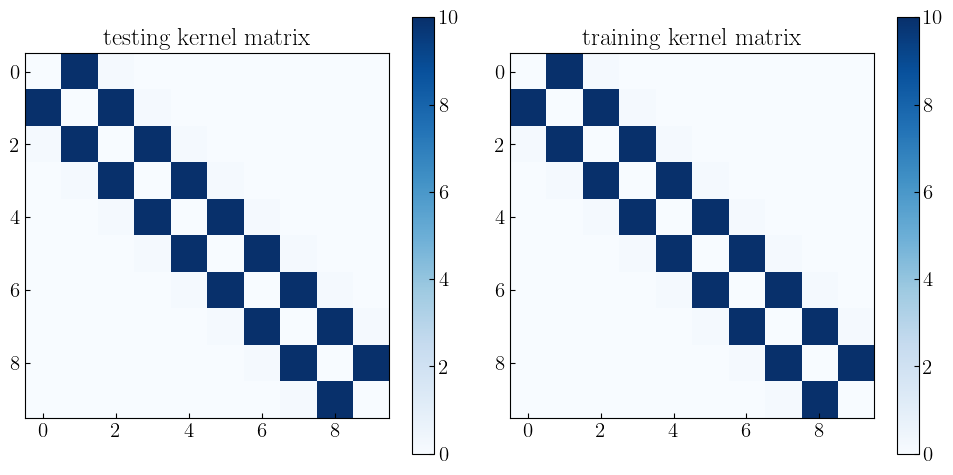

1
cost time: 20.952744722366333 
2
cost time: 30.304511308670044 
3
cost time: 34.888827323913574 
2
cost time: 23.48243737220764 
4
cost time: 29.911458492279053 
6
cost time: 35.072041273117065 
3
cost time: 21.929121017456055 
6
cost time: 28.601898193359375 
9
cost time: 32.618587493896484 
+-----------+----------+----------+----------+-------+
| sigmax    |   tier=0 |   tier=1 |   tier=2 |   rbf |
+===========+==========+==========+==========+=======+
| Norm=05pi | 0.83     | 0.856667 | 0.84     |  0.82 |
+-----------+----------+----------+----------+-------+
| Norm=pi   | 0.856667 | 0.833333 | 0.793333 |  0.82 |
+-----------+----------+----------+----------+-------+
| Norm=2pi  | 0.833333 | 0.726667 | 0.51     |  0.82 |
+-----------+----------+----------+----------+-------+


In [469]:
from tabulate import tabulate

V=10
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

for ll in train_pca:
    imax=np.max([imax,np.max(ll)])
    imin=np.min([imin,np.min(ll)])
print("imax=",imax)
print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


for (i,Norm) in enumerate(Normlist):

    train_pca_q=[]
    test_pca_q=[]
    for j,ll in enumerate(train_pca):
        train_pca_q.append(train_pca[j]/max(imax,abs(imin))*Norm)
    
    for j,ll in enumerate(test_pca):
        test_pca_q.append(test_pca[j]/max(imax,abs(imin))*Norm)


    for tier in range(3):

        
        start_time = time.time()
        qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error=None)
        qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error=None)
        end=time.time()-start_time
        target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
        test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
        
        clf = SVC(kernel="precomputed",C=10.0)
        clf.fit(target_kernel, trainlabels)
        y_pred = clf.predict(test_kernel)
        accuracy = np.mean(y_pred == testlabels)
        data[i].append(accuracy)

        print((i+1)*(tier+1))
        print(f"cost time: {end} ")
    clf = SVC(kernel="rbf",C=1.0)
    clf.fit(train_pca, trainlabels)
    y_pred = clf.predict(test_pca)
    accuracy = np.mean(y_pred == testlabels)
    data[i].append(accuracy)

table1 = tabulate(data, headers, tablefmt="grid")

print(table1)


imax= 64.57529802812086
imin= -28.451437234851344


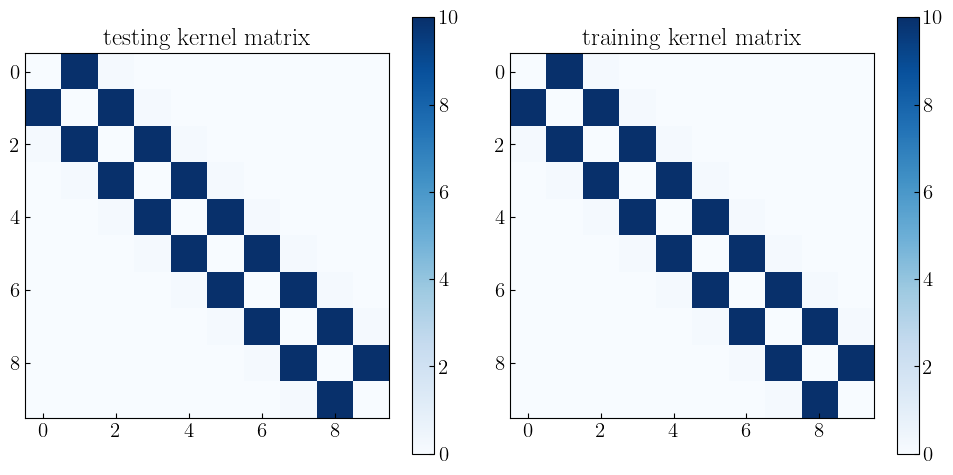

1
cost time: 23.86835551261902 
2
cost time: 21.83480215072632 
3
cost time: 27.54624342918396 
1
cost time: 22.21920371055603 
2
cost time: 27.18513512611389 
3
cost time: 32.56420302391052 
2
cost time: 21.852800607681274 
4
cost time: 27.63667058944702 
6
cost time: 31.97313165664673 
2
cost time: 18.046903133392334 
4
cost time: 27.05906391143799 
6
cost time: 35.073970794677734 


In [480]:
from tabulate import tabulate

V=10
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi",[],[],[]],["Norm=pi",[],[],[]]]
data_test = [["Norm=05pi",[],[],[]],["Norm=pi",[],[],[]]]
mode="quera"
Normlist=[math.pi/2,math.pi]
imax=0
imin=0

for ll in train_pca:
    imax=np.max([imax,np.max(ll)])
    imin=np.min([imin,np.min(ll)])
print("imax=",imax)
print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

error=[0.005,0.01,0.1]

for (i,Norm) in enumerate(Normlist):

    train_pca_q=[]
    test_pca_q=[]
    for j,ll in enumerate(train_pca):
        train_pca_q.append(train_pca[j]/max(imax,abs(imin))*Norm)
    
    for j,ll in enumerate(test_pca):
        test_pca_q.append(test_pca[j]/max(imax,abs(imin))*Norm)



    for _ in range(5):
        for tier in range(3):
    
            start_time = time.time()
            qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error=error)
            qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error=error)
            end=time.time()-start_time
            target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
            test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
            
            clf = SVC(kernel="precomputed",C=10.0)
            clf.fit(target_kernel, trainlabels)
            y_pred = clf.predict(test_kernel)
            accuracy = np.mean(y_pred == testlabels)
            data[i][tier+1].append(accuracy)
    
            print((i+1)*(tier+1))
            print(f"cost time: {end} ")


# table1 = tabulate(data, headers, tablefmt="grid")
# table2 = tabulate(data_test, headers, tablefmt="grid")

# print(table1)
# print(table2)

In [481]:
tt_list=["tier0","tier1","tier2"]
store = {}
store['V10'] = {}
store['V10']['test']={}
for i in data:
    store['V10']['test'][i[0]]={}
    for (count,j) in enumerate(i[1::]):
        print(count)
        store['V10']['test'][i[0]][tt_list[count]]=j

f = open('MNIST_error.json' , "w+")
json.dump(store , f)
f.close()

f = open('MNIST_error.json' , "r")
rs = json.load(f)
f.close()
rs

0
1
2
0
1
2


{'V10': {'test': {'Norm=05pi': {'tier0': [0.83, 0.83],
    'tier1': [0.8566666666666667, 0.8566666666666667],
    'tier2': [0.84, 0.84]},
   'Norm=pi': {'tier0': [0.8566666666666667, 0.8566666666666667],
    'tier1': [0.8333333333333334, 0.8333333333333334],
    'tier2': [0.7933333333333333, 0.7933333333333333]}}}}

# Non-Markovian

In [531]:
with open('standard_quantum.json', 'r') as f:
  tg = json.load(f)
x_train_lst = tg['train']['data']
x_test_lst = tg['test']['data']
y_train = tg['train']['label']
y_test = tg['test']['label']

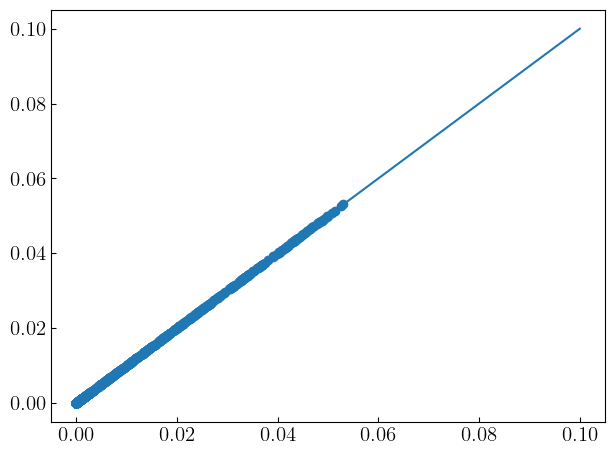

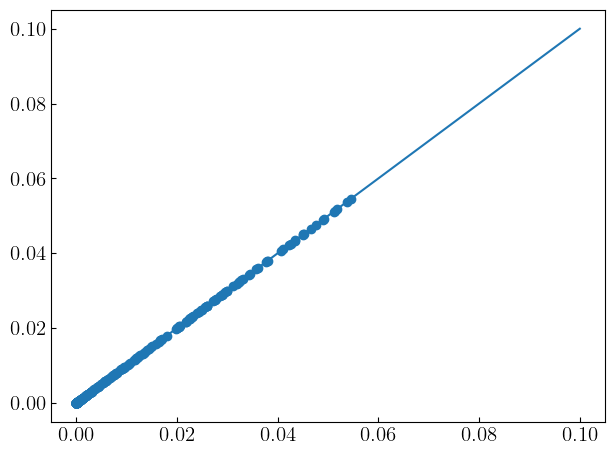

(None, None)

In [532]:
_plot(y_train,y_train,99) , _plot(y_test,y_test,99)

In [539]:
from numpy import linalg as LA
from sklearn.preprocessing import StandardScaler
#step1
scaler = StandardScaler()
train = scaler.fit_transform(x_train_lst)
test = scaler.fit_transform(x_test_lst)

#step2
cov_train = np.cov(train.T)

#step3
eig_vals, eig_vecs = LA.eig(cov_train)

#step4
sort_indices = np.argsort(eig_vals)[::-1]
eig_vals = eig_vals[sort_indices]
eig_vecs = eig_vecs[:, sort_indices]

#step5
k = 10 ## The number of features after PCA
eig_vec = eig_vecs[:, :k]


#step6
x_train_lst = np.real(np.dot(train, eig_vec))
x_test_lst = np.real(np.dot(test, eig_vec))

In [540]:
x_train_lst=np.array(x_train_lst)
x_test_lst=np.array(x_test_lst)

In [543]:
# def scaler(x_train_lst,)

f_scale =[]
f_min =[]

Norm=np.pi
for i in range(0 ,len(x_train_lst[0])) :
  tg = [x[i] for x in x_train_lst]
  f_scale.append(np.max(tg) - np.min(tg))
  f_min.append(np.min(tg))
trs_tr = []
for x in x_train_lst :
  rs = []
  for i , scale , min in zip(x ,f_scale , f_min) :
    rs.append((i-min)/scale*Norm)
  trs_tr.append(rs)
trs_t = []
for x in x_test_lst :
  rs = []
  for i , scale , min in zip(x ,f_scale , f_min) :
    rs.append((i-min)/scale*Norm)
  trs_t.append(rs)

x_train_lst = trs_tr
x_test_lst = trs_t
train_pca_q=trs_tr
test_pca_q=trs_t

x_train_lst=np.array(x_train_lst)
x_test_lst=np.array(x_test_lst)

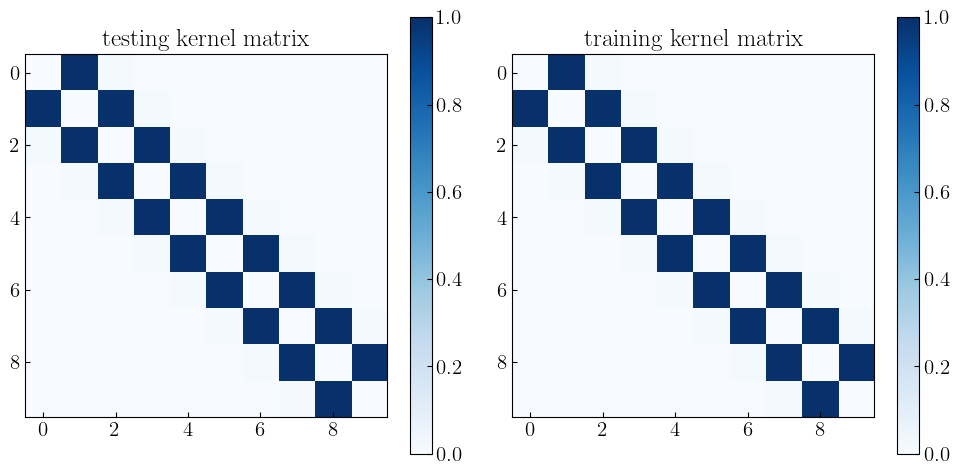

In [544]:
dim = 10
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1
V=1
CC=862690 * 2*np.pi
config = np.ones([dim ,dim])*V
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

In [ ]:
# from tqdm.notebook import trange, tqdm
op ="x"
tier=1
mode="cnot"
error=[0.05,0.05,0.05]
start_time = time.time()
qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op,tier, mode,error)
qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op,tier, mode,error)
end=time.time()-start_time

In [ ]:
target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)

In [ ]:
test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")

In [ ]:
target_kernel[0][0],target_kernel[1][1]

In [ ]:
show_kmatrix(train = target_kernel , test = test_kernel,name = "")

In [122]:
svr = SVR()
argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'ts' )
argv

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]


{'kernel': 'precomputed', 'epsilon': 0.0, 'C': 0.1}

In [123]:
svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
#svr = SVR(kernel = 'precomputed' , epsilon = 0)
svr.fit(target_kernel, y_train)

SVR(C=0.1, epsilon=0.0, kernel='precomputed')

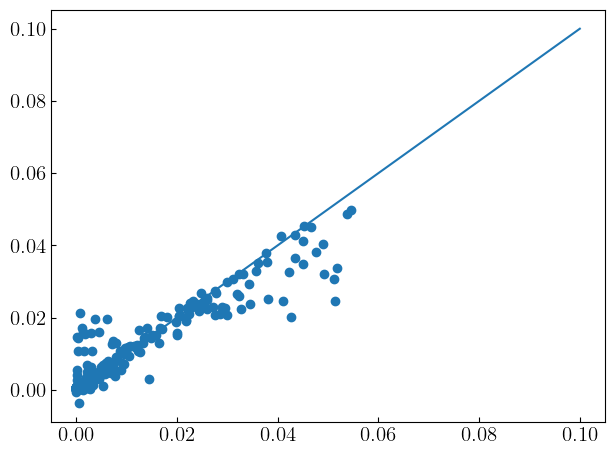

In [124]:
rs_t = svr.predict(test_kernel)
_plot(y_test , rs_t , 99 , name = 'qtest')

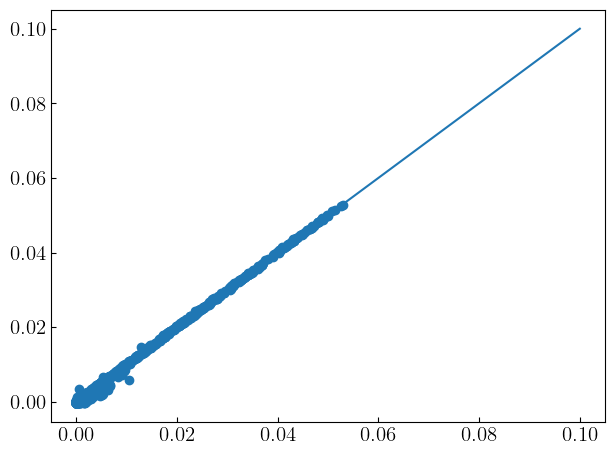

In [125]:
rs = svr.predict(target_kernel)
_plot(y_train , rs ,99 , name = 'qtrain')

In [126]:
import sklearn
x_train_lst=np.array(x_train_lst)
x_test_lst=np.array(x_test_lst)

_k = sklearn.metrics.pairwise.rbf_kernel(x_train_lst,gamma=1/(10*x_train_lst.var()))
_kk = sklearn.metrics.pairwise.rbf_kernel(x_test_lst,x_train_lst,gamma=1/(10*x_train_lst.var()))

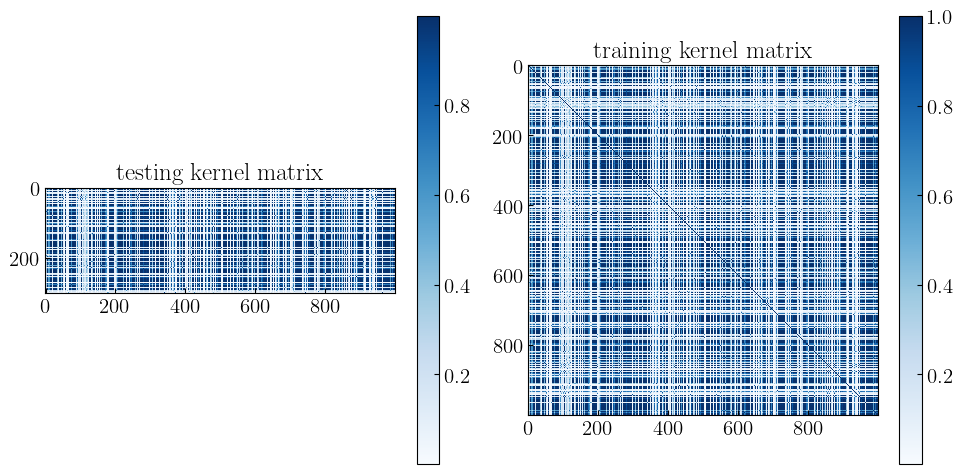

In [127]:
show_kmatrix(test = _kk , train = _k , name = 'ckernel')

In [128]:
mth = 'rbf'

In [129]:
_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , [mth])
argv

{'kernel': 'rbf', 'epsilon': 0.397, 'C': 0.7000000000000001}

In [130]:
_svr = SVR(kernel = mth , epsilon = 0, C=0.9)
_svr.fit(x_train_lst, y_train)

SVR(C=0.9, epsilon=0)

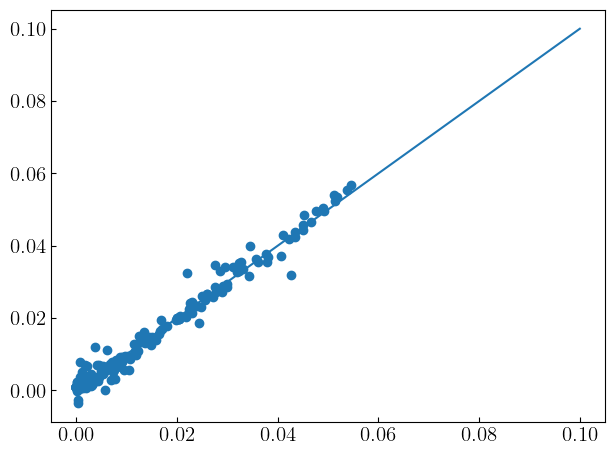

In [131]:
_rs_t = _svr.predict(x_test_lst)
_plot(y_test , _rs_t , 999 , name = 'ctest')

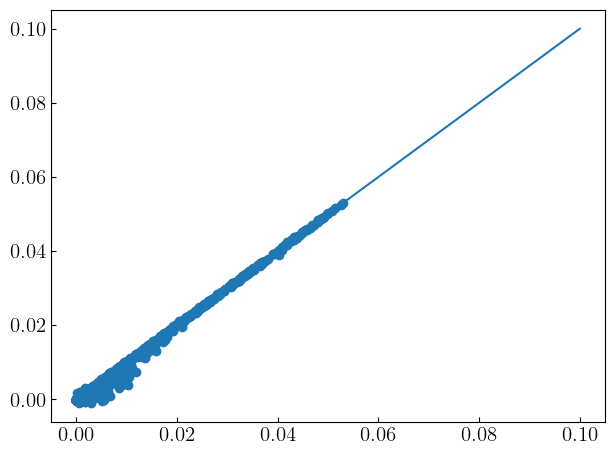

In [132]:
_rs = _svr.predict(x_train_lst)
_plot(y_train , _rs , 999 , name = 'ctrain')

In [133]:
print(f'Classical {mth} testing mse : {mse(_rs_t , y_test)}')
print(f'Quantum testing mse : {mse(rs_t,y_test)}')

Classical rbf testing mse : 3.687892914271448e-06
Quantum testing mse : 2.3286116327741135e-05


In [134]:
print(f'Classical {mth} training mse : {mse(_rs , y_train)}')
print(f'Quantum training mse : {mse(rs,y_train)}')

Classical rbf training mse : 6.975450908371375e-07
Quantum training mse : 2.5642768066609896e-07


# Quera Z

## V=10

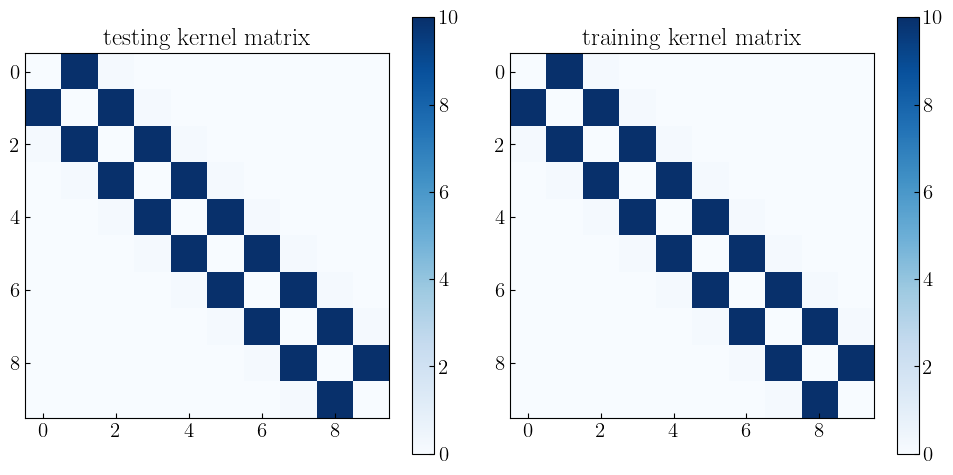

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+-----------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                      | tier=1                       | tier=2                       |
+===========+=============================+==============================+==============================+
| Norm=05pi | train:3.783582757252931e-06 | train:3.7784193563605235e-06 | train:1.7984279284973003e-06 |
+-----------+-----------------------------+------------------------------+------------------------------+
| Norm=pi   | train:9.269582957752494e-07 | train:8.553714911401778e-07  | train:2.3189690866653852e-07 |
+---

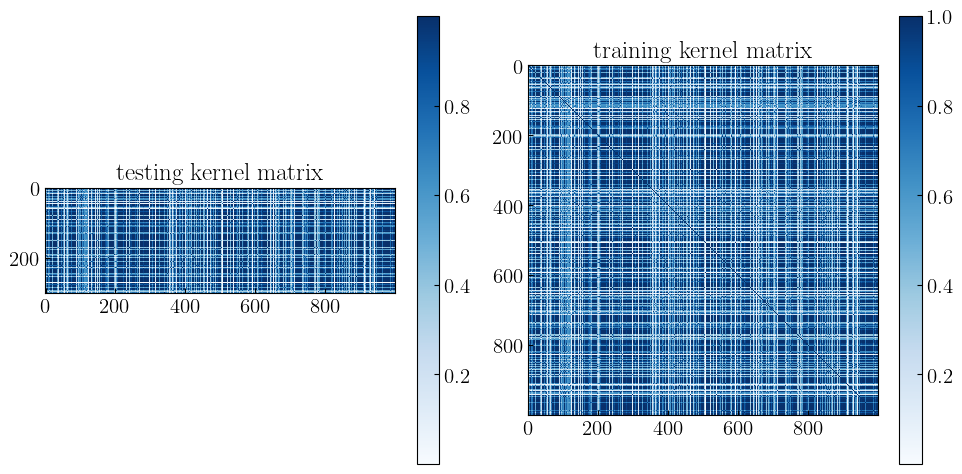

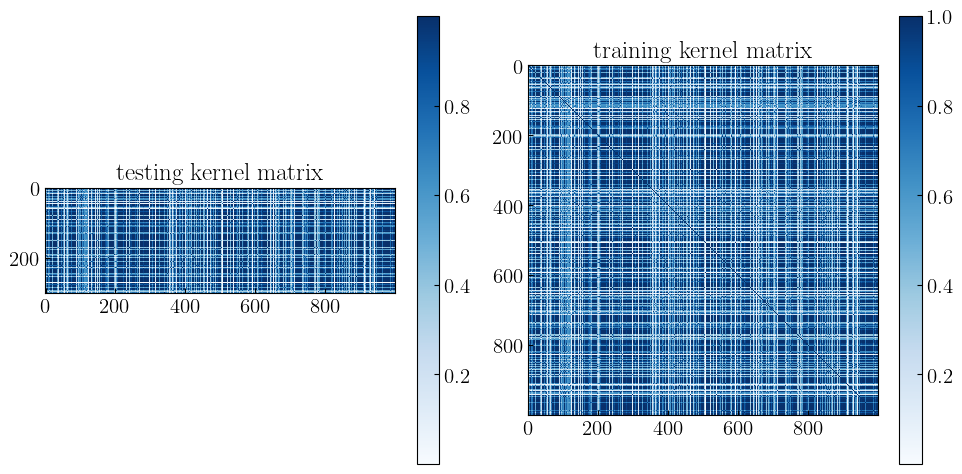

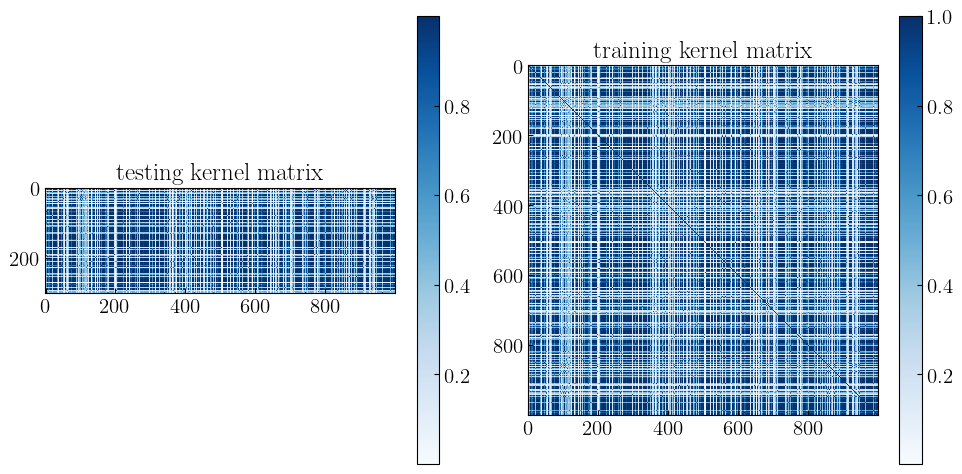

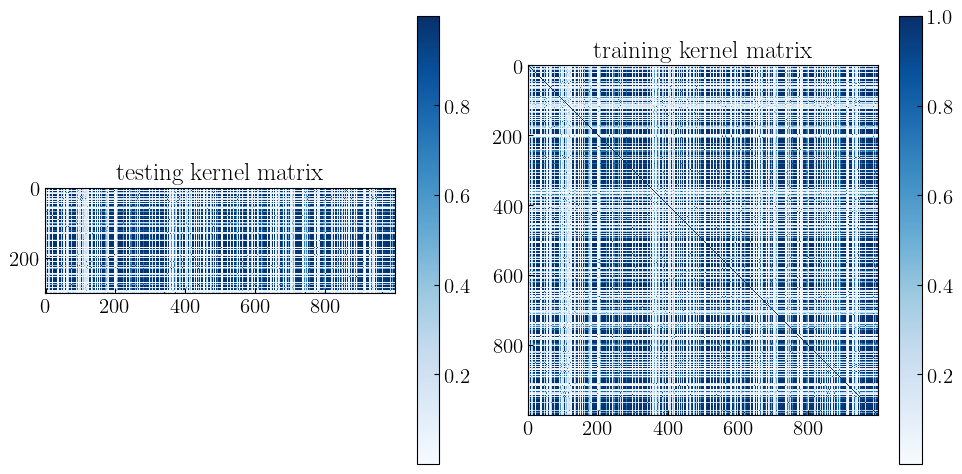

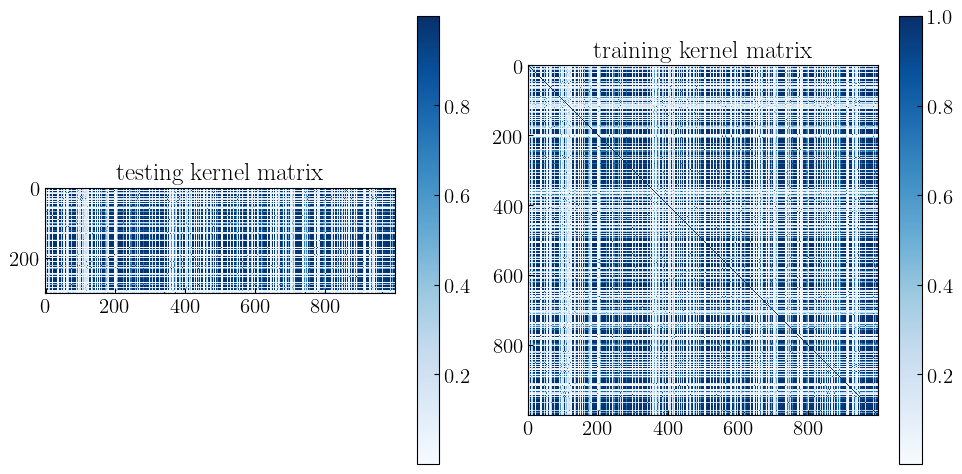

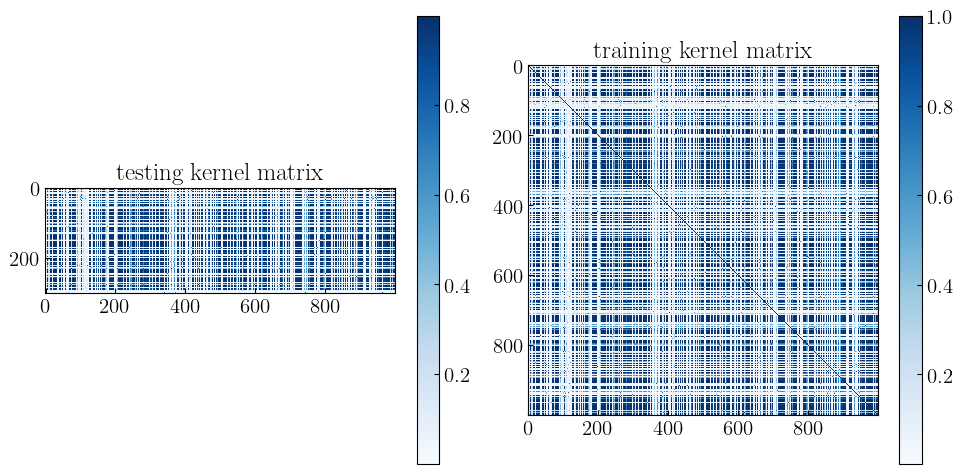

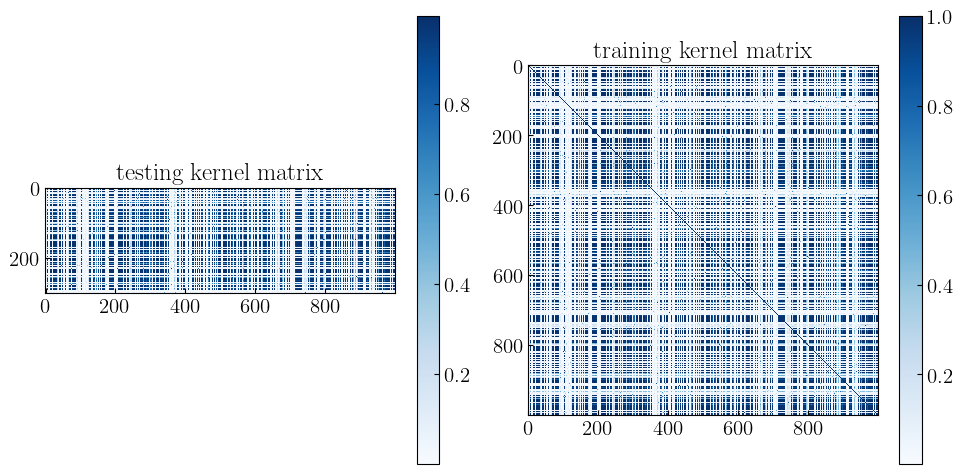

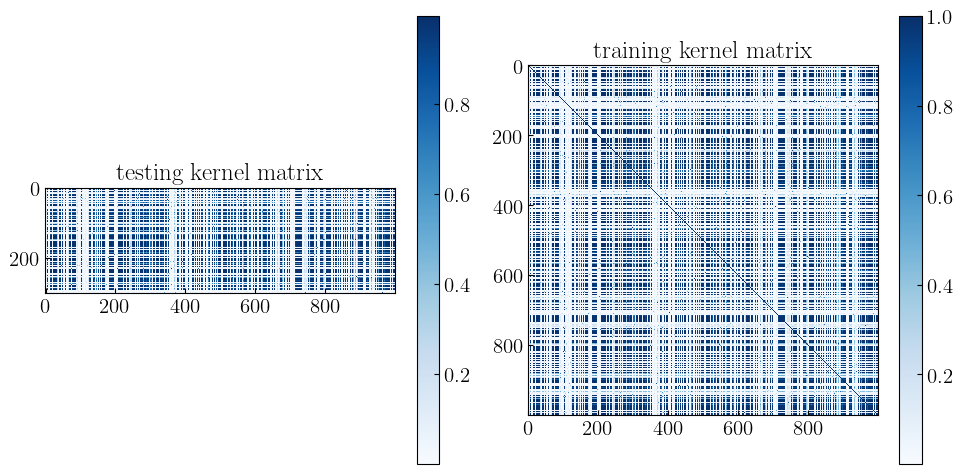

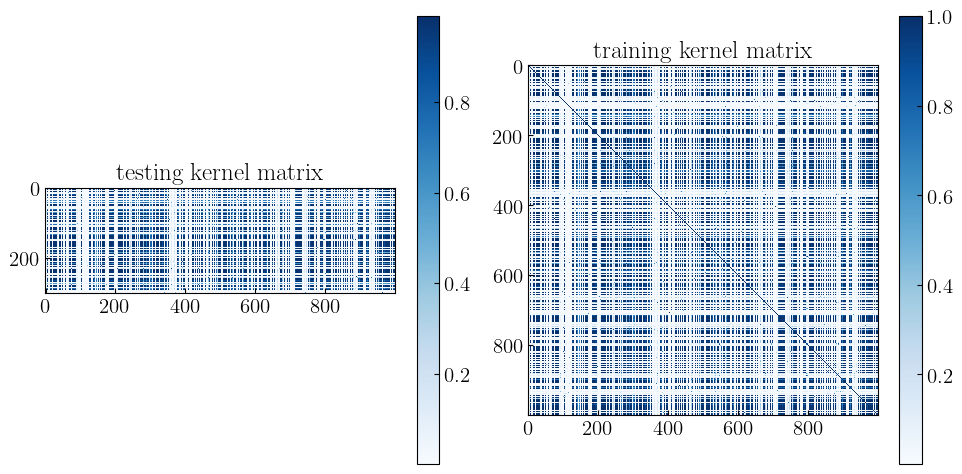

In [49]:
from tabulate import tabulate

V=10
op="z"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraZ/Non/V{V}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=2

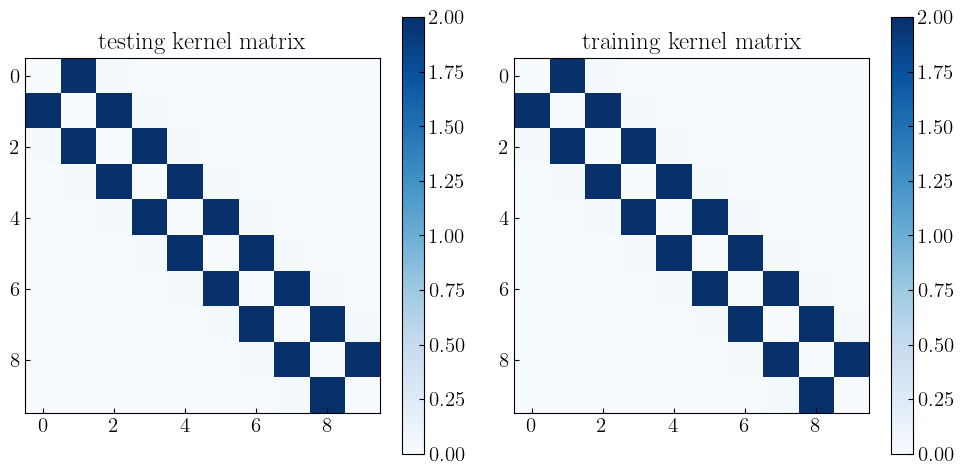

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:3.105237347102658e-06  | train:3.0655865586250786e-06 | train:9.173620901703755e-07  |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:4.998272204870214e-07  | train:5.001069899728053e-07  | train:1.3327390231121938e-07 

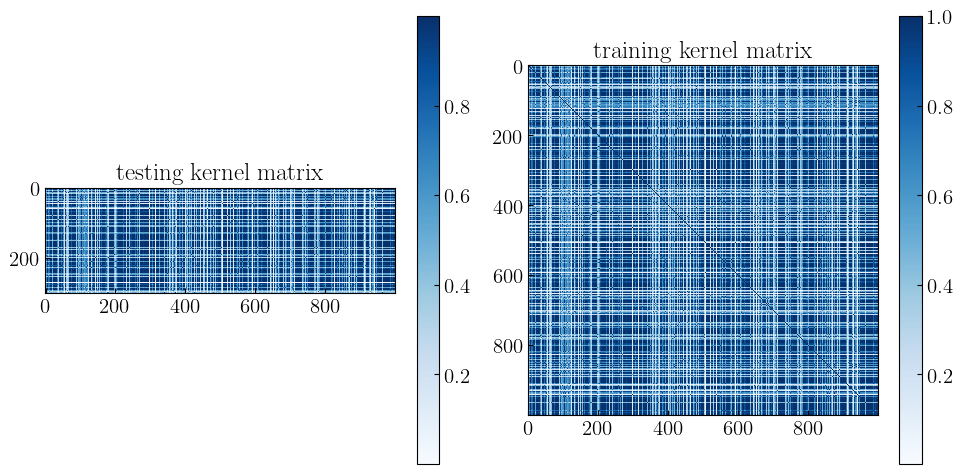

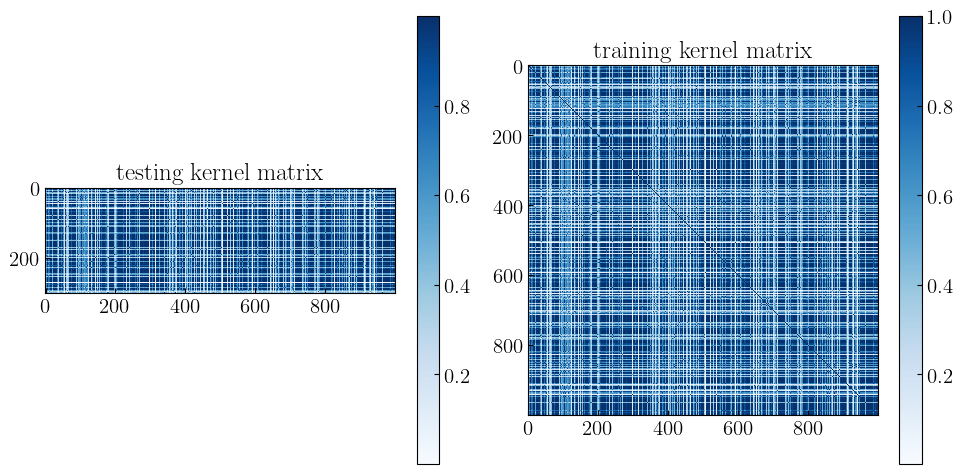

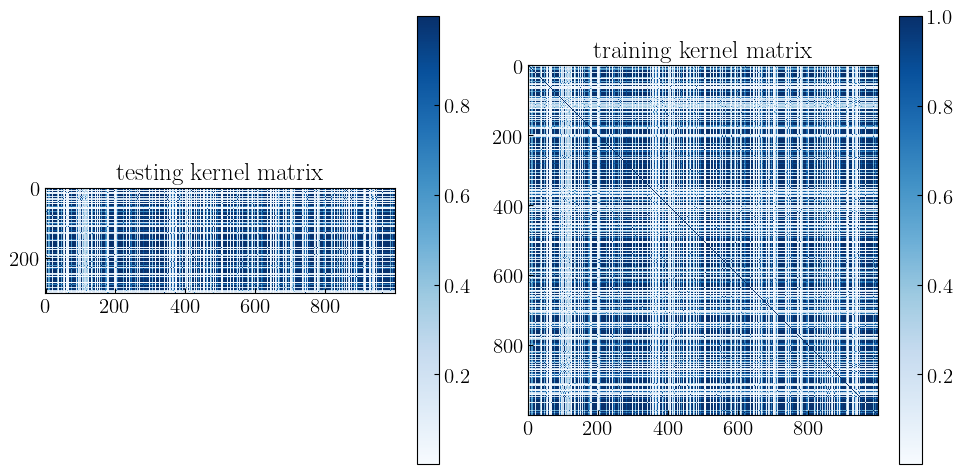

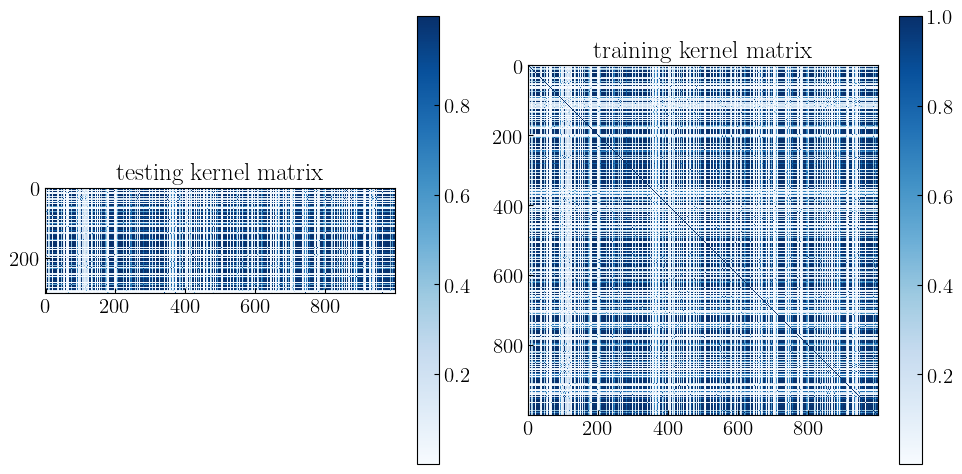

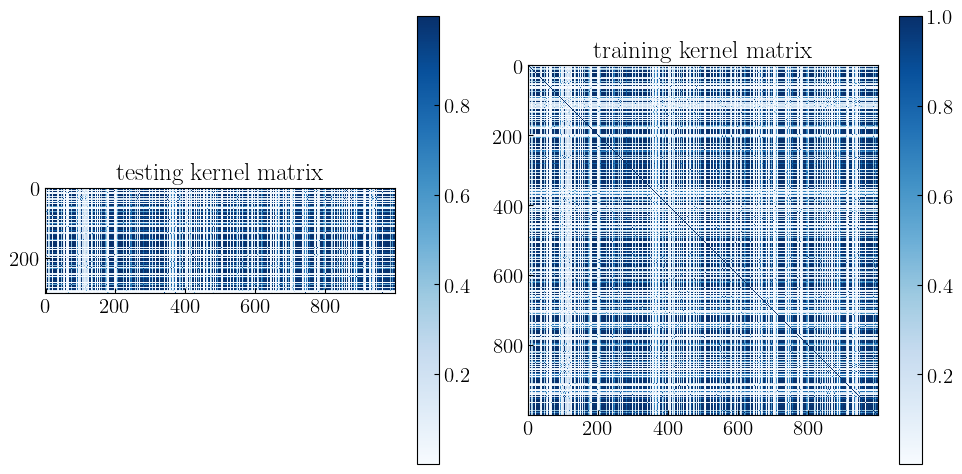

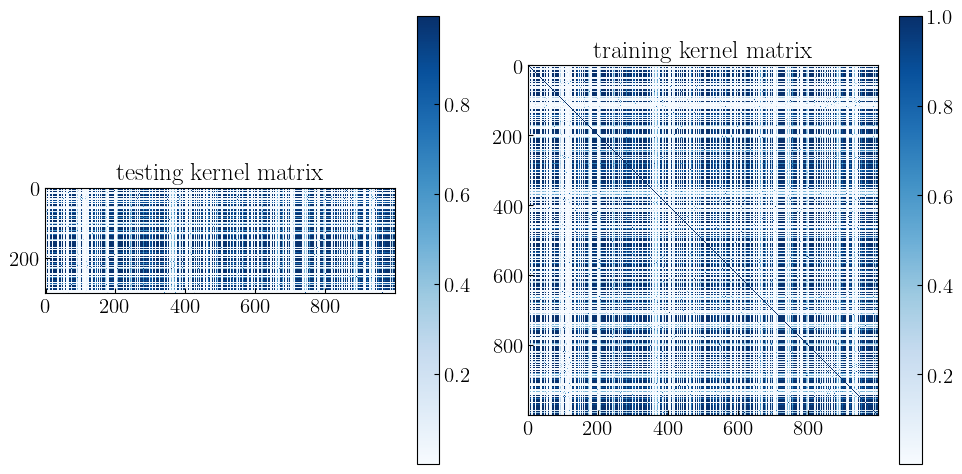

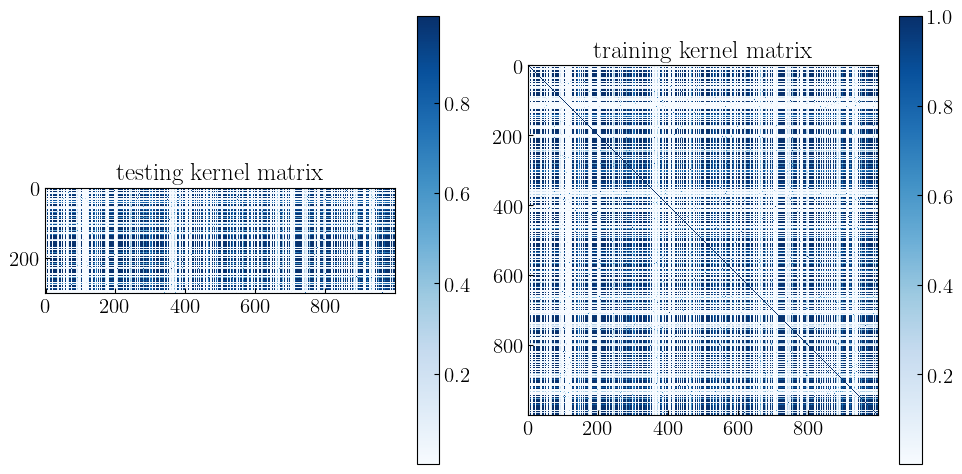

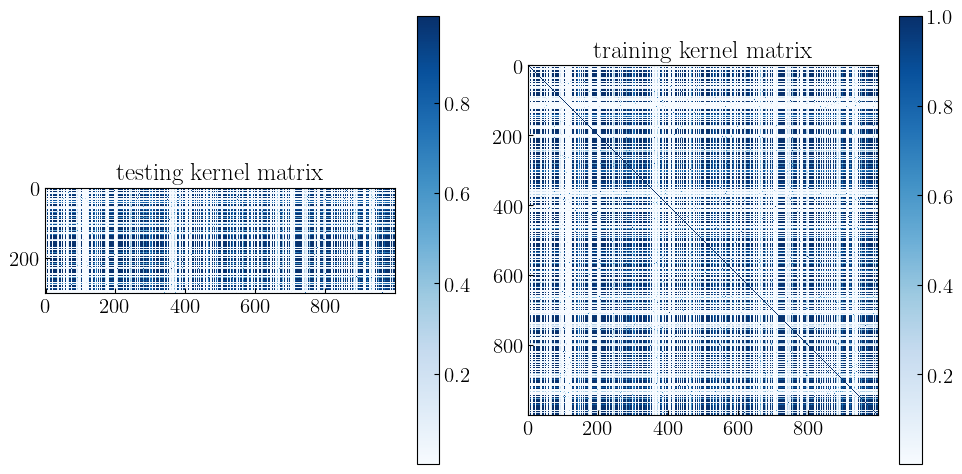

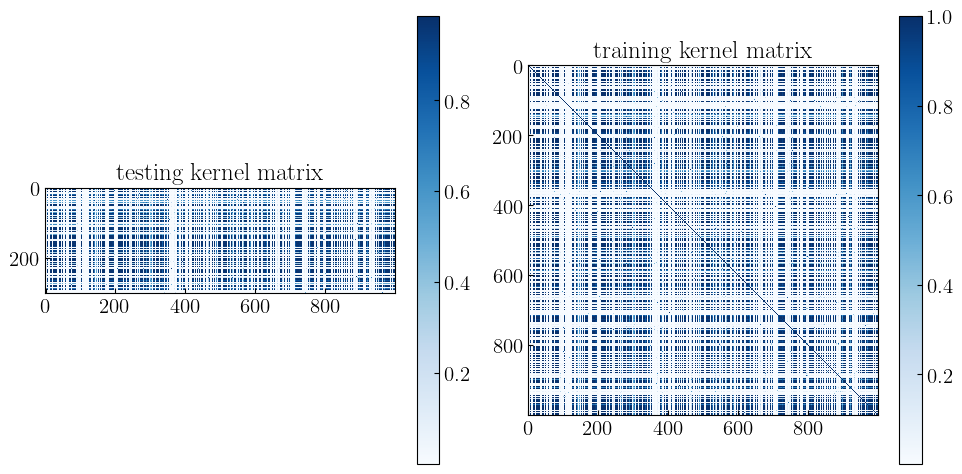

In [50]:
from tabulate import tabulate

V=2
op="z"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraZ/Non/V{V}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=1

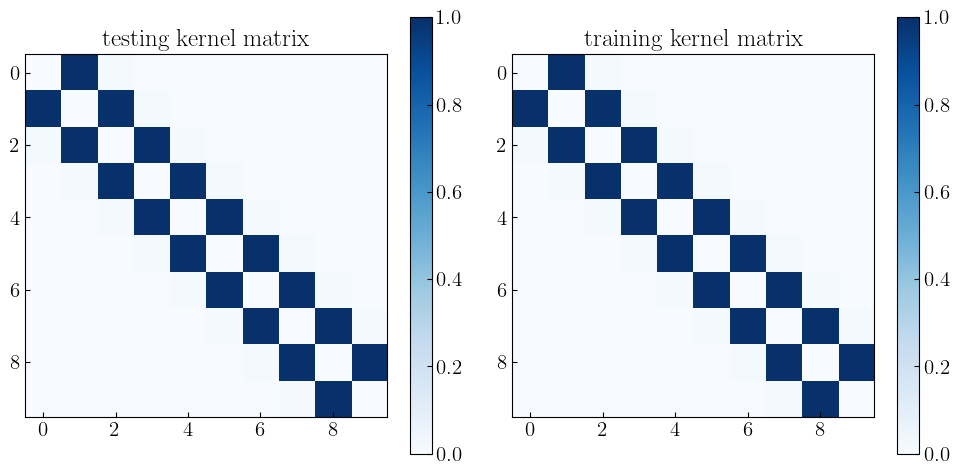

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:3.94950337170856e-06   | train:3.970590040661703e-06  | train:1.5910436552439975e-06 |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:8.153182629055914e-07  | train:7.777771206347491e-07  | train:2.3755360380758016e-07 

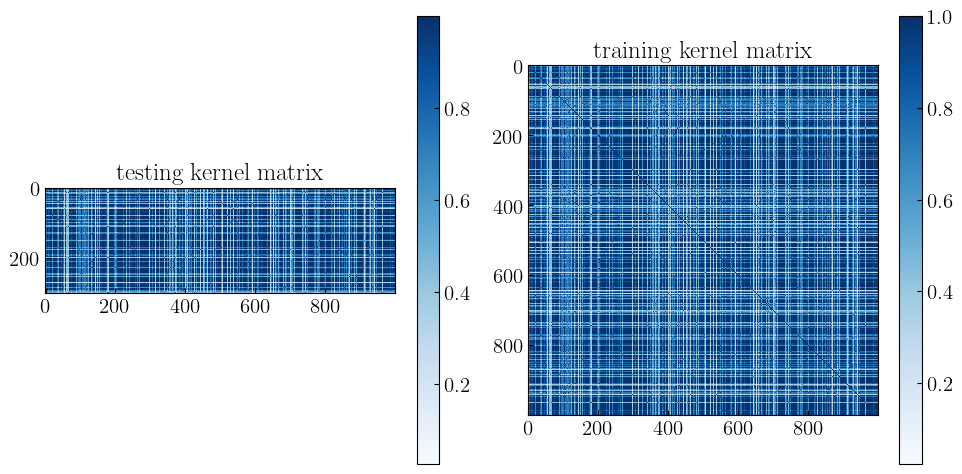

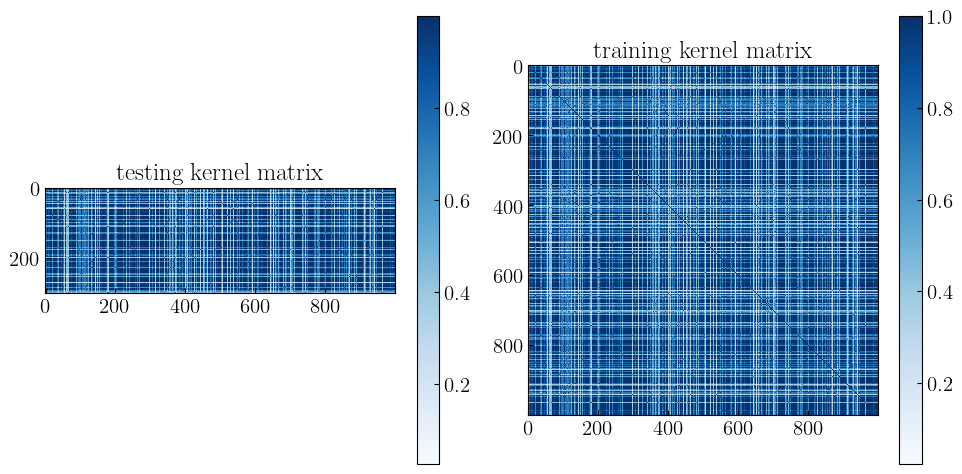

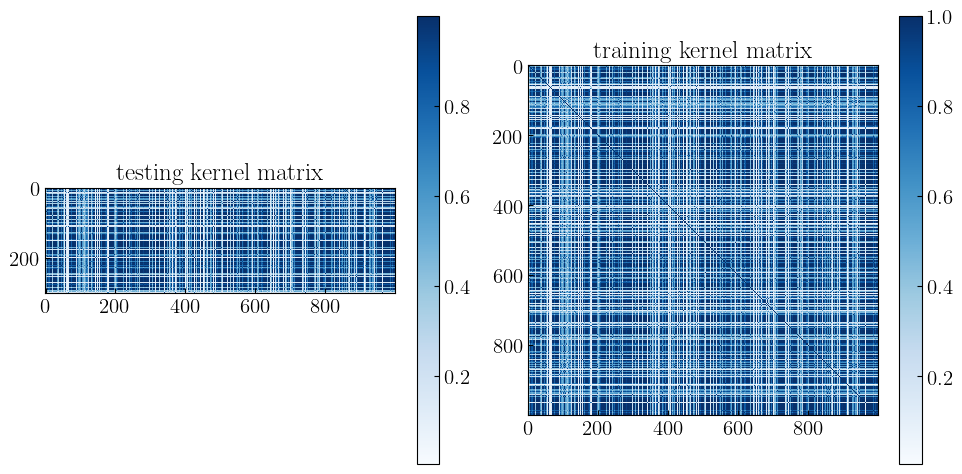

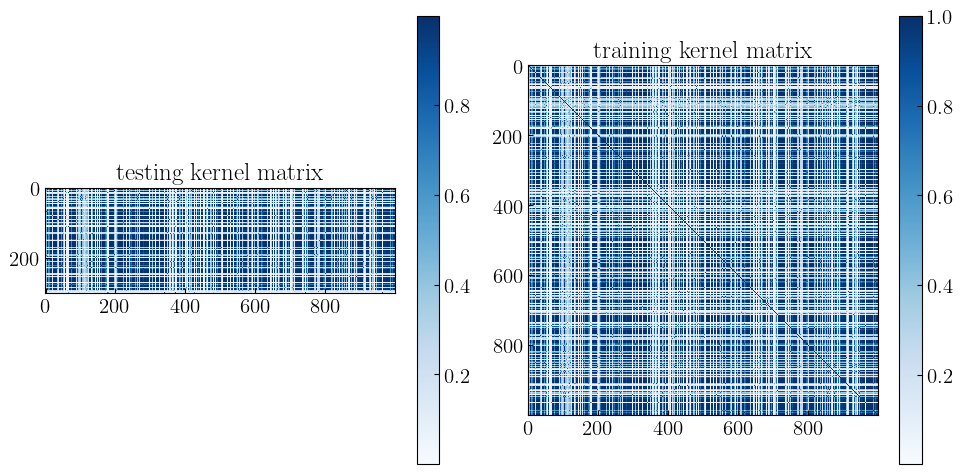

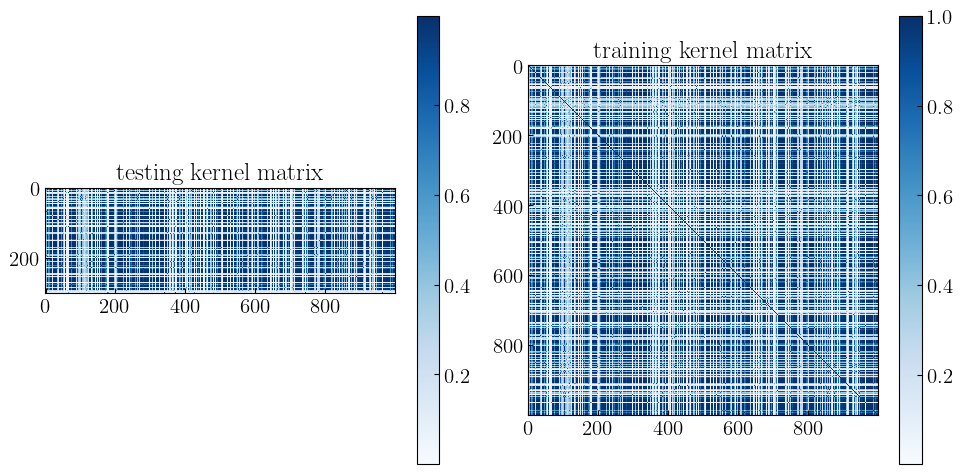

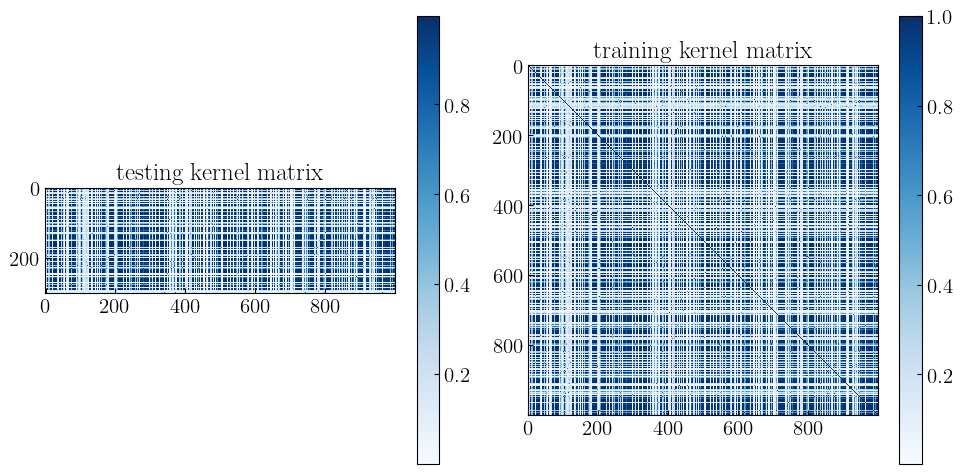

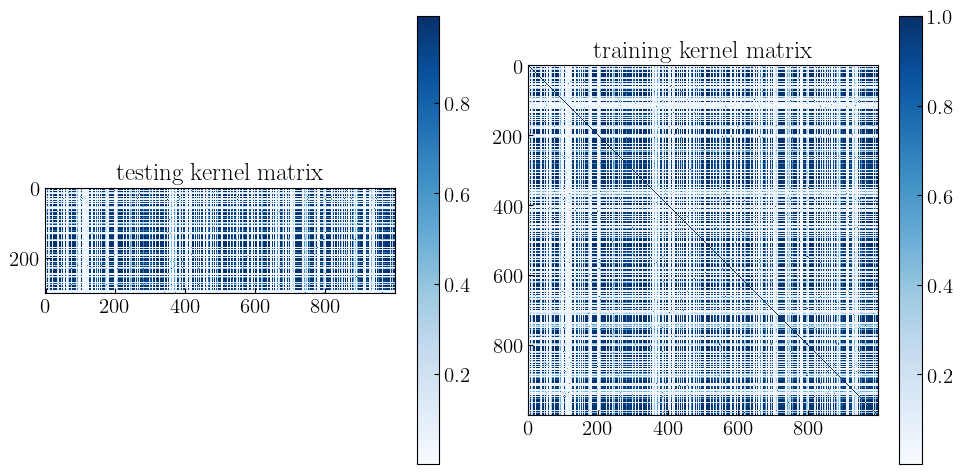

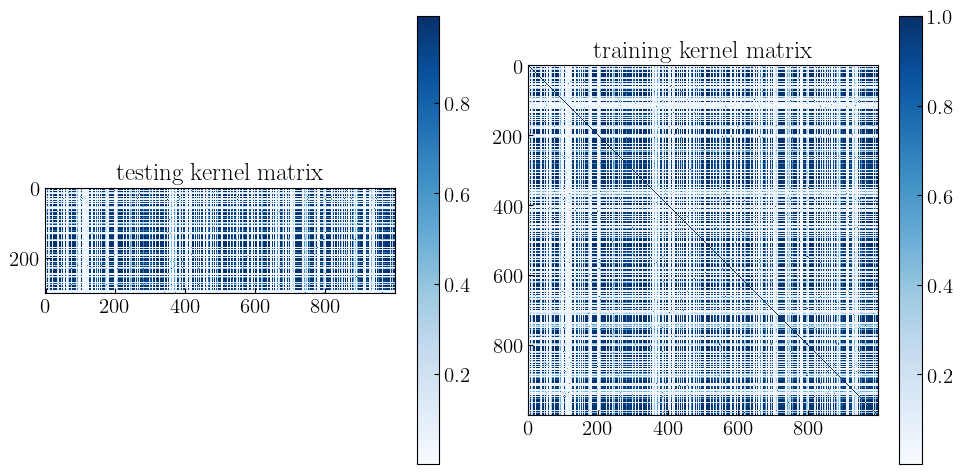

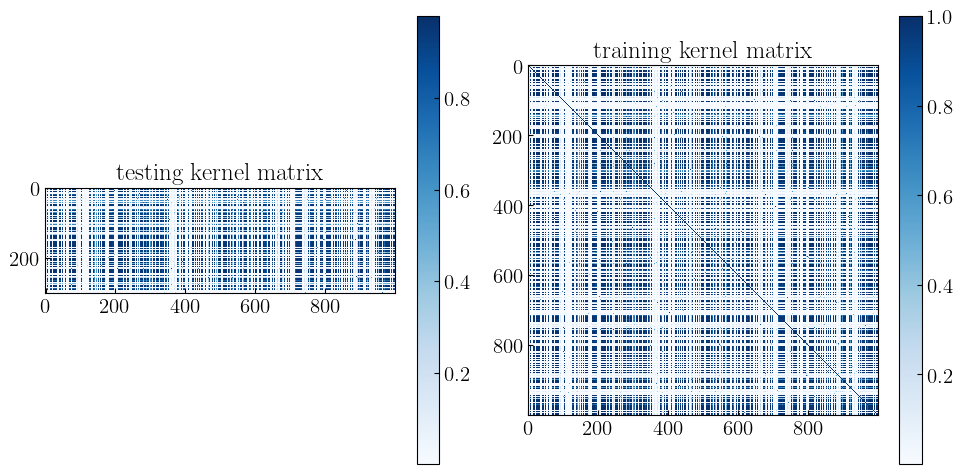

In [51]:
from tabulate import tabulate

V=1
op="z"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraZ/Non/V{V}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=0.5

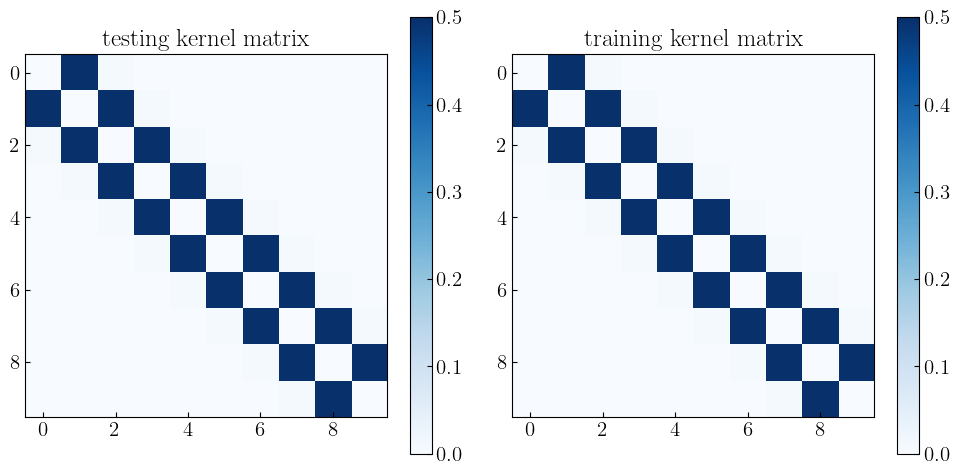

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:9.04516583512315e-06   | train:9.022953788002313e-06  | train:2.8706737204951656e-06 |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:2.144436426536842e-06  | train:2.1444364265377464e-06 | train:3.127618132383814e-07  

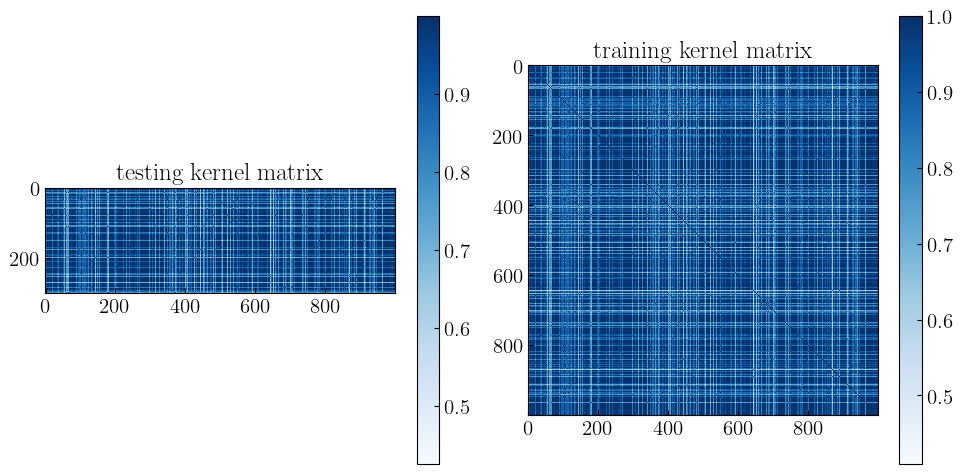

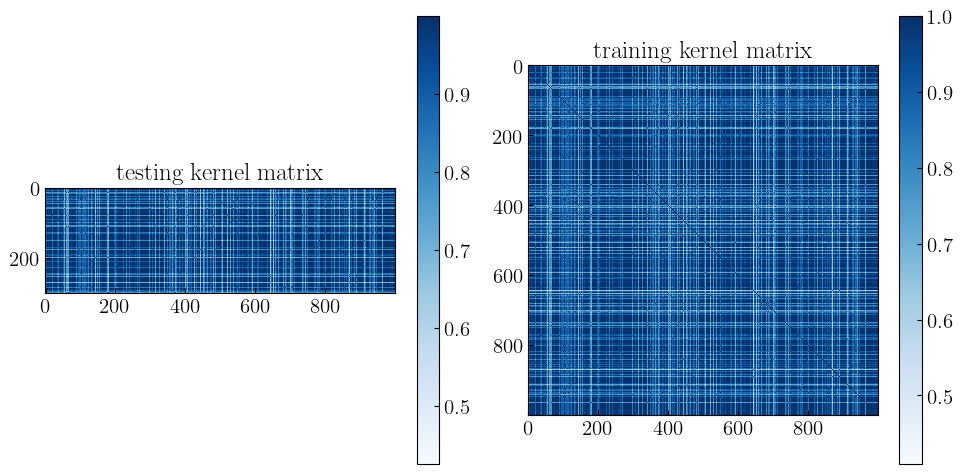

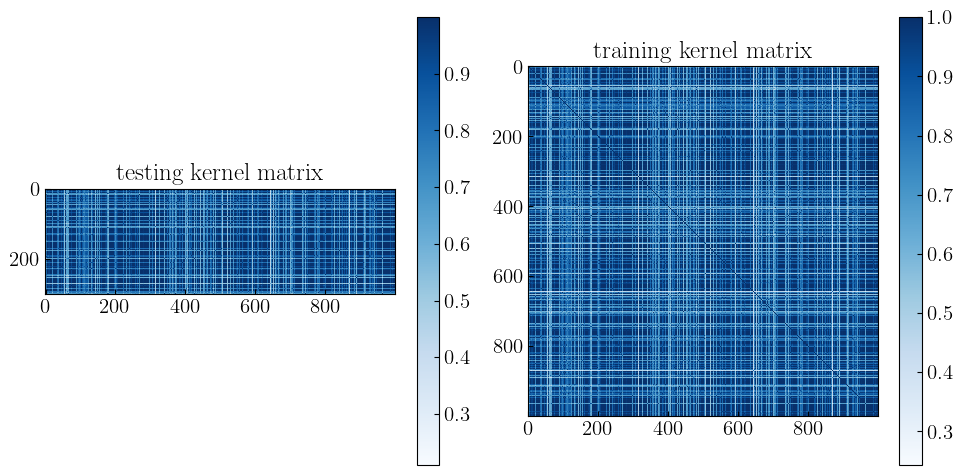

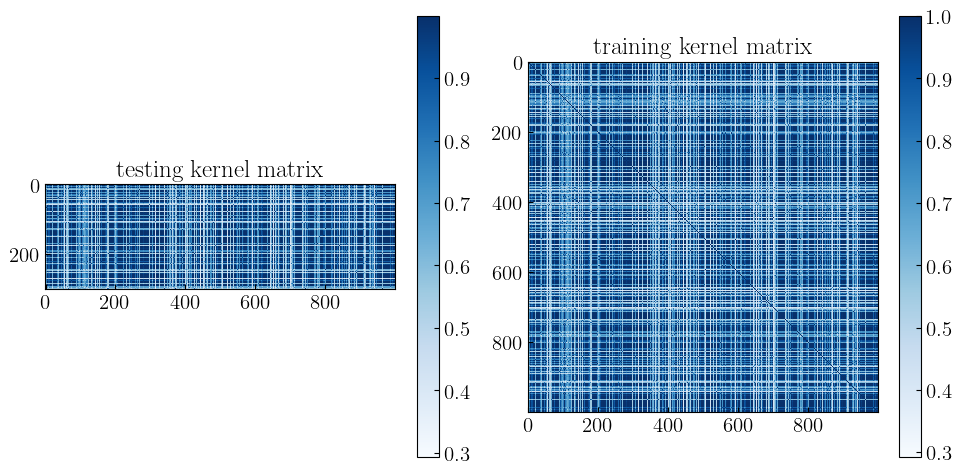

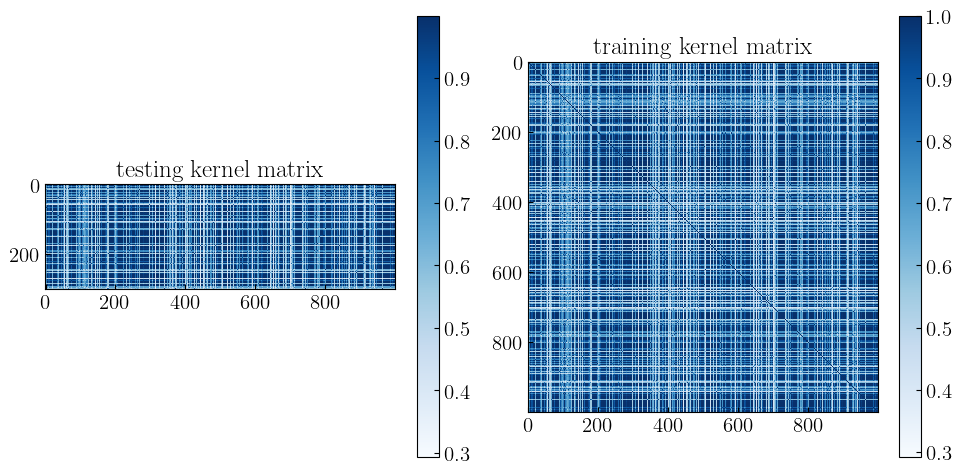

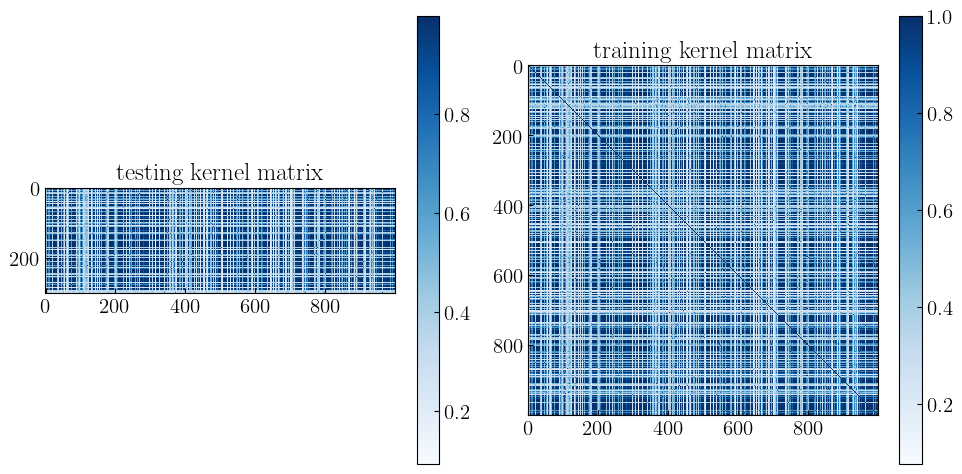

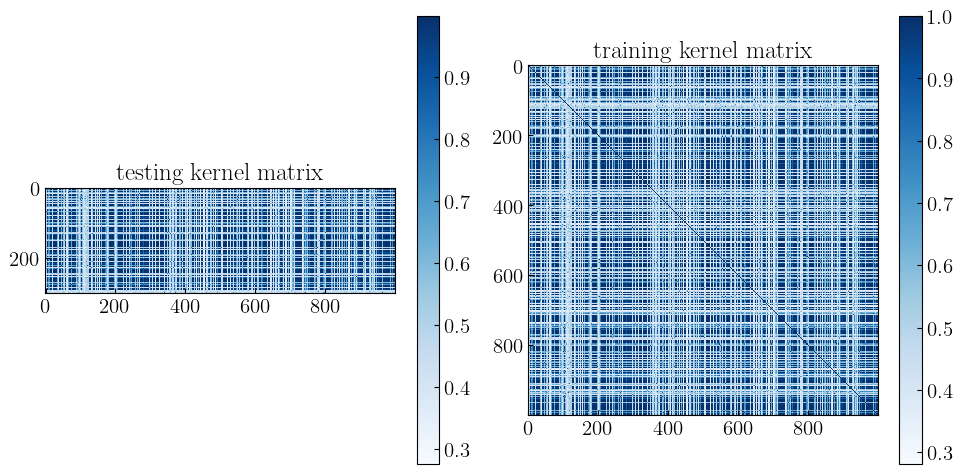

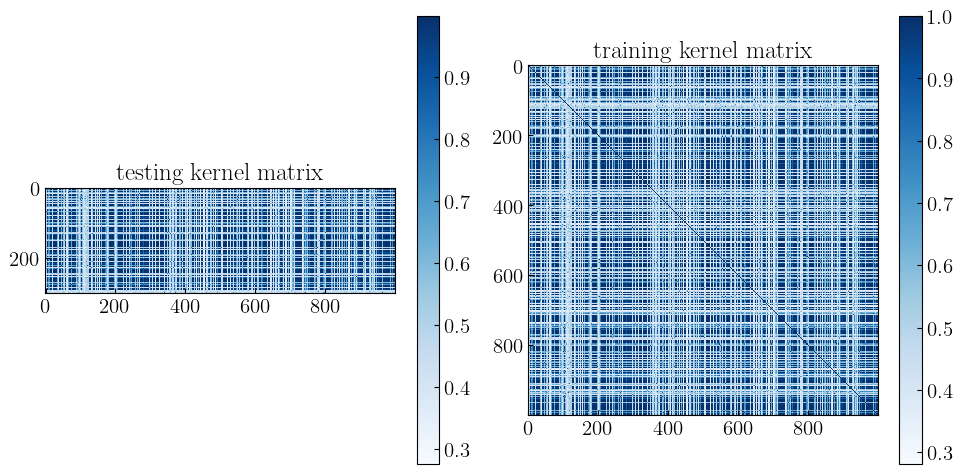

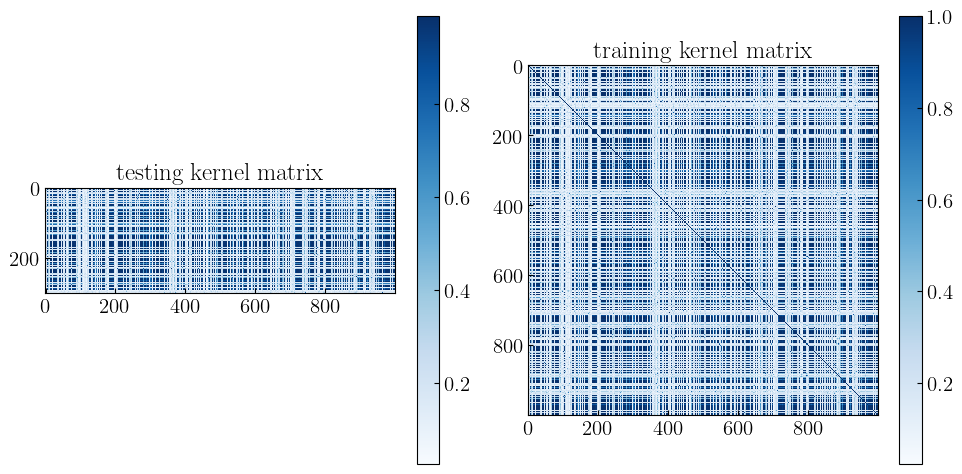

In [148]:
from tabulate import tabulate

V=0.5
op="z"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraZ/Non/V0{int(V*100)}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=0.25

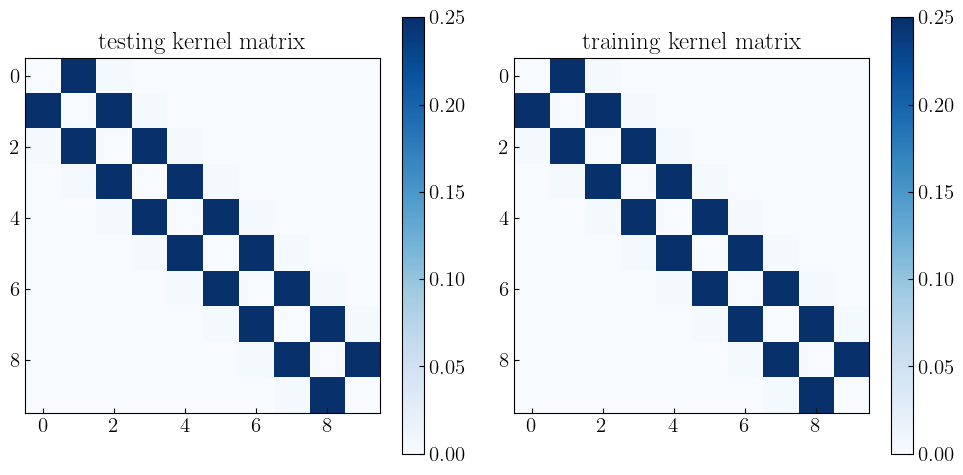

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+-----------------------------+-----------------------------+------------------------------+
| sigmax    | tier=0                      | tier=1                      | tier=2                       |
+===========+=============================+=============================+==============================+
| Norm=05pi | train:3.64707269742185e-05  | train:3.643594376684639e-05 | train:1.1173241950746704e-05 |
+-----------+-----------------------------+-----------------------------+------------------------------+
| Norm=pi   | train:7.393137734385231e-06 | train:7.359532473738469e-06 | train:1.0288129876154474e-06 |
+---------

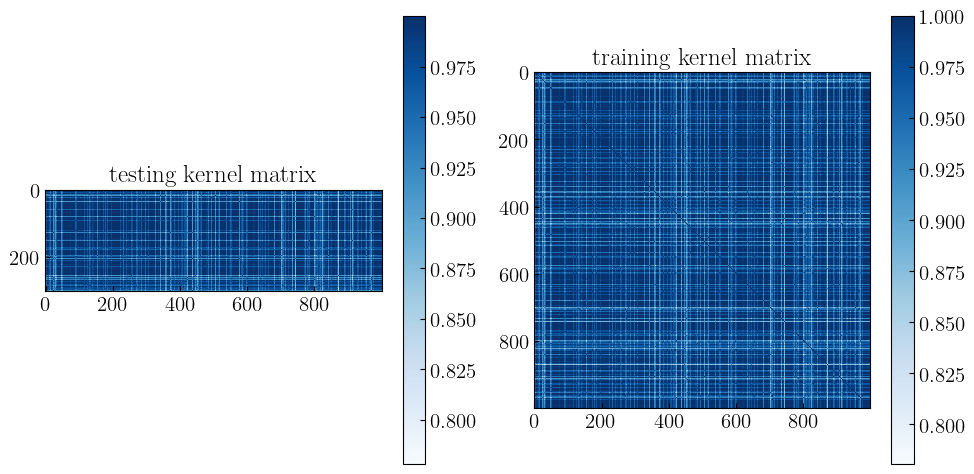

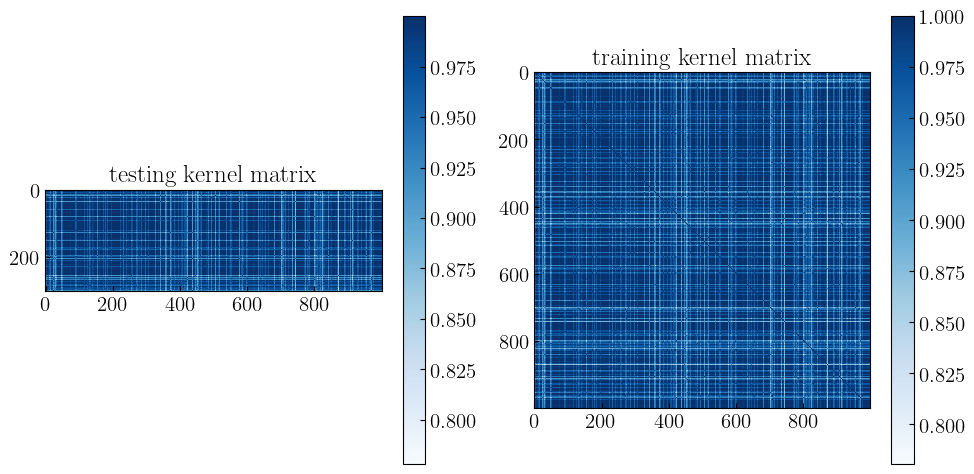

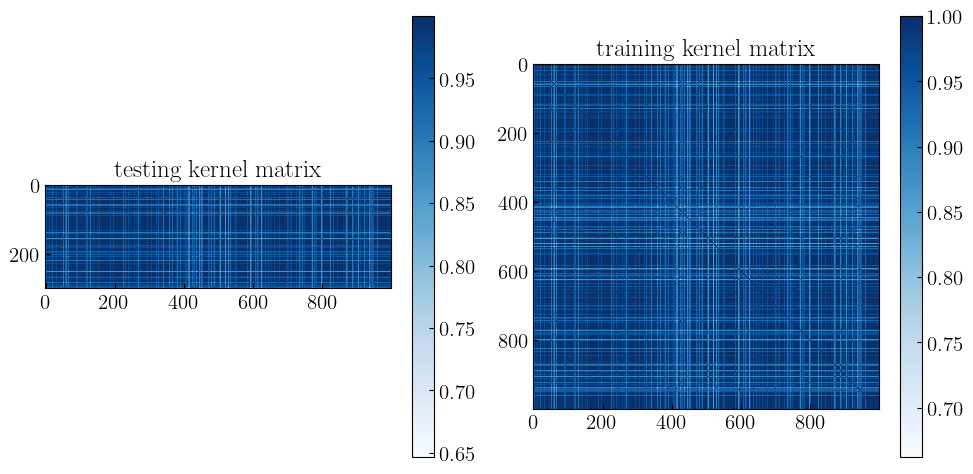

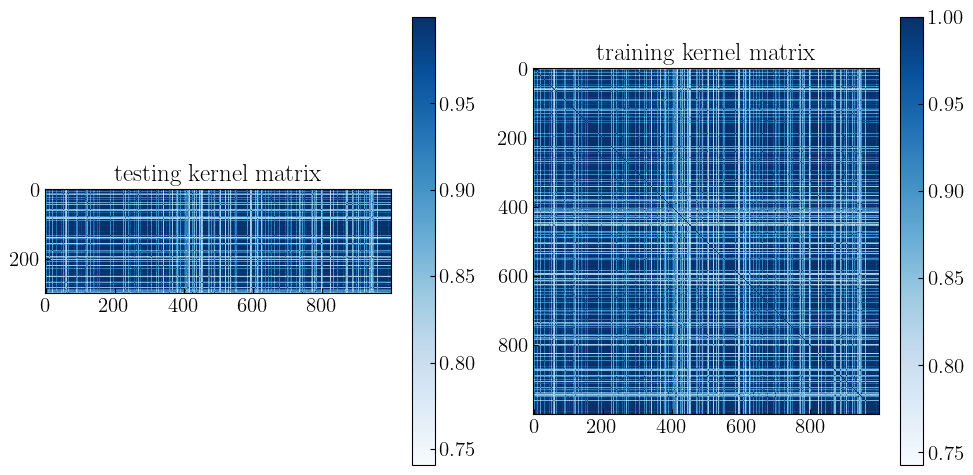

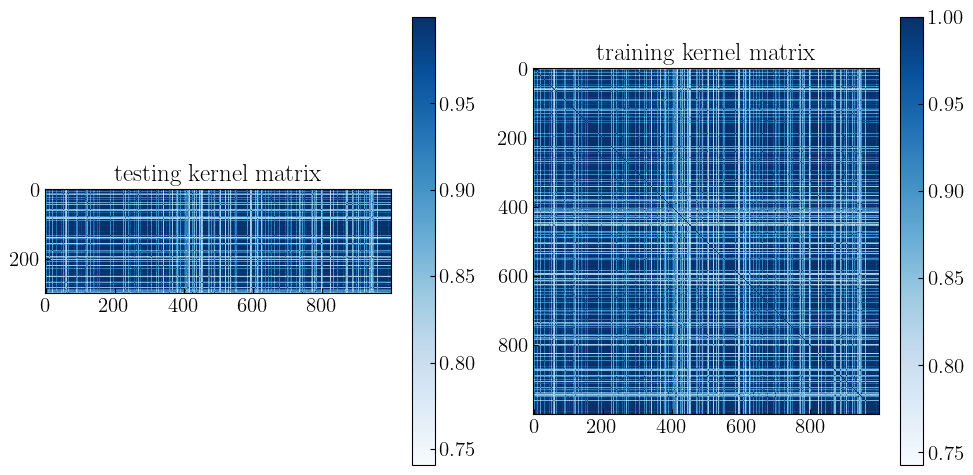

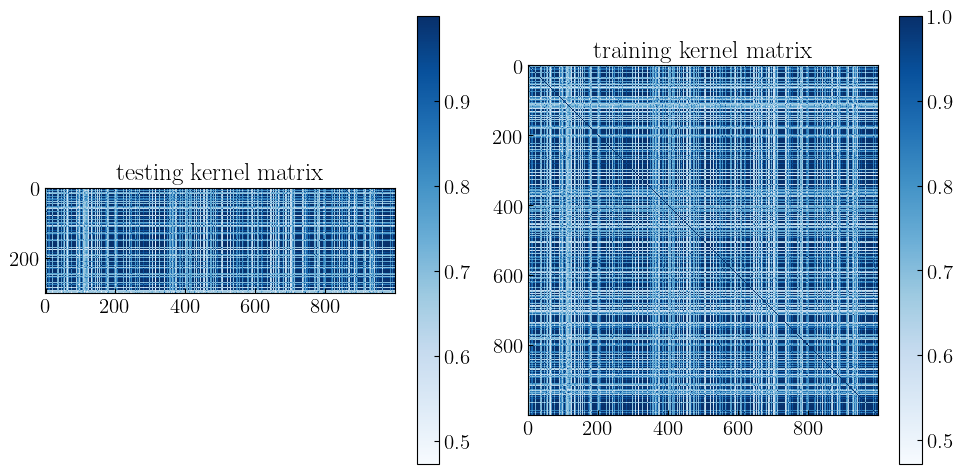

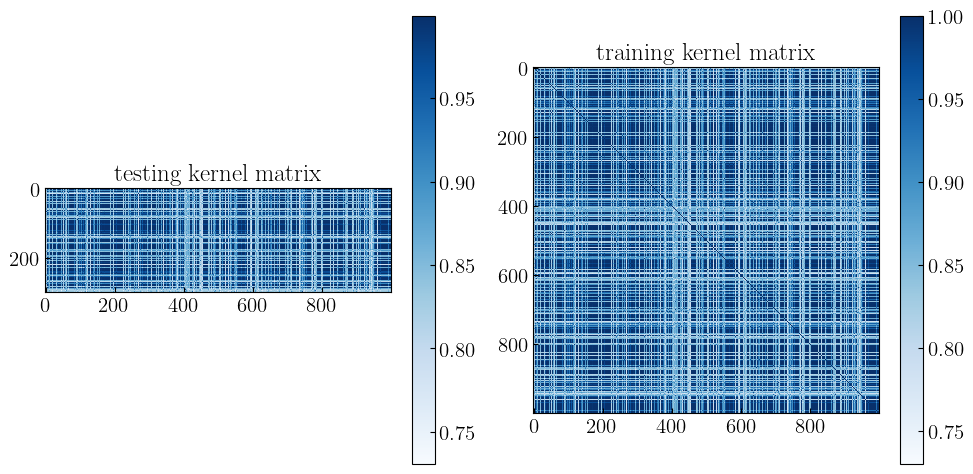

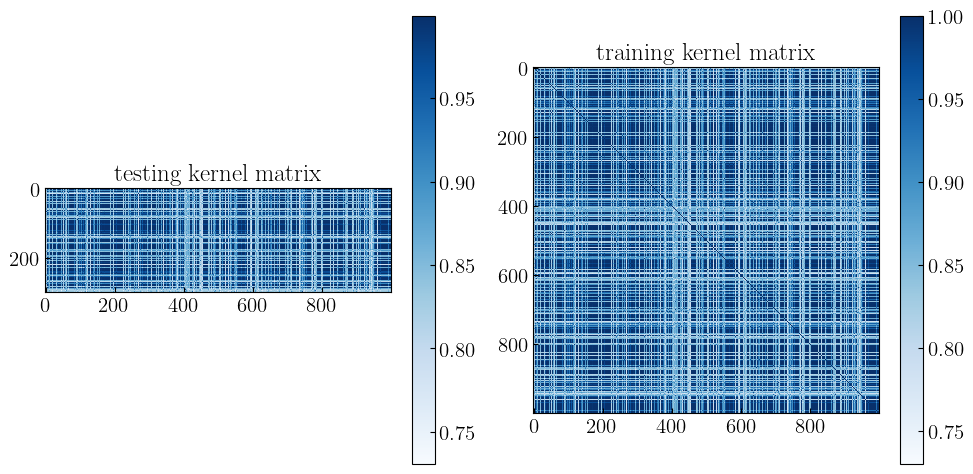

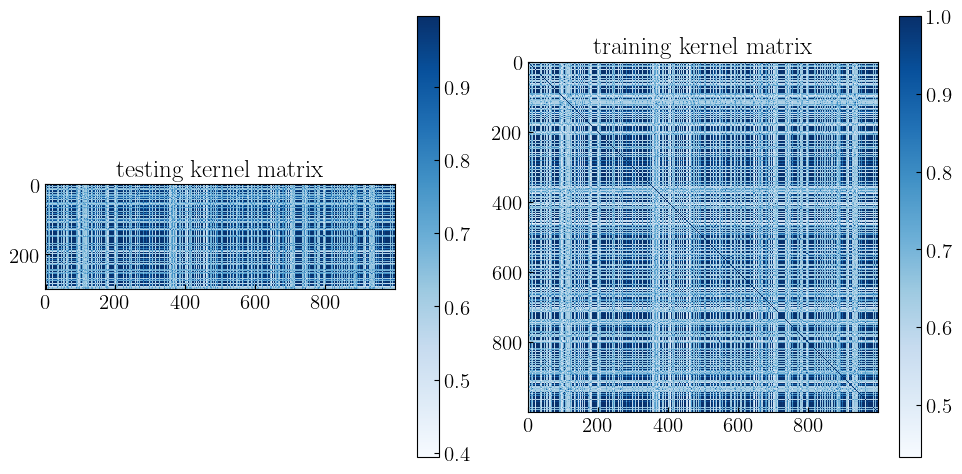

In [149]:
from tabulate import tabulate

V=0.25
op="z"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraZ/Non/V0{int(V*100)}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

# Quera X

## V=10

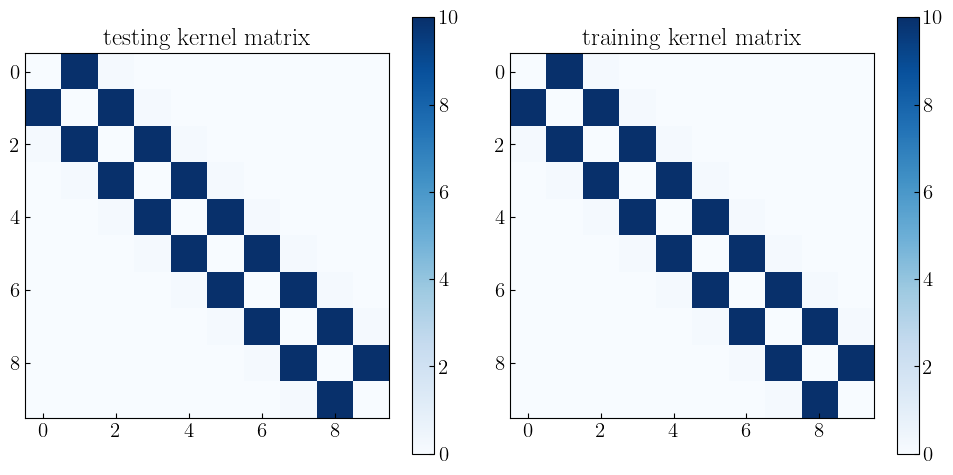

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:2.8447012718262664e-06 | train:1.1390375723352511e-06 | train:5.464757475899127e-07  |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:5.714961449175244e-07  | train:1.449190246648762e-07  | train:1.0427919839226356e-07 

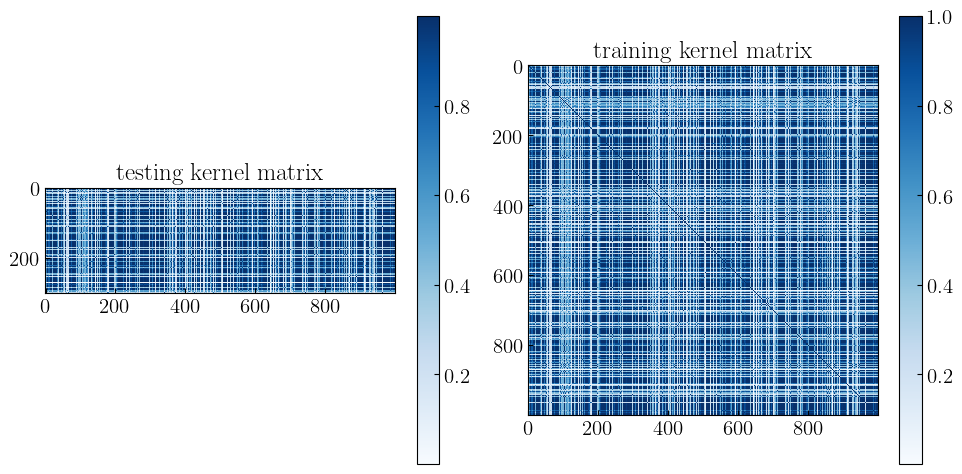

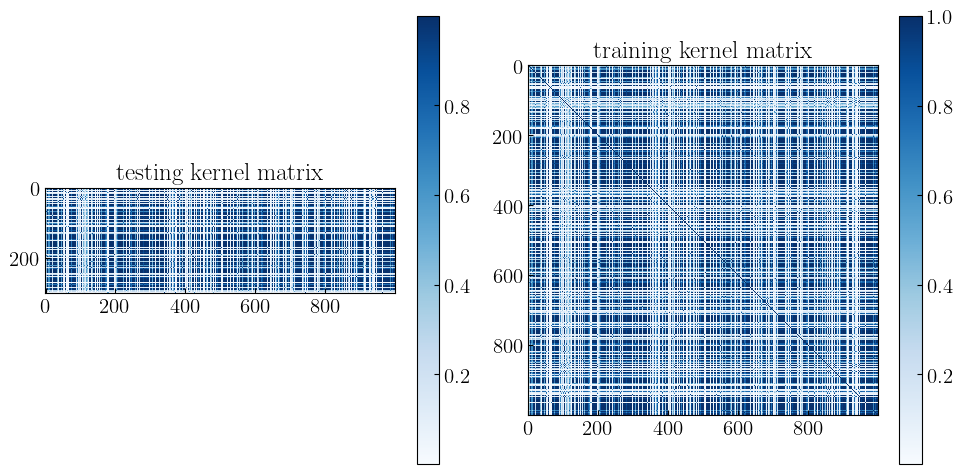

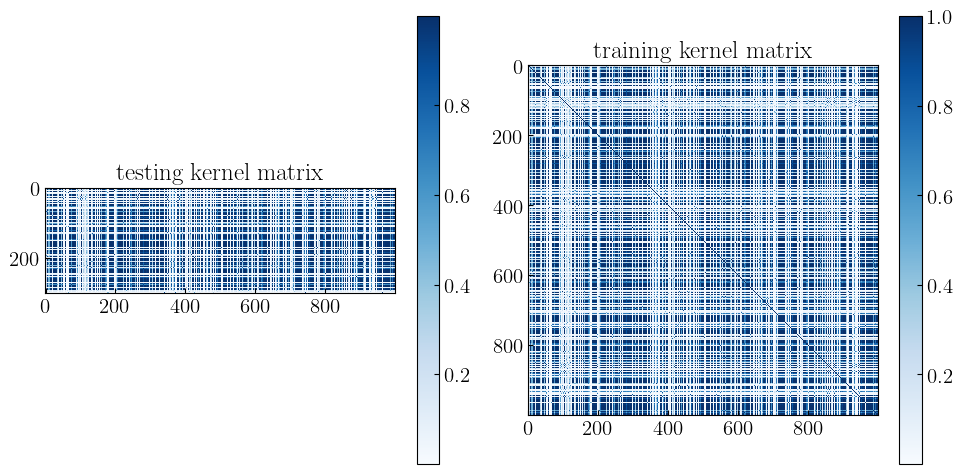

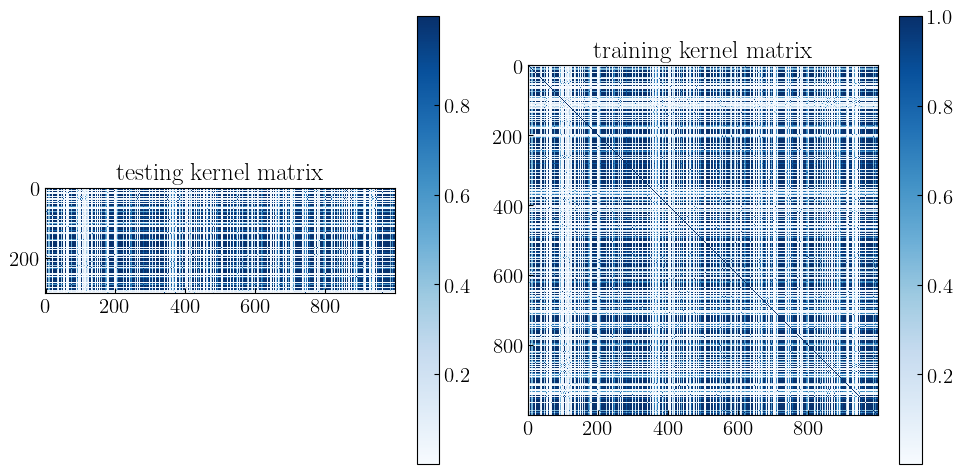

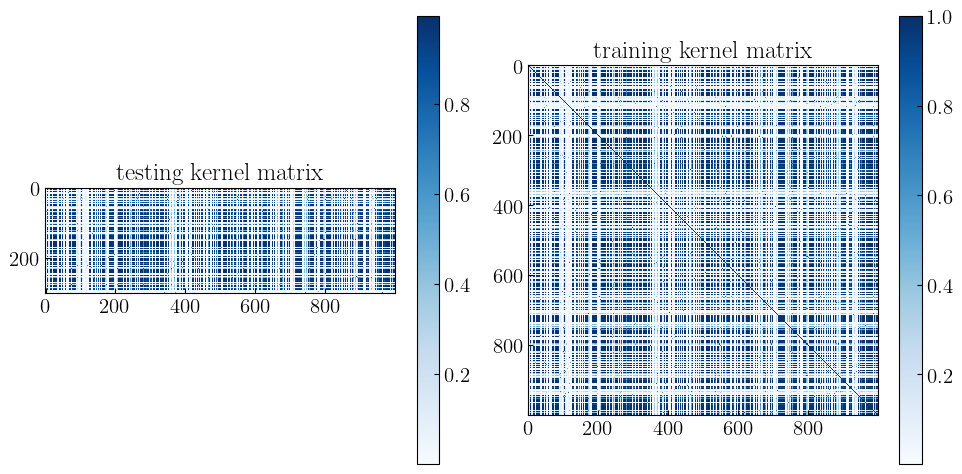

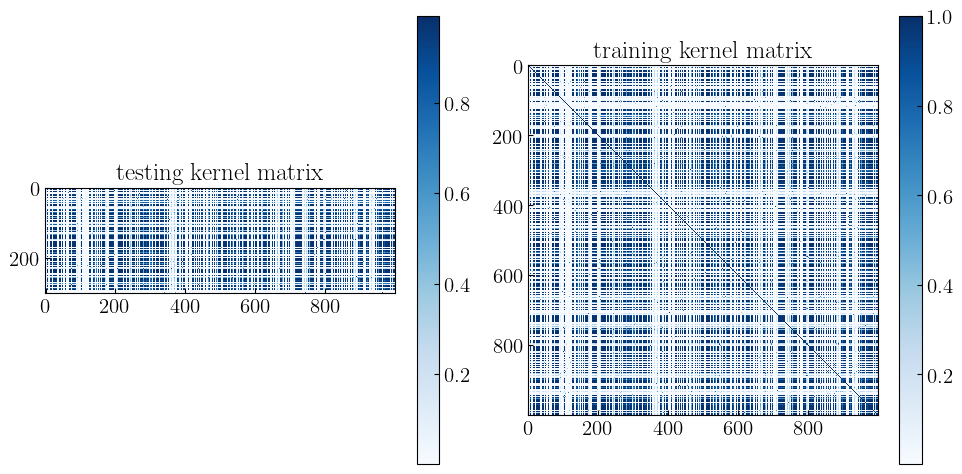

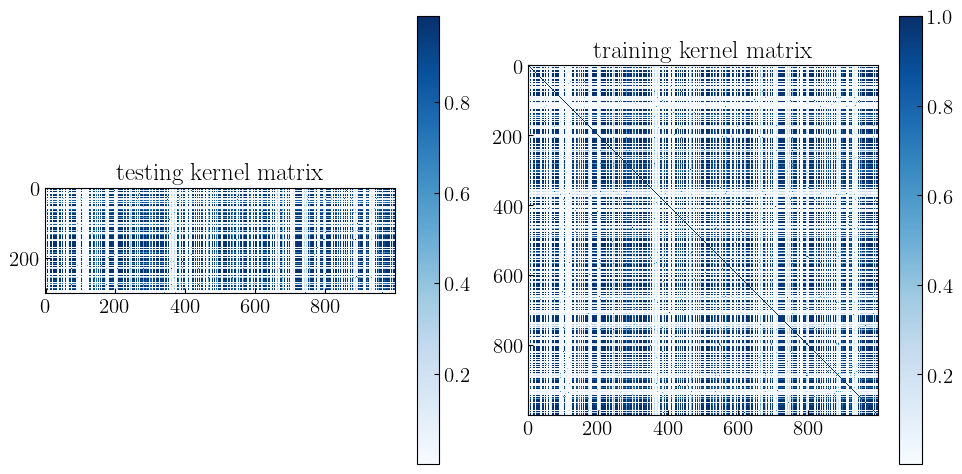

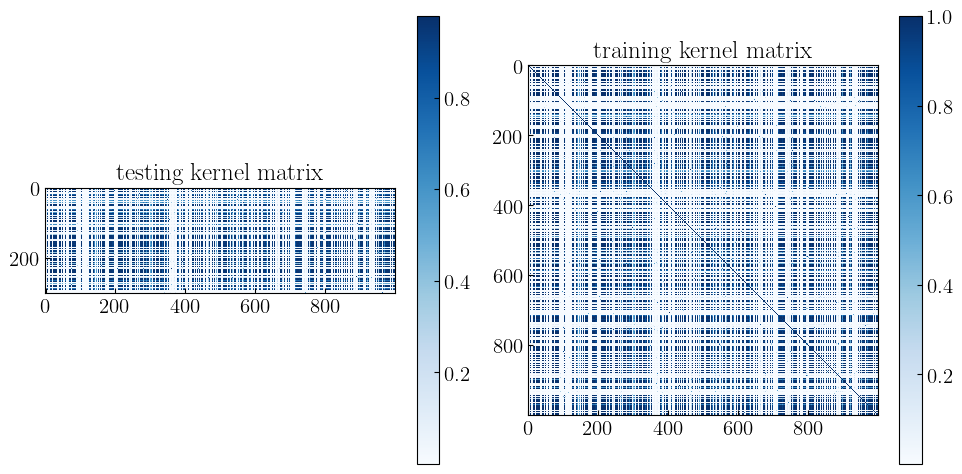

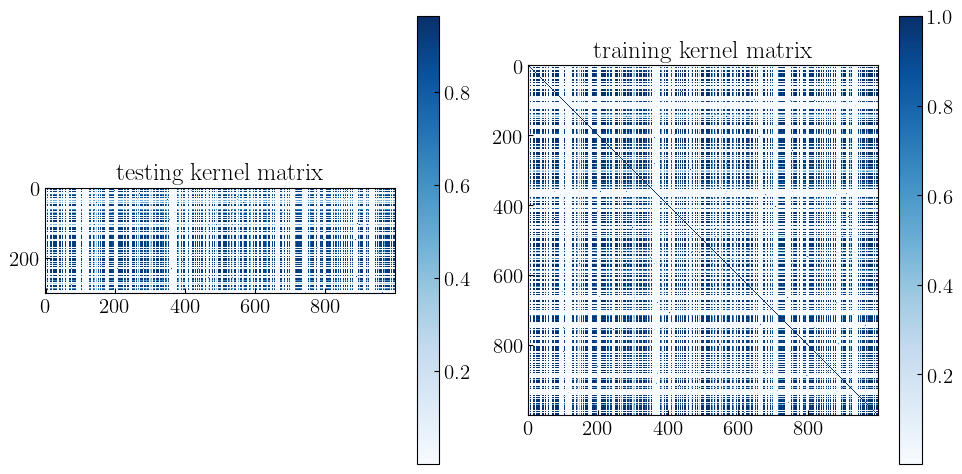

In [41]:
from tabulate import tabulate

V=10
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraX/Non/V{V}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=2

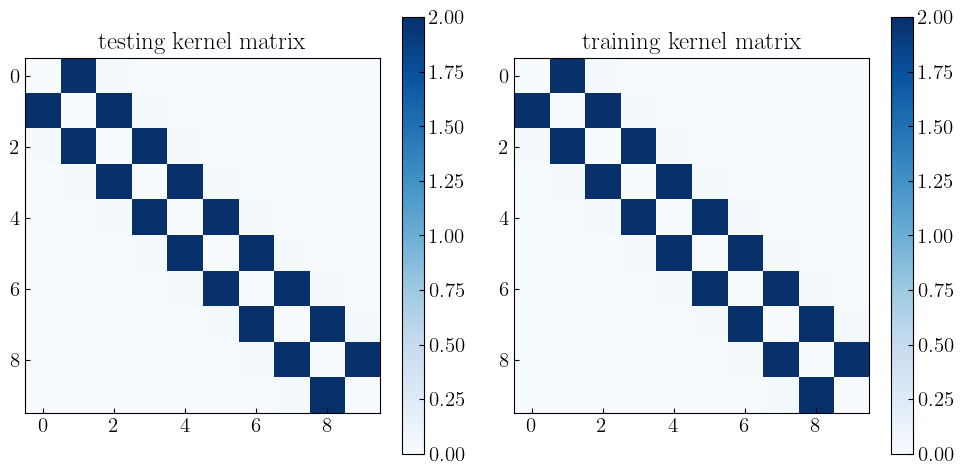

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:3.157897918790476e-06  | train:1.158836040529586e-06  | train:4.719403701245005e-07  |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:6.310216980033707e-07  | train:1.4557426901829006e-07 | train:1.1179658262195559e-07 

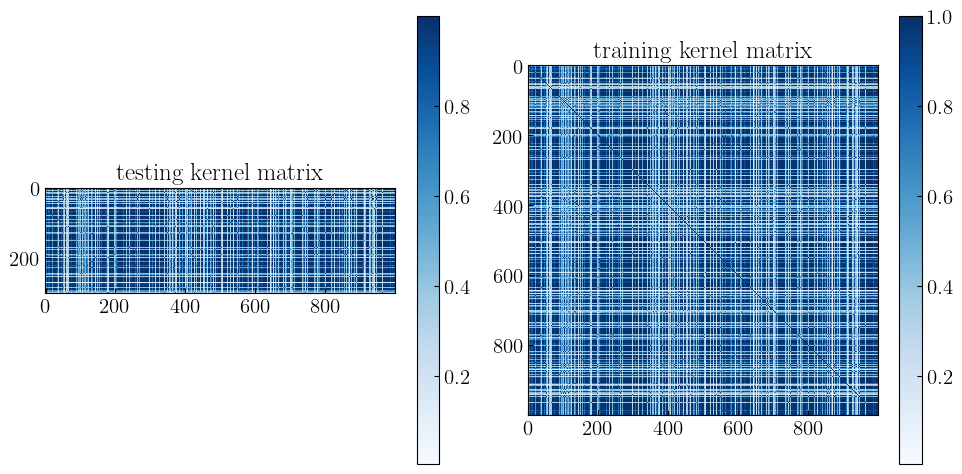

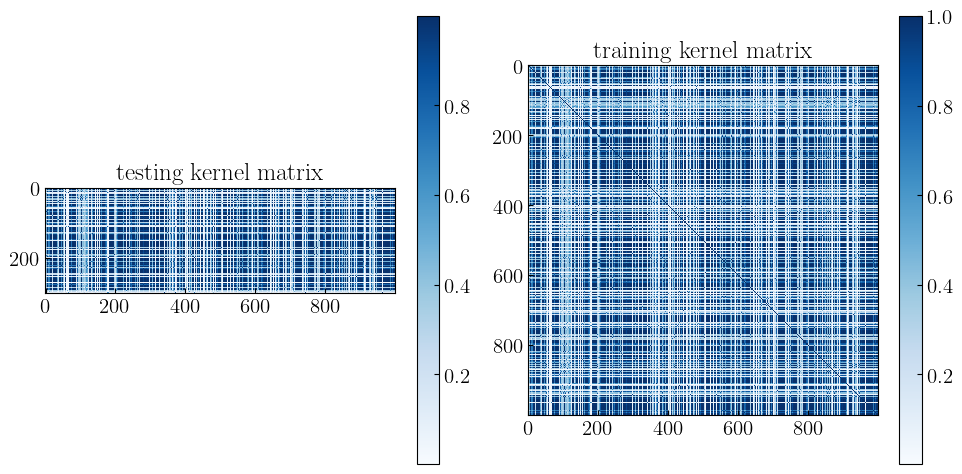

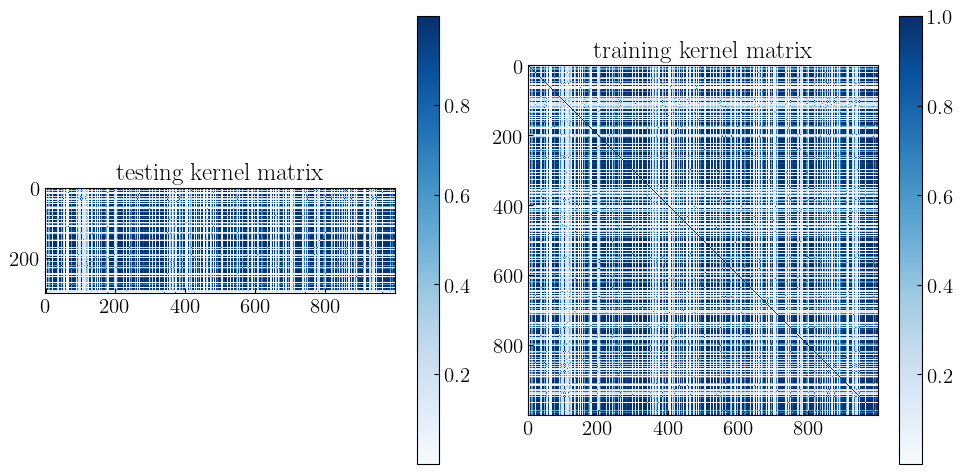

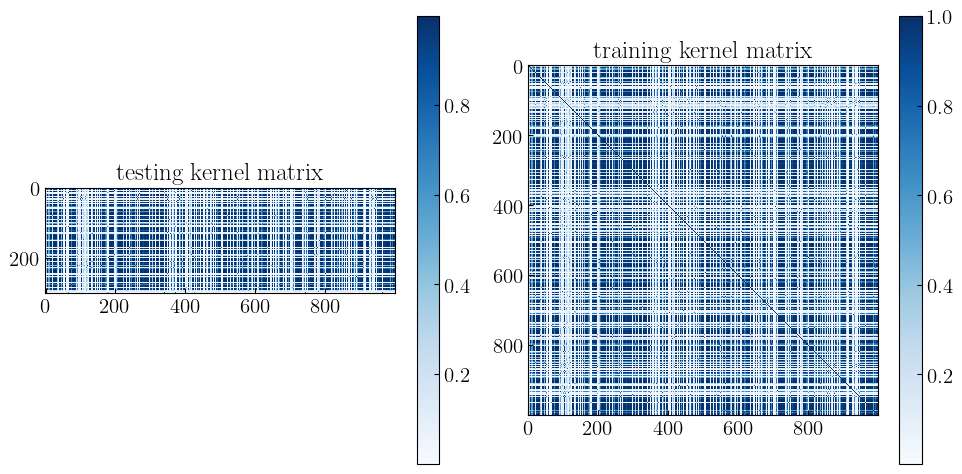

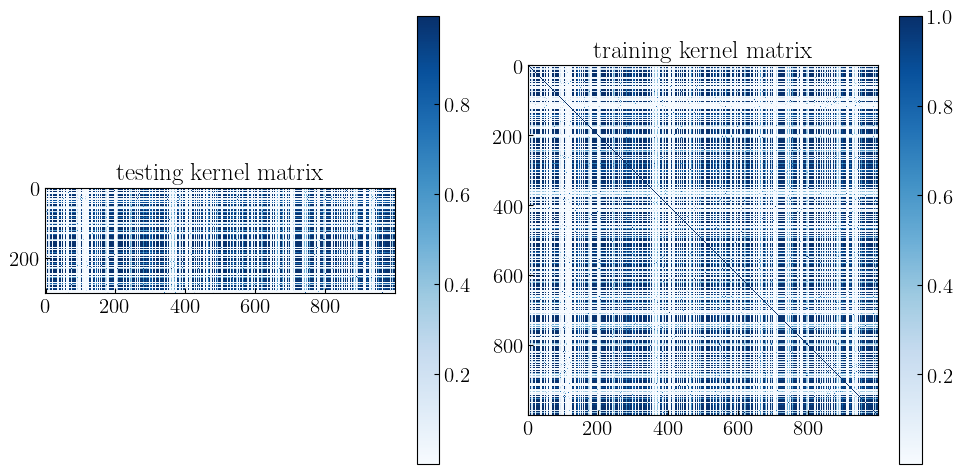

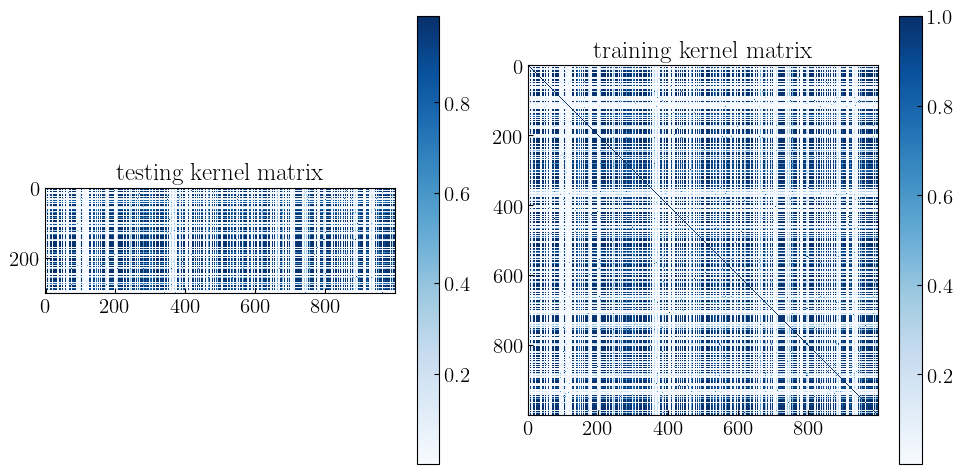

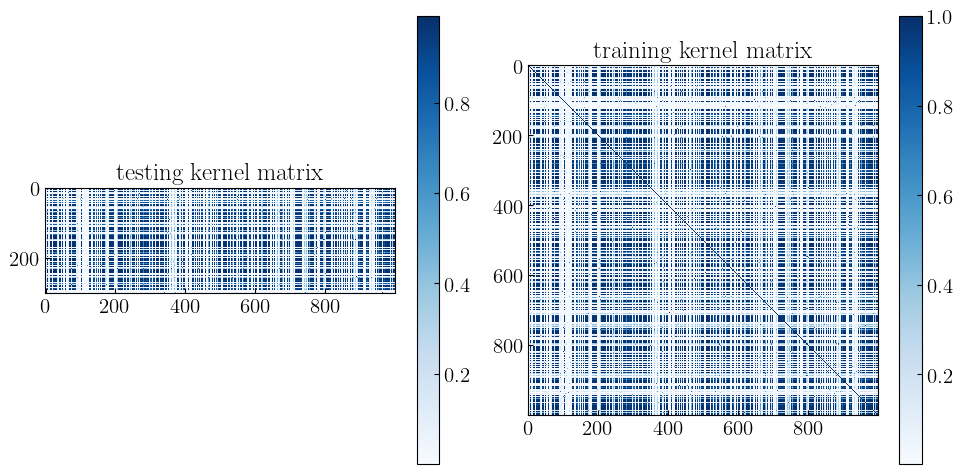

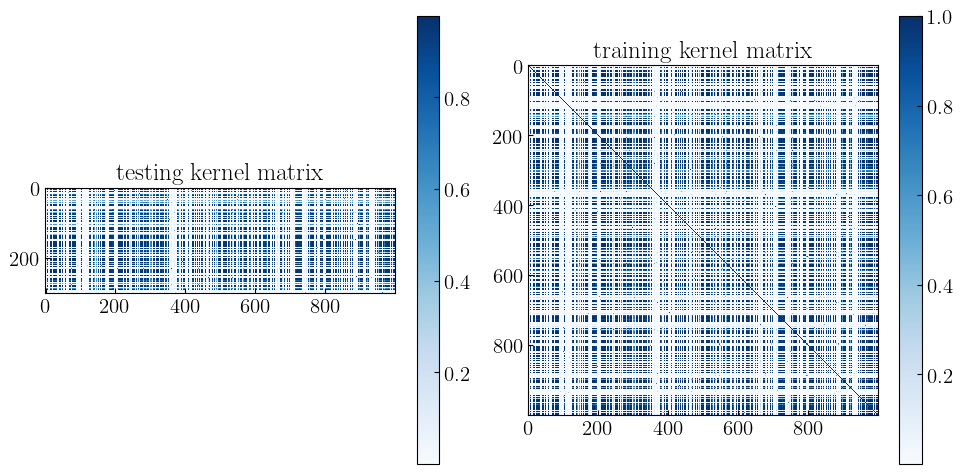

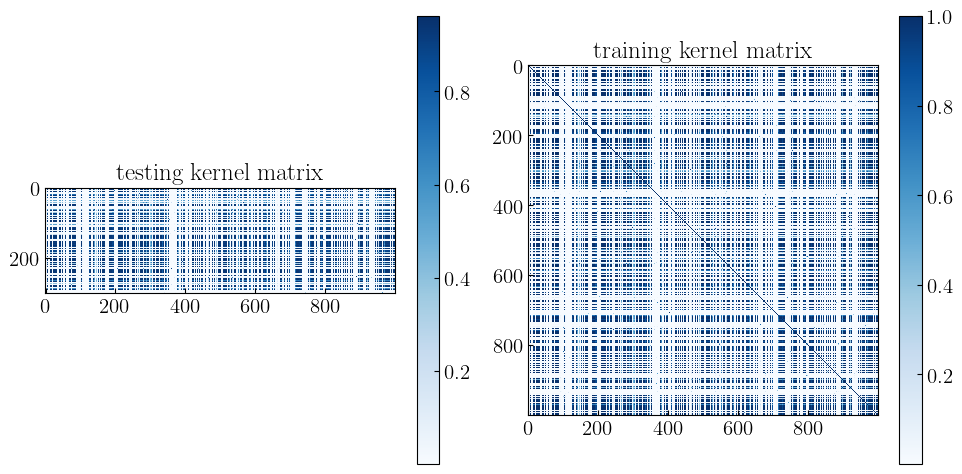

In [42]:
from tabulate import tabulate

V=2
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraX/Non/V{V}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=1

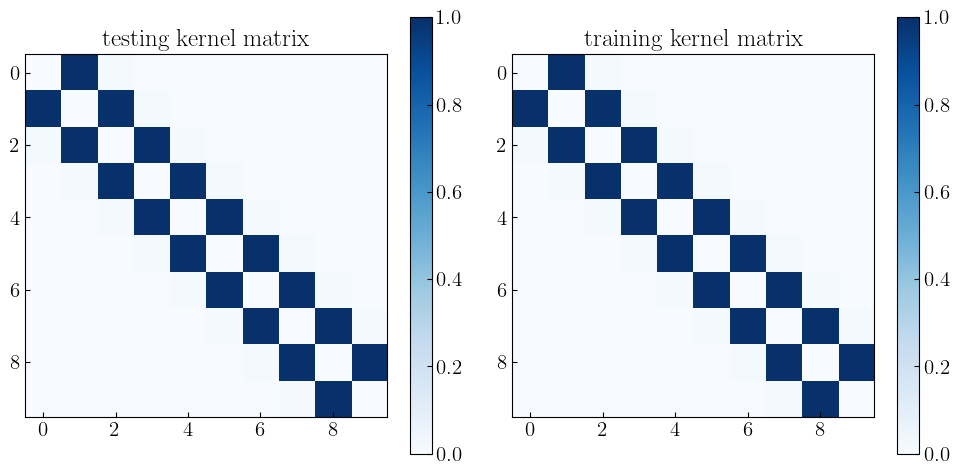

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:2.757285674237152e-06  | train:1.151265530948828e-06  | train:5.607479877344714e-07  |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:5.330147211625128e-07  | train:1.7568826053168766e-07 | train:1.1033848620904786e-07 

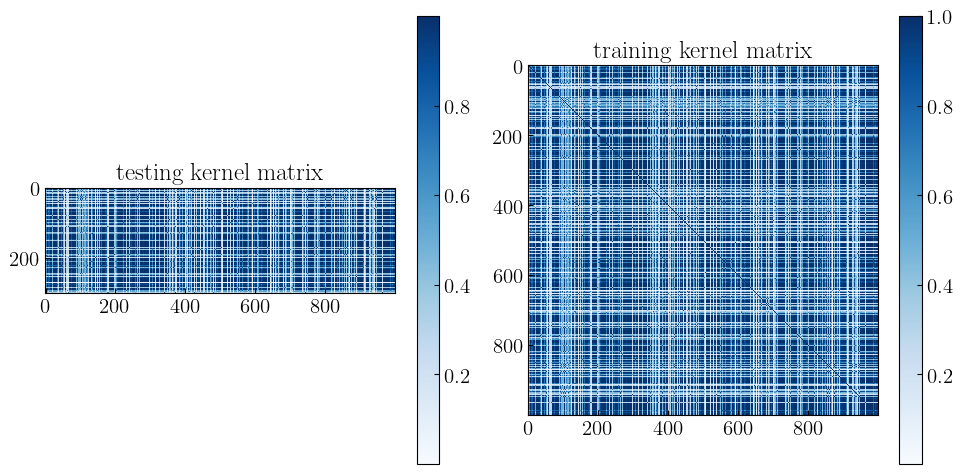

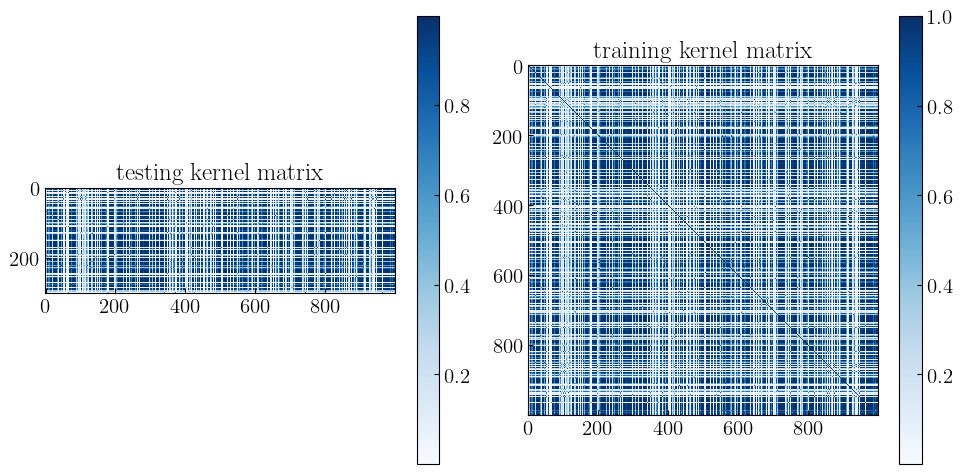

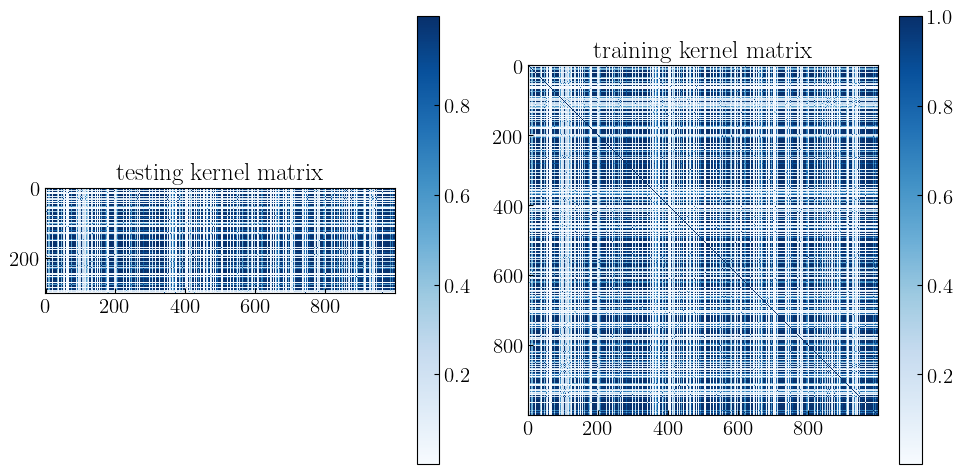

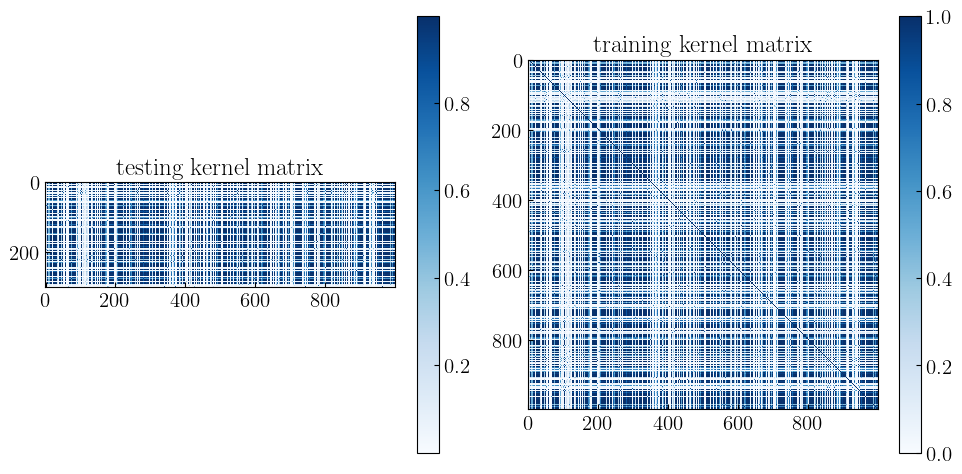

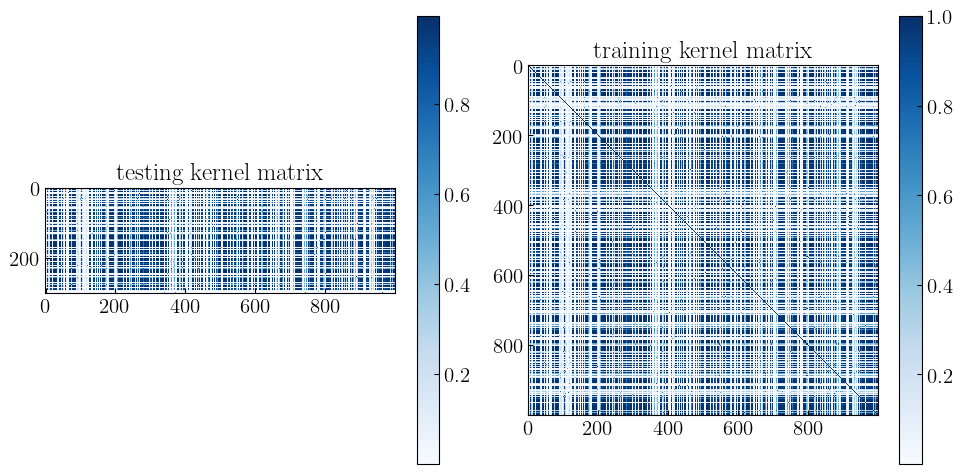

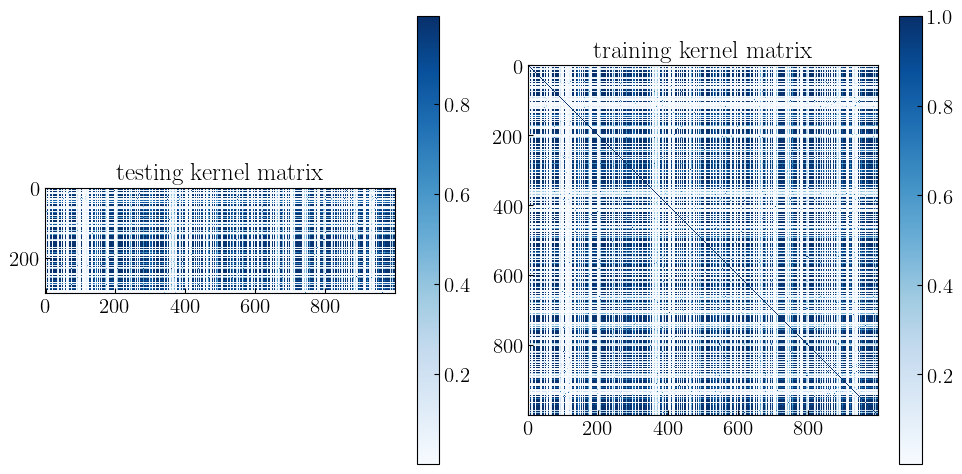

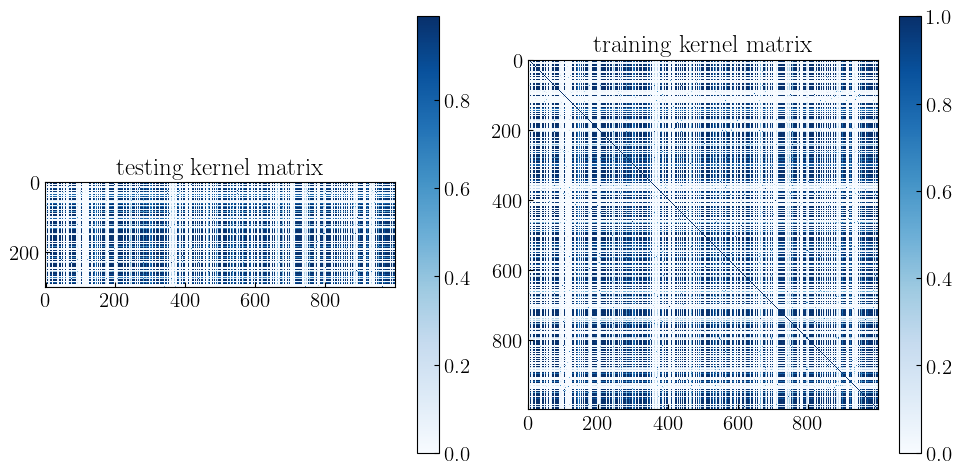

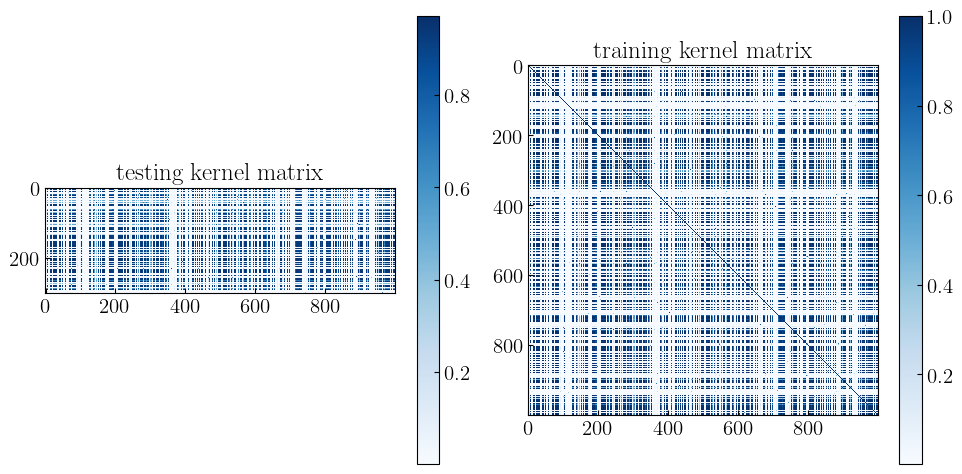

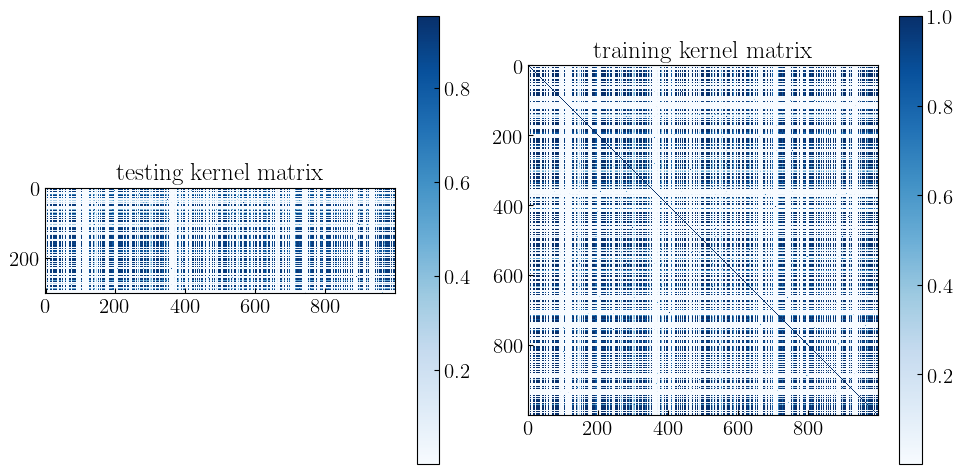

In [43]:
from tabulate import tabulate

V=1
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraX/Non/V{V}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=0.5

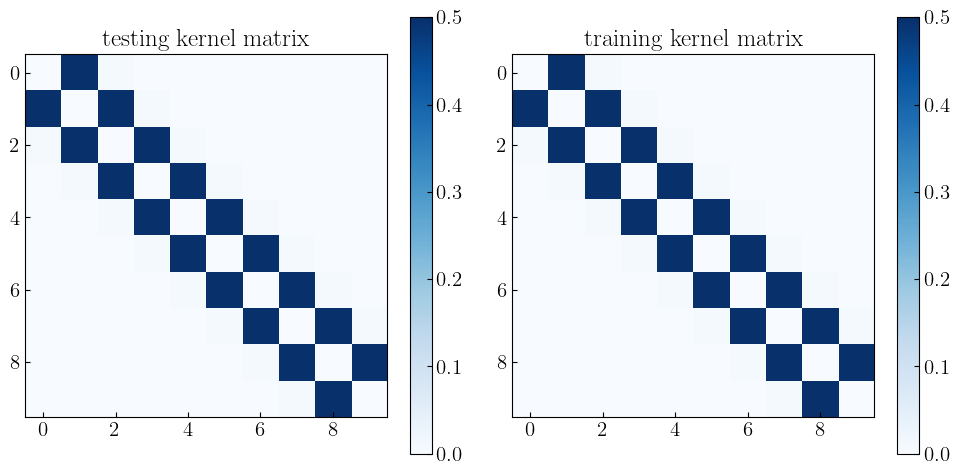

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:2.7870159207028763e-06 | train:5.273508111647493e-07  | train:2.7971330599291333e-07 |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:5.253392462957285e-07  | train:1.2162199288580757e-07 | train:8.959742422436945e-08  

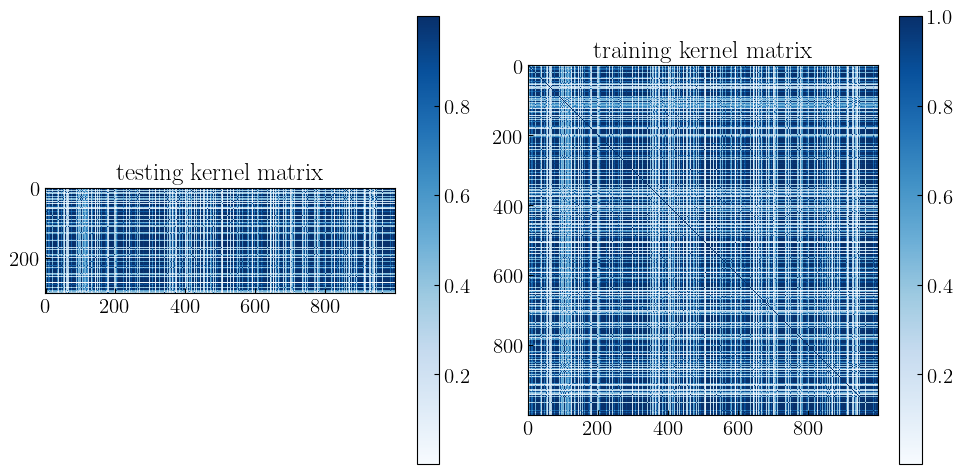

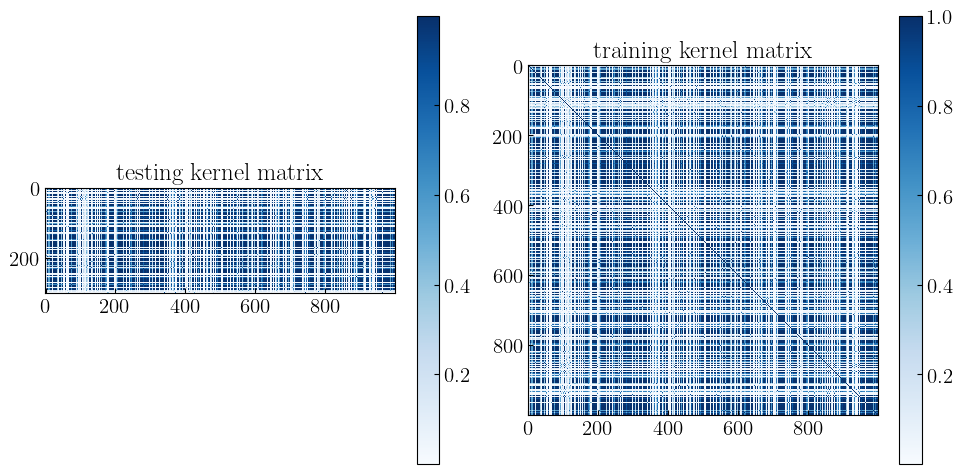

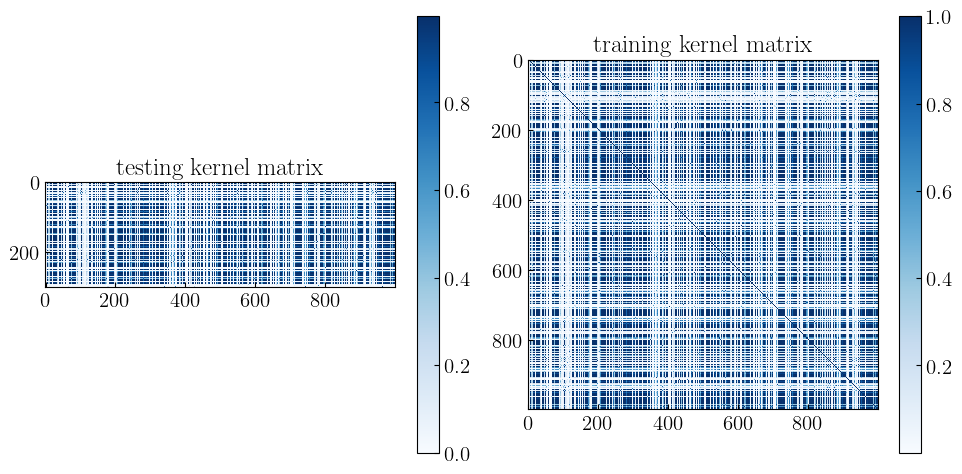

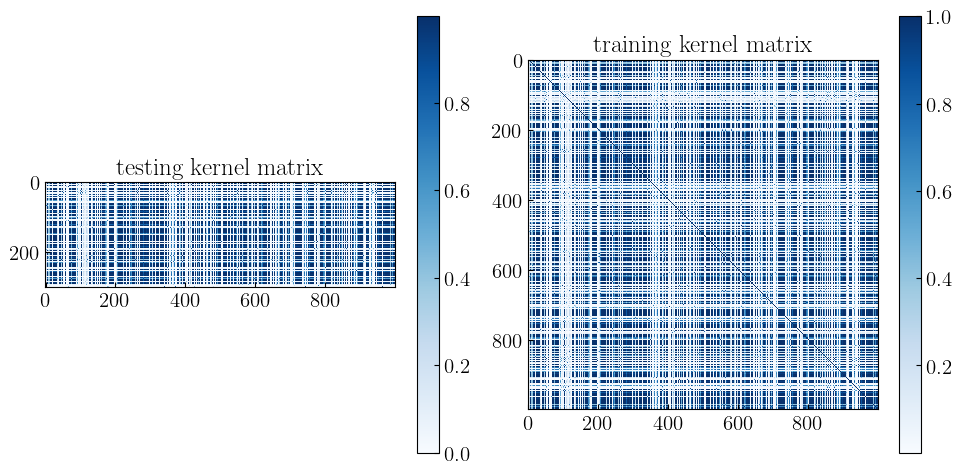

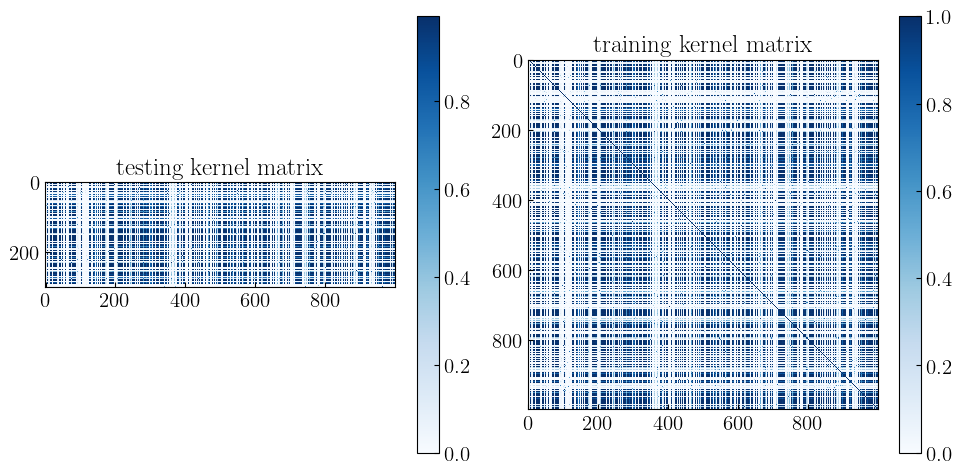

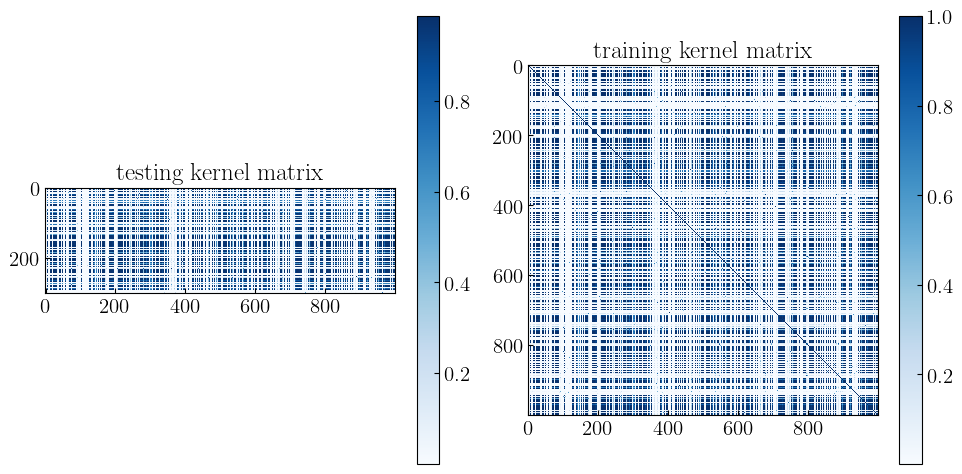

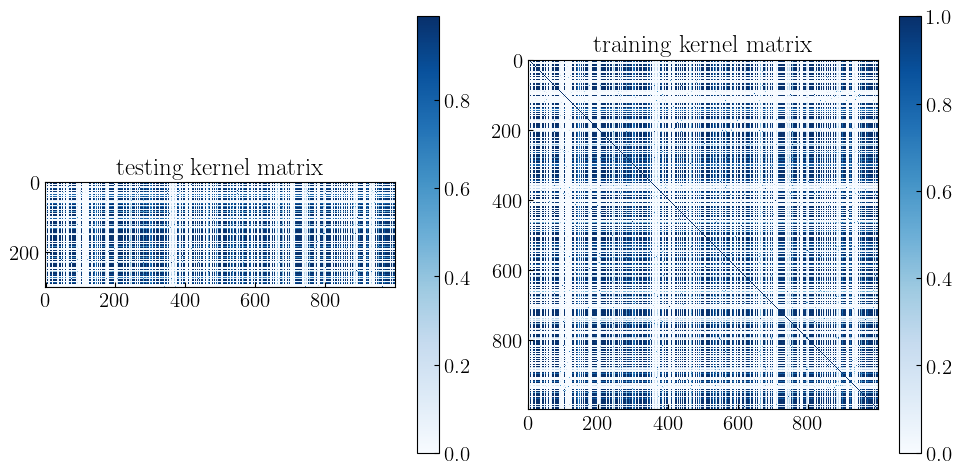

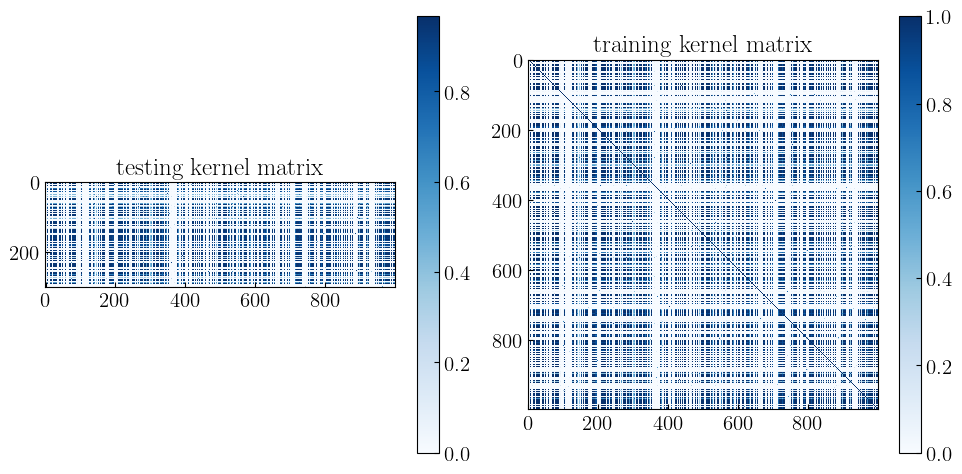

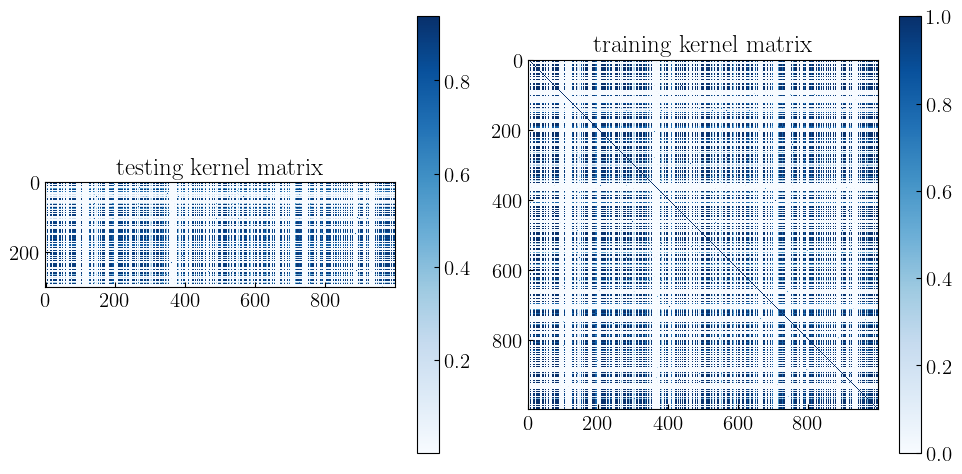

In [47]:
from tabulate import tabulate

V=0.5
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraX/Non/V0{int(V*100)}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## V=0.25

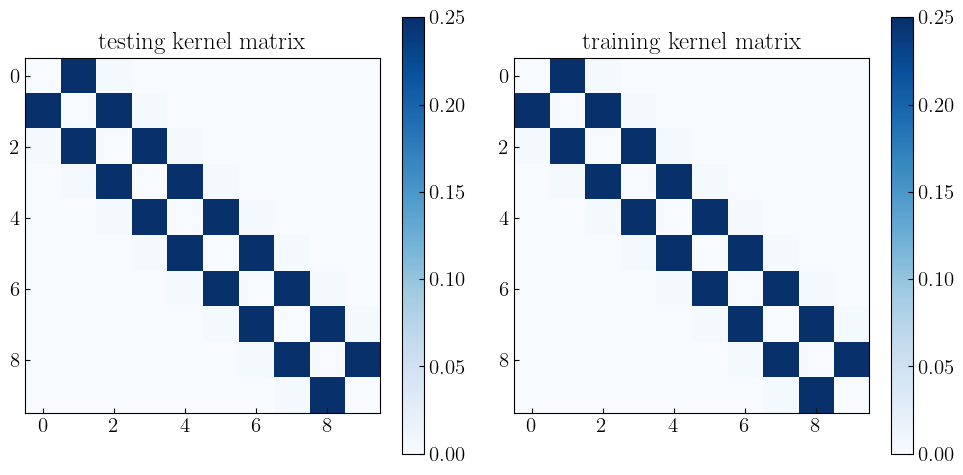

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:2.8006933737404564e-06 | train:5.235445035632142e-07  | train:1.7858177328568015e-07 |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:4.993070018015054e-07  | train:1.1375073781258595e-07 | train:6.498452365126853e-08  

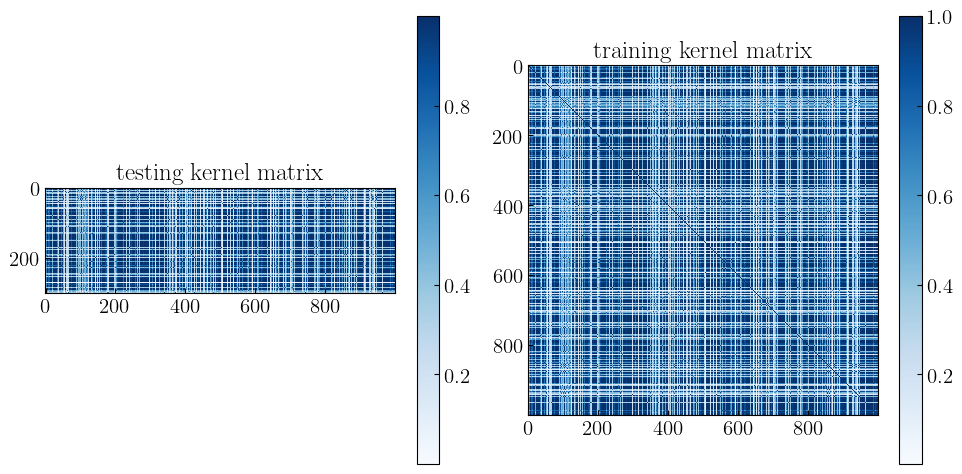

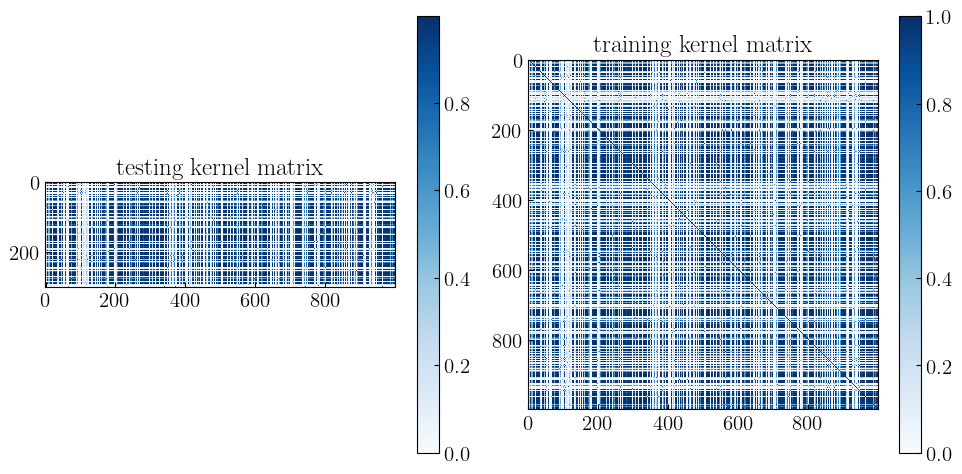

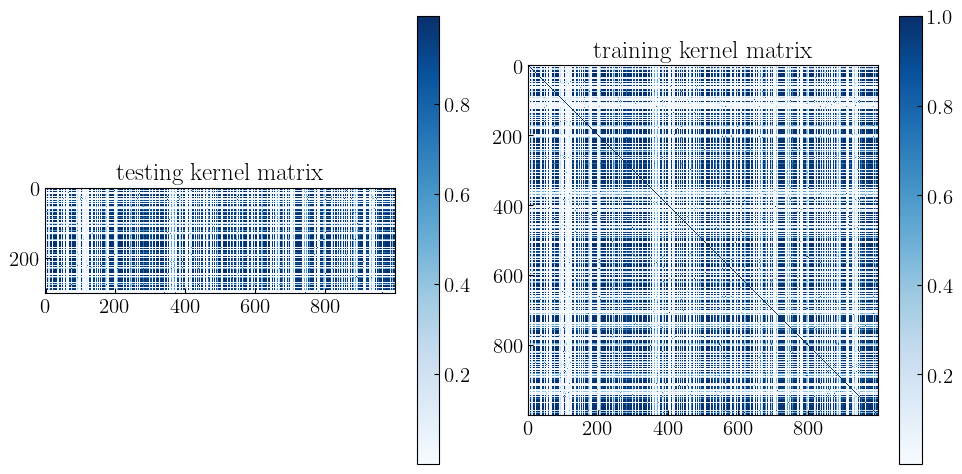

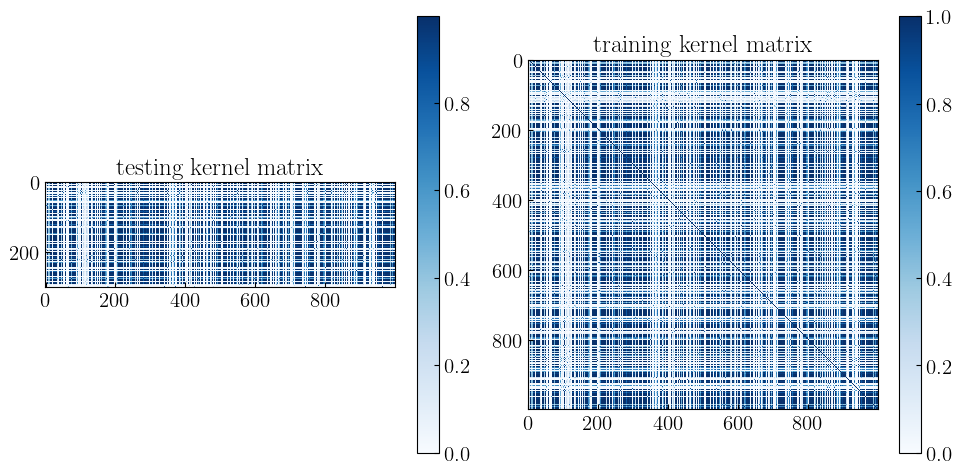

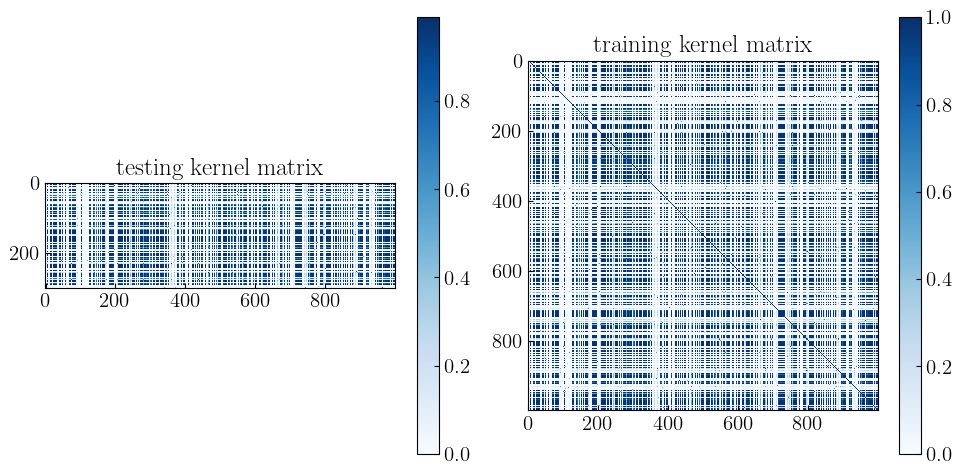

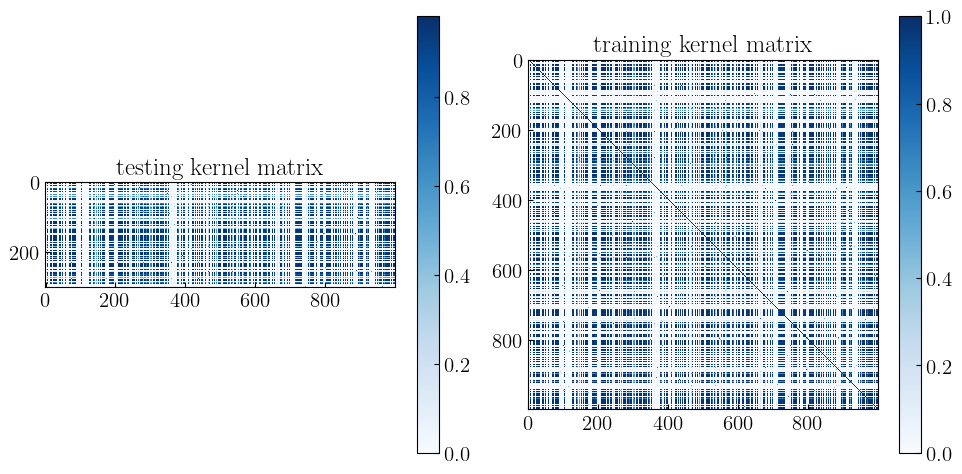

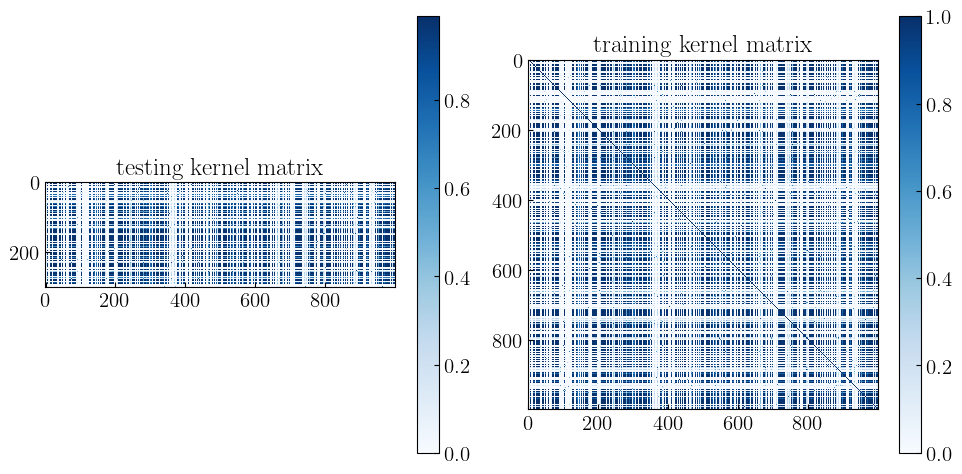

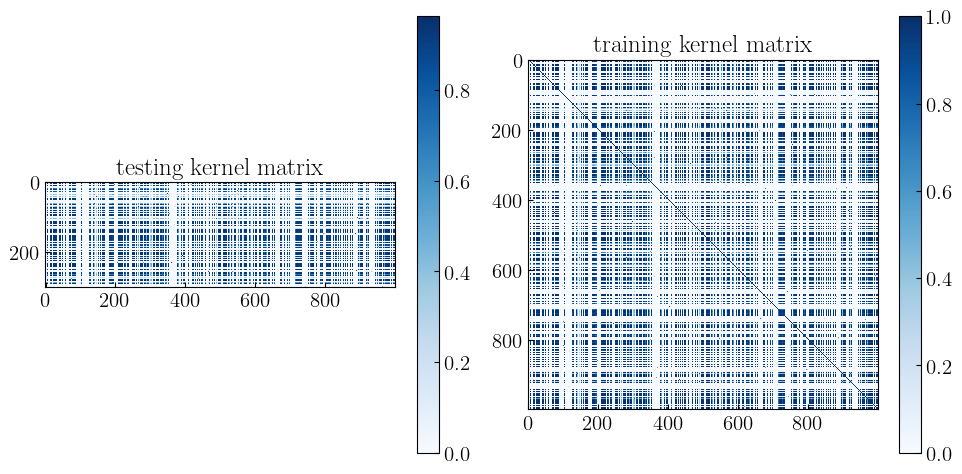

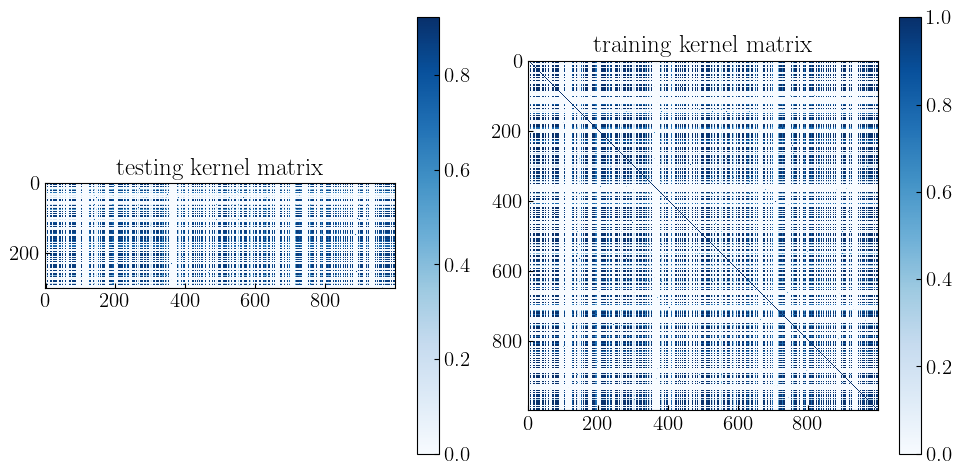

In [48]:
from tabulate import tabulate

V=0.25
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/QueraX/Non/V0{int(V*100)}/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

## Cnot

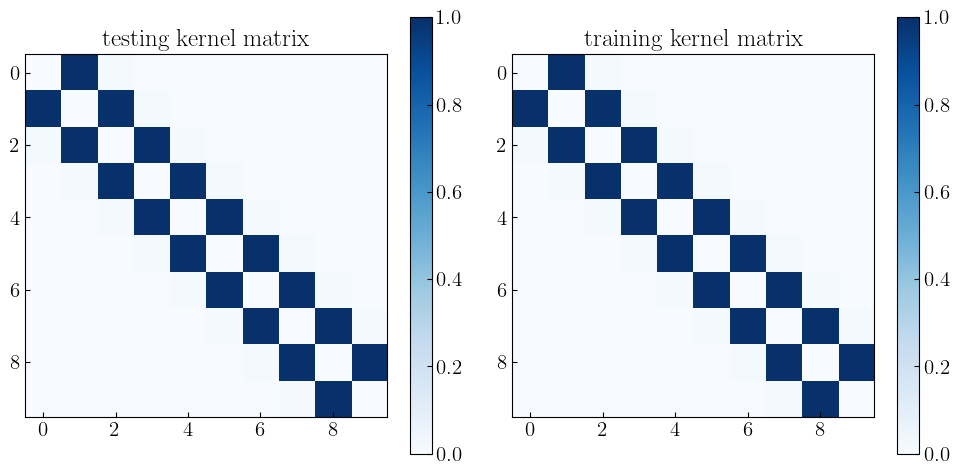

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:2.7950100294859455e-06 | train:1.1718463086597698e-06 | train:4.4820839020236316e-07 |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:5.123950736358278e-07  | train:1.5905242877165935e-07 | train:1.1242130108928477e-07 

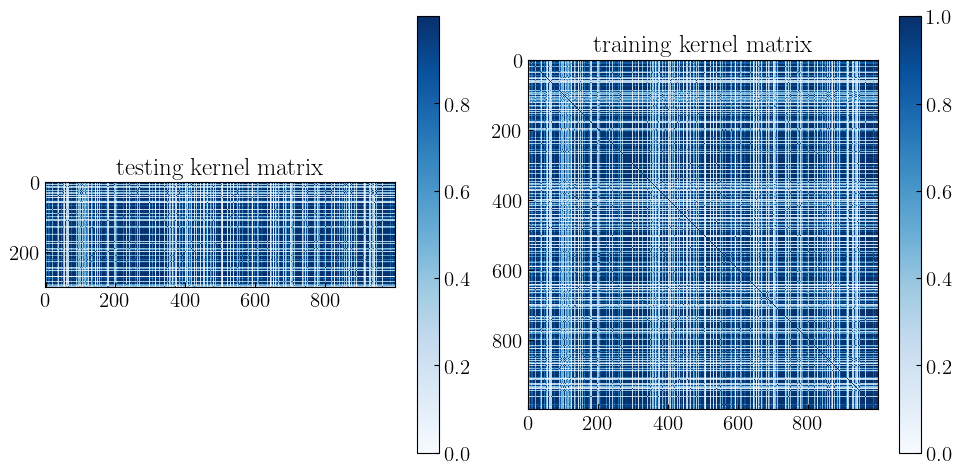

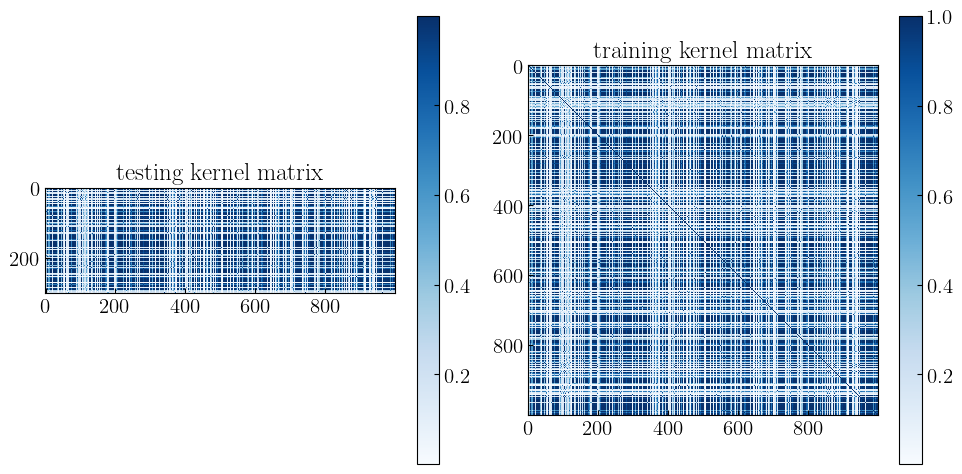

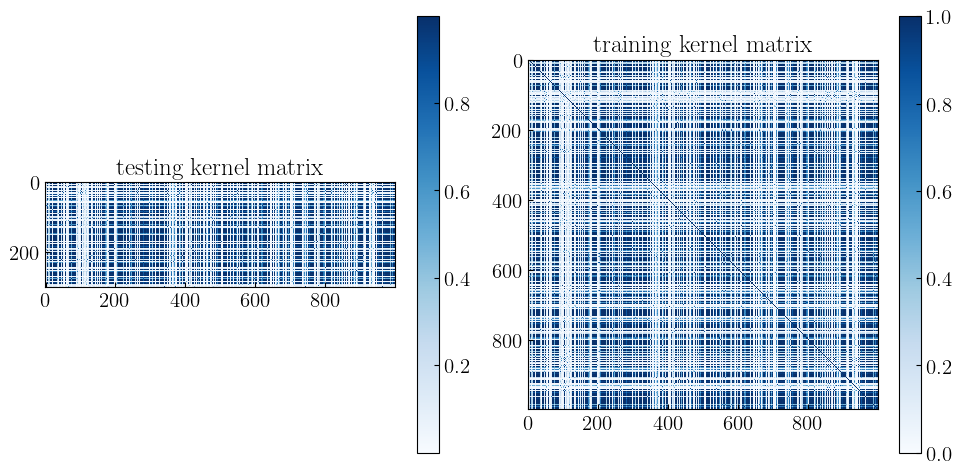

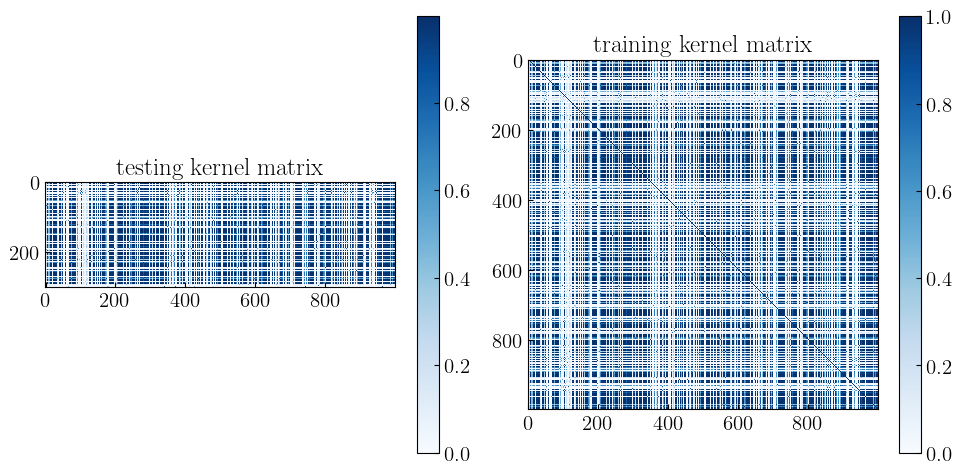

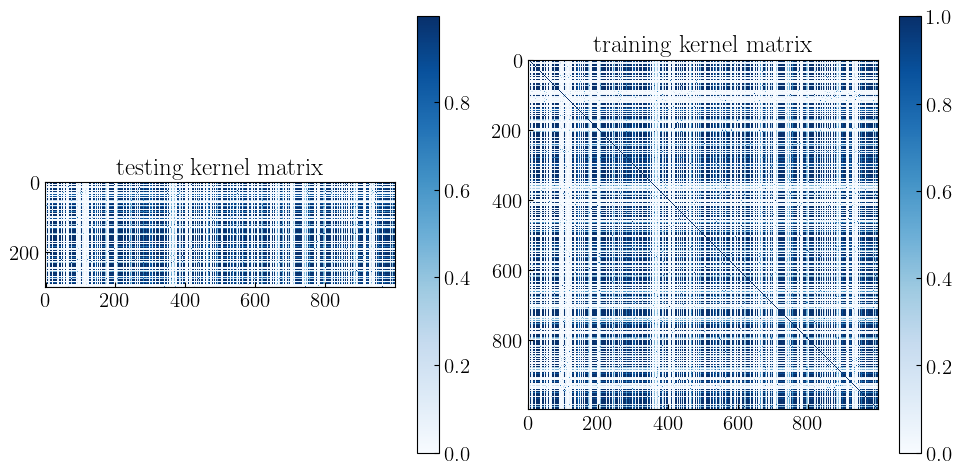

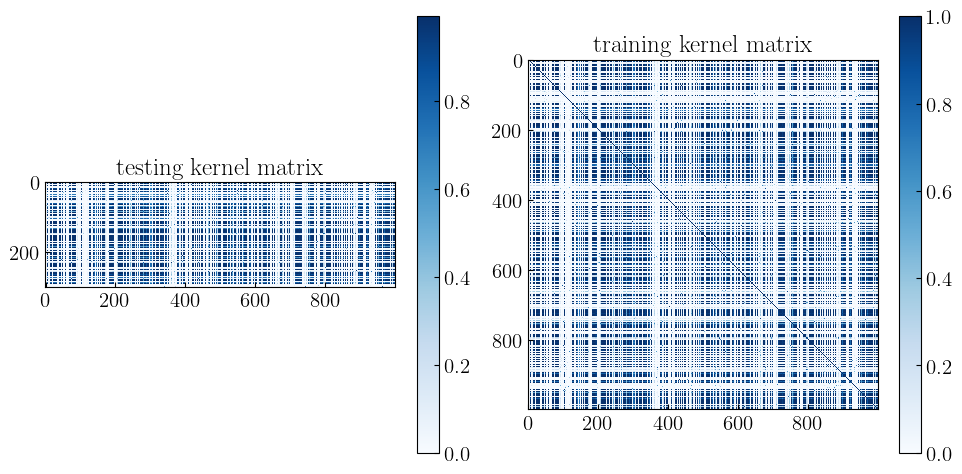

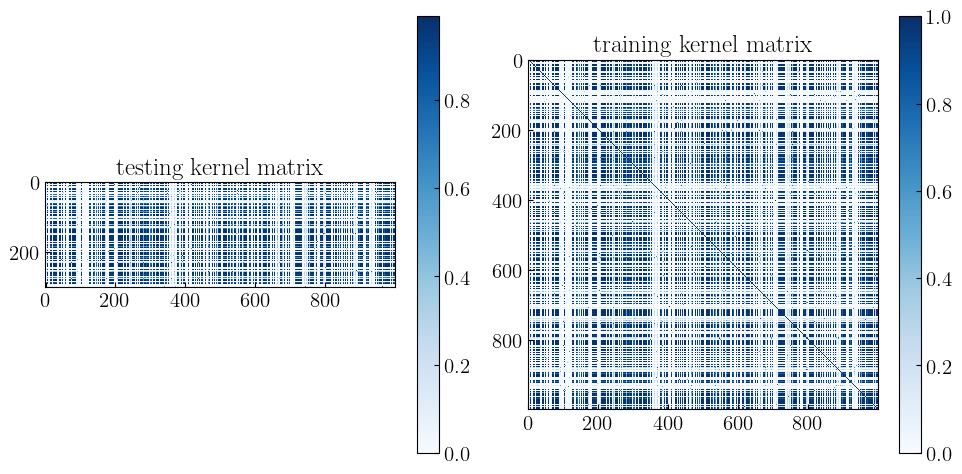

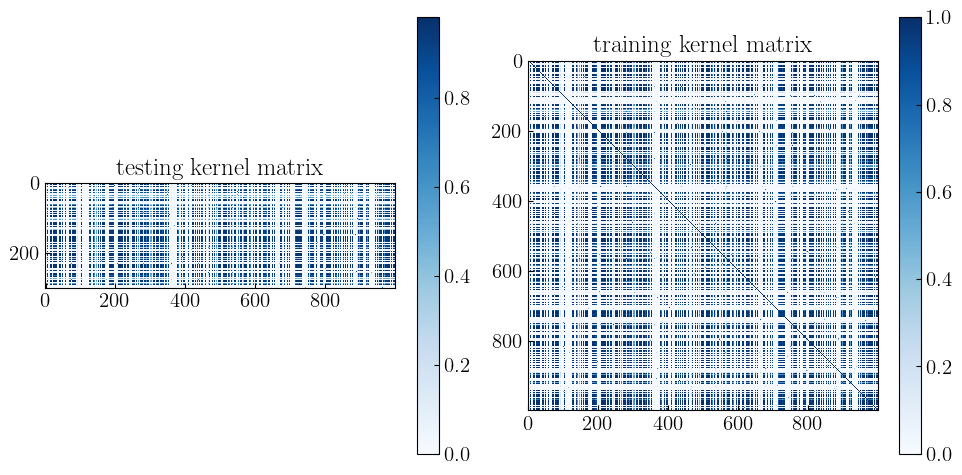

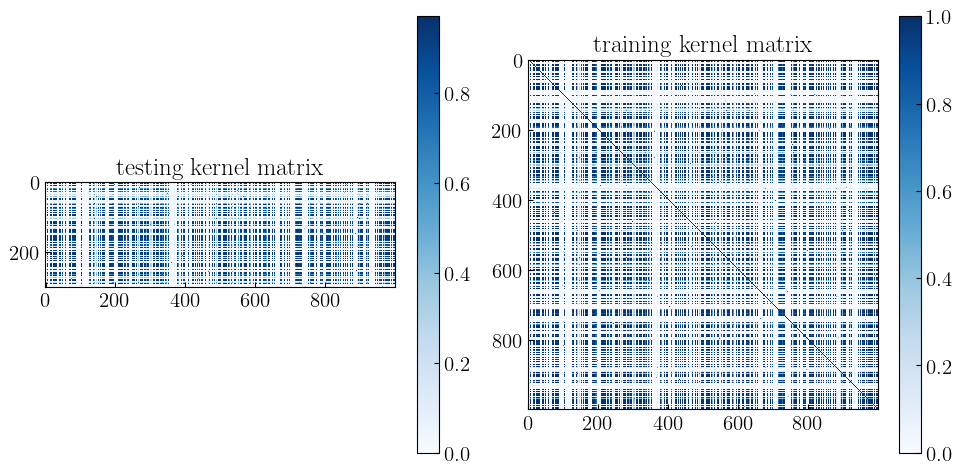

In [241]:
from tabulate import tabulate


op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
mode="cnot"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

  train_pca_q=x_train_lst*Norm
  test_pca_q=x_test_lst*Norm

  for tier in range(3):
    qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
    qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)

    target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
    test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
    name=f"data/Cnot/Non/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
    show_kmatrix(train = target_kernel , test = test_kernel,name = name)

    svr = SVR()
    argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
    svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
    svr.fit(target_kernel, y_train)

    rs_t = svr.predict(test_kernel)
    rs = svr.predict(target_kernel)


    data[i].append(f"train:{mse(rs,y_train)}")
    data_test[i].append(f"test:{mse(rs_t,y_test)}")
    print((i+1)*(tier+1))

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

# IBM

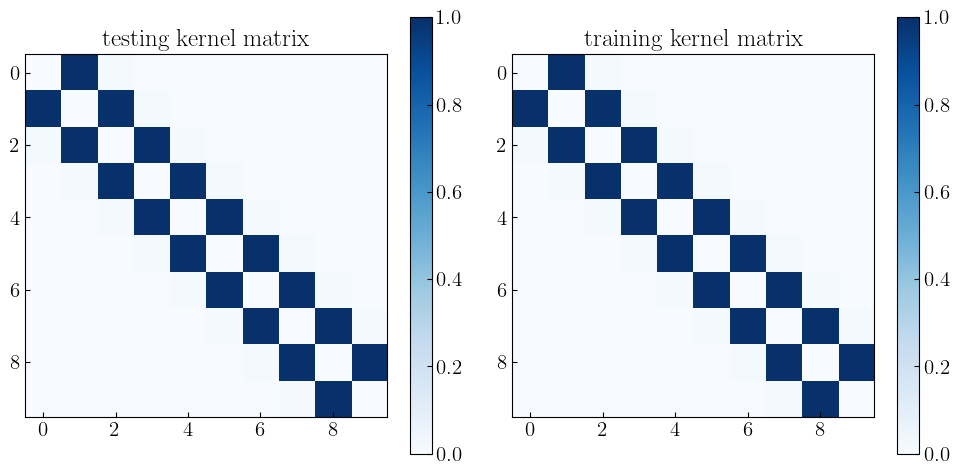

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2


In [ ]:
from tabulate import tabulate

mode="ZZ"
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"],["rbf"]]

Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")


_svr = SVR()
argv = tune(_svr,x_train_lst , y_train , ['rbf'])
_svr = SVR(kernel = mth , epsilon = 0, C=0.7)
_svr.fit(x_train_lst, y_train)
_rs_t = _svr.predict(x_test_lst)
_rs = _svr.predict(x_train_lst)
data[-1].append(f"train:{mse(_rs,y_train)}")
data_test[-1].append(f"test:{mse(_rs_t,y_test)}")

for (i,Norm) in enumerate(Normlist):

    # train_pca_q=[]
    # test_pca_q=[]
    # for j,ll in enumerate(x_train_lst):
    #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)
    
    # for j,ll in enumerate(x_test_lst):
    #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

    train_pca_q=x_train_lst*Norm
    test_pca_q=x_test_lst*Norm

    for tier in range(3):

        qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode)
        qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode)
        
        target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
        test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
        name=f"data/ZZ/Non/qkernel,{headers[0]},Qmap{tier},{data[i][0]}"
        show_kmatrix(train = target_kernel , test = test_kernel,name = name)
        
        svr = SVR()
        argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
        svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
        svr.fit(target_kernel, y_train)
        
        rs_t = svr.predict(test_kernel)
        rs = svr.predict(target_kernel)
        
        
        data[i].append(f"train:{mse(rs,y_train)}")
        data_test[i].append(f"test:{mse(rs_t,y_test)}")
        print((i+1)*(tier+1))
    
table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

In [261]:
print(table1)
print(table2)

+-----------+------------------------------+------------------------------+------------------------------+
| sigmax    | tier=0                       | tier=1                       | tier=2                       |
+===========+==============================+==============================+==============================+
| Norm=05pi | train:1.1197031305880116e-05 | train:5.37093962644814e-06   | train:3.2390378542309335e-06 |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=pi   | train:2.771349748952897e-06  | train:1.1925511747954064e-06 | train:6.832210857265642e-07  |
+-----------+------------------------------+------------------------------+------------------------------+
| Norm=2pi  | train:4.838404025004035e-07  | train:3.190156919422837e-07  | train:1.4508000812842573e-07 |
+-----------+------------------------------+------------------------------+------------------------------+
| rbf       | train:7.586976721152845

# Add experimemtal error 

## Quera X

### V=10

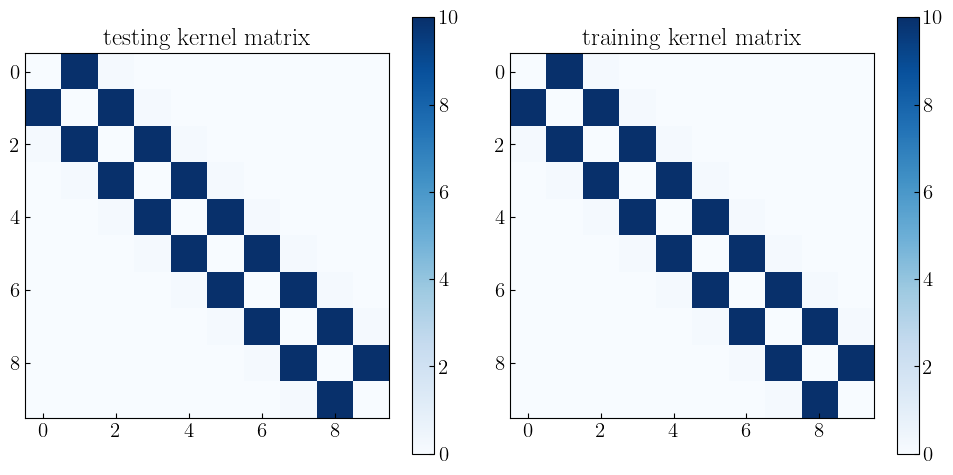

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
cost time: 2105.7575857639313 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 2114.1065249443054 


In [ ]:
from tabulate import tabulate

V=10
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi",[],[],[]],["Norm=pi",[],[],[]]]
data_test = [["Norm=05pi",[],[],[]],["Norm=pi",[],[],[]]]
mode="quera"
Normlist=[math.pi/2,math.pi]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

error=[0.005,0.01,0.1]

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

    train_pca_q=x_train_lst*Norm
    test_pca_q=x_test_lst*Norm
    rbfx_train_lst=x_train_lst*Norm
    rbfx_test_lst=x_test_lst*Norm

    for _ in range(5):
        for tier in range(3):
    
            start_time = time.time()
            qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error=error)
            qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error=error)
            end=time.time()-start_time
            target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
            test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
            
            svr = SVR()
            argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'ts' )
            svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
            svr.fit(target_kernel, y_train)
            
            rs_t = svr.predict(test_kernel)
            rs = svr.predict(target_kernel)
            
            
            data[i][tier+1].append(mse(rs,y_train))
            data_test[i][tier+1].append(mse(rs_t,y_test))
            print((i+1)*(tier+1))
            print(f"cost time: {end} ")

# table1 = tabulate(data, headers, tablefmt="grid")
# table2 = tabulate(data_test, headers, tablefmt="grid")

# print(table1)
# print(table2)

In [364]:
tt_list=["tier0","tier1","tier2"]
store = {}
store['V10'] = {}
store['V10']['train']={}
store['V10']['test']={}
for i in data:
    store['V10']['train'][i[0]]={}
    for (count,j) in enumerate(i[1::]):
        store['V10']['train'][i[0]][tt_list[count]]=j

for i in data_test:
    store['V10']['test'][i[0]]={}
    for (count,j) in enumerate(i[1::]):
        store['V10']['test'][i[0]][tt_list[count]]=j

f = open('NonM_error.json' , "w+")
json.dump(store , f)
f.close()

f = open('NonM_error.json' , "r")
rs = json.load(f)
f.close()
rs

{'V10': {'train': {'Norm=05pi': {'tier0': [4.59594572551679e-06,
     4.3966798136258135e-06,
     4.192042636680914e-06,
     4.709288285787029e-06,
     5.871990347681002e-06],
    'tier1': [1.3221476418015114e-06,
     1.0880974308628344e-06,
     1.238281667382212e-06,
     7.652680609216992e-07,
     1.1288667671943891e-06],
    'tier2': [4.947085801961789e-07,
     4.501761703936967e-07,
     5.614395775289201e-07,
     5.914996146945131e-07,
     5.835487795148685e-07]},
   'Norm=pi': {'tier0': [1.0350380801203095e-06,
     1.7205734849487316e-06,
     1.1741406620448703e-06,
     1.4577979910754347e-06,
     1.2339796766942614e-06],
    'tier1': [2.443052479837932e-07,
     2.3025024051877182e-07,
     2.644381771725827e-07,
     2.2012681090332638e-07,
     3.285088080058385e-07],
    'tier2': [1.0692957544797509e-07,
     1.2659673369011069e-07,
     1.2301108635367547e-07,
     1.2205711684148543e-07,
     1.1041916152214022e-07]}},
  'test': {'Norm=05pi': {'tier0': [6.90592

In [372]:
dataM=[]
dataS=[]
datatestM=[]
datatestS=[]
for i in rs["V10"]['train']:
    for j in rs["V10"]['train'][i]:

            dataM.append(np.mean(rs["V10"]['train'][i][j]))
            dataS.append(np.std(rs["V10"]['train'][i][j]))

for i in rs["V10"]['test']:
    for j in rs["V10"]['test'][i]:

        datatestM.append(np.mean(rs["V10"]['test'][i][j]))
        datatestS.append(np.std(rs["V10"]['test'][i][j]))

In [315]:
Noerror10=[1.0750345178979298e-05 ,6.24707003924759e-06   ,4.167087176717489e-06 
,4.700709113340248e-06  ,5.858824691849418e-06  ,9.771686307317997e-06]

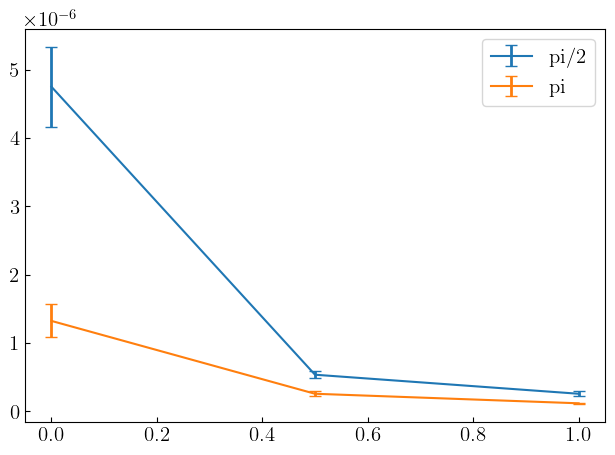

In [374]:

plt.errorbar(np.linspace(0,1,3) ,dataM[::2] , yerr = dataS[::2],label= "pi/2",elinewidth=2,capsize=4)
plt.errorbar(np.linspace(0,1,3) ,dataM[3:6] , yerr = dataS[3:6],label="pi",elinewidth=2,capsize=4)

plt.legend()

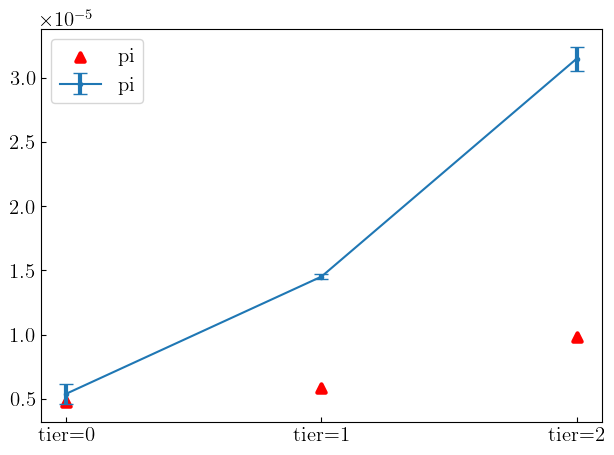

In [375]:


# plt.errorbar(np.linspace(0,2,3) ,datatestM[::2] , yerr = datatestS[0:3],label= "pi/2",elinewidth=2,capsize=4,fmt=".",ls="-")
plt.errorbar(np.linspace(0,2,3) ,datatestM[3:6] , yerr = datatestS[3:6],label="pi",elinewidth=3,capsize=5,fmt=".",ls="-")

# plt.scatter(np.linspace(0,2,3) ,Noerror10[::2],label= "pi/2" ,lw=3,marker="x",color="red")
plt.scatter(np.linspace(0,2,3) ,Noerror10[3:6] ,label= "pi",lw=3,marker="^",color="red")

# plt.yscale("log")
plt.xticks([0,1,2],["tier=0","tier=1","tier=2"])
plt.legend()

### V=5

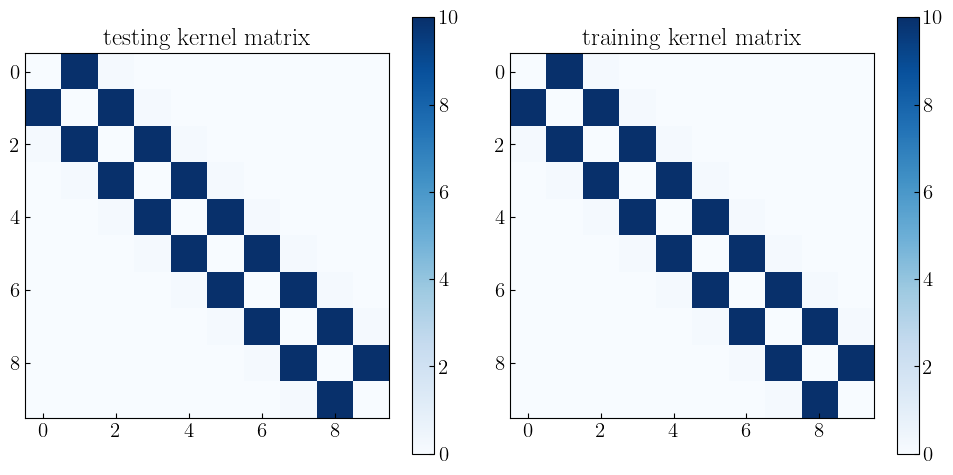

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
cost time: 14.605967998504639 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 22.148837089538574 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
cost time: 23.056154012680054 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 15.111255407333374 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
cost time: 18.557899475097656 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
cost time: 22.631770849227905 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
cost time: 15.35249662399292 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
cost time: 21.786532640457153 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
cost time: 21.88619303703308 
+-----------+-----------------------------+-----------------------------+------------------------------+-----------------------------+
| sigmax    | tier=0                      | tier=1                      | tier=2                       | rbf                         |
+===========+=============================+=============================+====================

In [140]:
from tabulate import tabulate

V=5
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

error=[0.05,0.05,0.05]

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

    train_pca_q=x_train_lst*Norm
    test_pca_q=x_test_lst*Norm
    x_train_lst=x_train_lst*Norm
    x_test_lst=x_test_lst*Norm


    for tier in range(3):

        start_time = time.time()
        qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error)
        qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error)
        end=time.time()-start_time
        target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
        test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
        
        svr = SVR()
        argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
        svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
        svr.fit(target_kernel, y_train)
        
        rs_t = svr.predict(test_kernel)
        rs = svr.predict(target_kernel)
        
        
        data[i].append(f"train:{mse(rs,y_train)}")
        data_test[i].append(f"test:{mse(rs_t,y_test)}")
        print((i+1)*(tier+1))
        print(f"cost time: {end} ")
    _svr = SVR()
    argv = tune(_svr,x_train_lst , y_train , ['rbf'])
    _svr = SVR(kernel = mth , epsilon = 0, C=0.7)
    _svr.fit(x_train_lst, y_train)
    _rs_t = _svr.predict(x_test_lst)
    _rs = _svr.predict(x_train_lst)
    data[i].append(f"train:{mse(_rs,y_train)}")
    data_test[i].append(f"test:{mse(_rs_t,y_test)}")

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

In [ ]:
print(table1)
print(table2)

### V=2

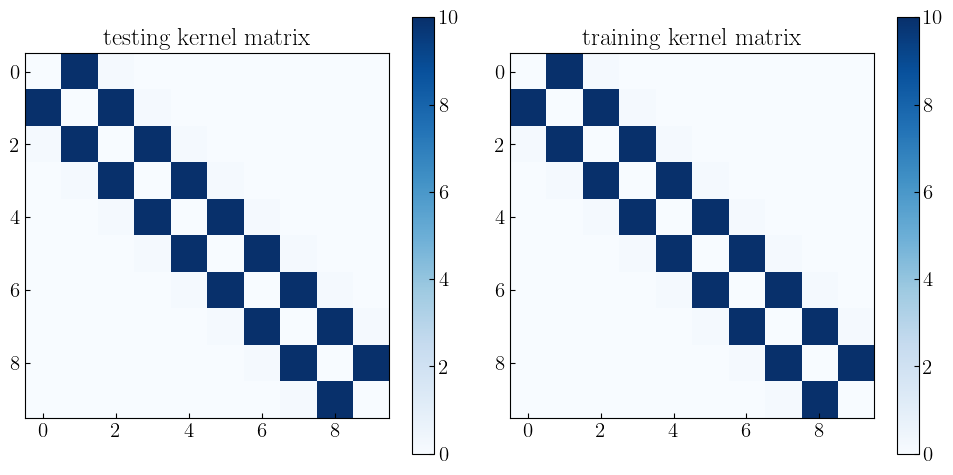

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
cost time: 14.605967998504639 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 22.148837089538574 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
cost time: 23.056154012680054 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 15.111255407333374 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
cost time: 18.557899475097656 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
cost time: 22.631770849227905 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
cost time: 15.35249662399292 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
cost time: 21.786532640457153 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
cost time: 21.88619303703308 
+-----------+-----------------------------+-----------------------------+------------------------------+-----------------------------+
| sigmax    | tier=0                      | tier=1                      | tier=2                       | rbf                         |
+===========+=============================+=============================+====================

In [140]:
from tabulate import tabulate

V=2
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

error=[0.05,0.05,0.05]

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

    train_pca_q=x_train_lst*Norm
    test_pca_q=x_test_lst*Norm
    x_train_lst=x_train_lst*Norm
    x_test_lst=x_test_lst*Norm


    for tier in range(3):

        start_time = time.time()
        qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error)
        qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error)
        end=time.time()-start_time
        target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
        test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
        
        svr = SVR()
        argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
        svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
        svr.fit(target_kernel, y_train)
        
        rs_t = svr.predict(test_kernel)
        rs = svr.predict(target_kernel)
        
        
        data[i].append(f"train:{mse(rs,y_train)}")
        data_test[i].append(f"test:{mse(rs_t,y_test)}")
        print((i+1)*(tier+1))
        print(f"cost time: {end} ")
    _svr = SVR()
    argv = tune(_svr,x_train_lst , y_train , ['rbf'])
    _svr = SVR(kernel = mth , epsilon = 0, C=0.7)
    _svr.fit(x_train_lst, y_train)
    _rs_t = _svr.predict(x_test_lst)
    _rs = _svr.predict(x_train_lst)
    data[i].append(f"train:{mse(_rs,y_train)}")
    data_test[i].append(f"test:{mse(_rs_t,y_test)}")

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

In [ ]:
print(table1)
print(table2)

### V=1

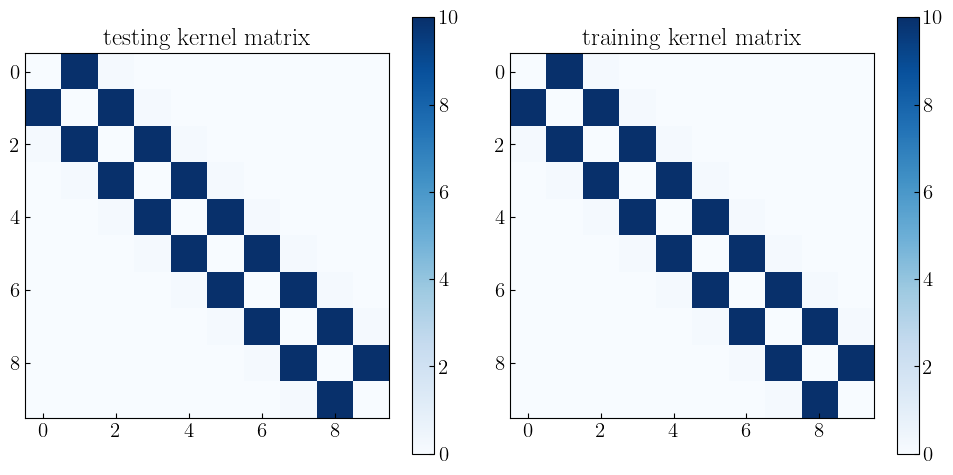

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
1
cost time: 14.605967998504639 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 22.148837089538574 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
cost time: 23.056154012680054 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
2
cost time: 15.111255407333374 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
4
cost time: 18.557899475097656 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
cost time: 22.631770849227905 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
3
cost time: 15.35249662399292 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
6
cost time: 21.786532640457153 
[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9]
9
cost time: 21.88619303703308 
+-----------+-----------------------------+-----------------------------+------------------------------+-----------------------------+
| sigmax    | tier=0                      | tier=1                      | tier=2                       | rbf                         |
+===========+=============================+=============================+====================

In [140]:
from tabulate import tabulate

V=1
op="x"
headers = ["sigmax","tier=0", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
data_test = [["Norm=05pi"],["Norm=pi"],["Norm=2pi"]]
mode="quera"
Normlist=[math.pi/2,math.pi,math.pi*2]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

error=[0.05,0.05,0.05]

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

    train_pca_q=x_train_lst*Norm
    test_pca_q=x_test_lst*Norm
    x_train_lst=x_train_lst*Norm
    x_test_lst=x_test_lst*Norm


    for tier in range(3):

        start_time = time.time()
        qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error)
        qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error)
        end=time.time()-start_time
        target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
        test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
        
        svr = SVR()
        argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'tr' )
        svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
        svr.fit(target_kernel, y_train)
        
        rs_t = svr.predict(test_kernel)
        rs = svr.predict(target_kernel)
        
        
        data[i].append(f"train:{mse(rs,y_train)}")
        data_test[i].append(f"test:{mse(rs_t,y_test)}")
        print((i+1)*(tier+1))
        print(f"cost time: {end} ")
    _svr = SVR()
    argv = tune(_svr,x_train_lst , y_train , ['rbf'])
    _svr = SVR(kernel = mth , epsilon = 0, C=0.7)
    _svr.fit(x_train_lst, y_train)
    _rs_t = _svr.predict(x_test_lst)
    _rs = _svr.predict(x_train_lst)
    data[i].append(f"train:{mse(_rs,y_train)}")
    data_test[i].append(f"test:{mse(_rs_t,y_test)}")

table1 = tabulate(data, headers, tablefmt="grid")
table2 = tabulate(data_test, headers, tablefmt="grid")

print(table1)
print(table2)

In [ ]:
print(table1)
print(table2)

## Cnot

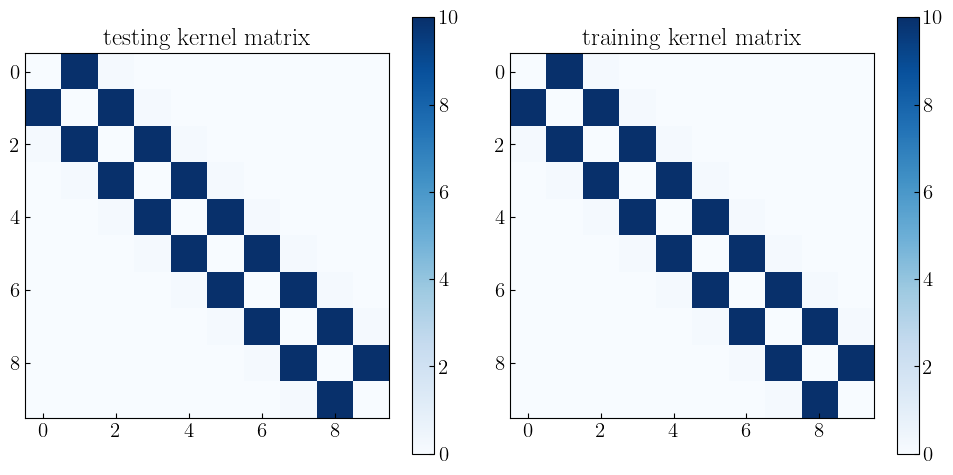


KeyboardInterrupt



In [537]:
from tabulate import tabulate

V=10
op="x"
headers = ["sigmax", "tier=1" ,"tier=2","rbf"]
data = [["Norm=05pi",[],[],[]],["Norm=pi",[],[],[]]]
data_test = [["Norm=05pi",[],[],[]],["Norm=pi",[],[],[]]]
mode="cnot"
Normlist=[math.pi/2,math.pi]
imax=0
imin=0

# for ll in x_train_lst:
#   imax=max(imax,max(ll))
#   imin=min(imin,min(ll))
# print("imax=",imax)
# print("imin=",imin)

dim = k
left_gst = gst(dim).dag()
right_gst = gst(dim)
Roby=1
t = np.pi*1

config = np.ones([dim ,dim])
for idx , cf in enumerate(config) :
  for idy , c in enumerate(cf) :
    if idx == idy:
      config[idx][idy] = 0
    else:
      config[idx][idy]=V*abs(idx-idy)**-6
show_kmatrix(train = config , test = config,name = "")

error=[0.005,0.01,0.1]

for (i,Norm) in enumerate(Normlist):

  # train_pca_q=[]
  # test_pca_q=[]
  # for j,ll in enumerate(x_train_lst):
  #   train_pca_q.append(x_train_lst[j]/max(imax,abs(imin))*Norm)

  # for j,ll in enumerate(x_test_lst):
  #   test_pca_q.append(x_test_lst[j]/max(imax,abs(imin))*Norm)

    train_pca_q=x_train_lst*Norm
    test_pca_q=x_test_lst*Norm
    rbfx_train_lst=x_train_lst*Norm
    rbfx_test_lst=x_test_lst*Norm

    for _ in range(1):
        for tier in range(1,3):
    
            start_time = time.time()
            qx_train_lst = Qmap(config , dim ,t ,train_pca_q, Roby,op, tier,mode=mode,error=error)
            qx_test_lst = Qmap(config , dim ,t ,test_pca_q, Roby,op, tier,mode=mode,error=error)
            end=time.time()-start_time
            target_kernel = get_q_kernel(qx_train_lst,qx_train_lst)
            test_kernel = get_q_kernel(qx_test_lst,qx_train_lst , status = "test")
            
            svr = SVR()
            argv = _tune(svr,np.array(target_kernel) , y_train ,np.array(test_kernel) , y_test, ['precomputed'] , tg = 'ts' )
            svr = SVR(kernel = argv['kernel'] , epsilon = argv['epsilon'] , C = argv['C'])
            svr.fit(target_kernel, y_train)
            
            rs_t = svr.predict(test_kernel)
            rs = svr.predict(target_kernel)
            
            
            data[i][tier+1].append(mse(rs,y_train))
            data_test[i][tier+1].append(mse(rs_t,y_test))
            print((i+1)*(tier+1))
            print(f"cost time: {end} ")
